# Hintergrund und Problemstellung
    
Herzlich Willkommen in unserem Notebook!
Um Ihnen klarzumachen, weshalb im folgenden Programm der Aufwand betrieben wird, etliche Daten zu extrahieren und zu analysieren, bieten wir in diesem Dokumentationsblock die Möglichkeit, sich über den Hintergrund unseres Projektes und der Problemstellung, welche wir lösen wollen, zu informieren.
Wir − Marco Reichart und Christian Engelhard − wurden vor einiger Zeit von der Hagenah GmbH kontaktiert. Dieses Unternehmen besitzt den Radiosender Soprano Beats. Um eine höhere Zielgruppe an Zuhörern zu erreichern, setzt sich der Sender das Ziel, von nun an auch Deutschrap-Songs zu spielen. Da diese unter den jüngeren Altersgruppen sich immer größerer Beliebheit erfreuen, wie in der folgenden Abbildung zu sehen ist [[1](#Literatur-und-Links)].
![Beliebheit%20Rap%20Statistik](resources/Beliebheit%20Rap%20Statistik.png)
   
Es stellt sich jedoch die Frage, welche Kriterien benötigt ein Song, um als jugendfrei zu gelten. Hierbei möchte sich der Radiosender Soprano Beats an der Musikstreaming-Plattform Spotify orientieren, welche zwischen nicht jugendfreien (expliziten) und jugendfreien (impliziten) Liedern differenziert [[2](#Literatur-und-Links)]. Bei den etlichen Songs, die auf Spotify zu hören sind, zählt ein gewisser Teil zu Songs, die einen anstößigen Songtext beinhalten, der nicht unbedingt jugendfrei ist. Häufig beinhalten derartige Lieder beispielsweise Inhalte von Gewalt oder vulgäre Ausdrücke. Damit Nutzer vor diesen Songs gewarnt sind, wird neben dem Titel des Songs der Zusatz „Explicit“ für „nicht jugendfrei“ angezeigt. Auf diese Weise kann sich Spotify rechtlich schützen und auch anstößige respektive nicht jugendfreie Musik zum Streamen bereitstellen.
    
Anders als Spotify möchte Soprano Beats ausschließlich Deutschrap-Lieder spielen, die jugendfrei sind. Aus diesem Grund hat der Manager von Soprano Beats unser Team beauftragt, den Text sämtlicher Deutschrap-Lieder zu analysieren und weitergehend eine Klassifikation zu finden, die als Ergebnis liefert, ob es sich beim jeweiligen Lied um einen jugendfreien oder nicht jugendfreien Text handelt.

Zur Realisierung der im Auftrag des Radiosenders gestellten Ziele wurde die folgende Vorgehensweise bestimmt:
1. Im ersten Schritt sollen vor allem die Texte und weitere Meta-Informationen der Deutschrap-Lieder extrahiert und für spätere Analysen aufbereitet werden.
2. Um sich ein Bild über die nun erlangten Daten zu machen und den Text der Lieder auf statistischer Ebene besser kennenzulernen, wurde sich im weiteren Verlauf der explorativen Datenanalyse gewidmet.
3. Gegenstand des dritten Schritts soll es sein, mit Hilfe maschinellen Lernens eine Klassifikation vorzunehmen. Dieser Teil unseres Projekt stellt das Herzstück des Auftrags dar, da es die Unterscheidung zwischen impliziten und expliziten Deutschrap-Liedern ermöglicht.
4. Zu guter Letzt sollen die Ergebnisse zusammengefasst und evaluiert werden. Dabei soll die Fragestellung des Radiosenders Soprano Beats beantwortet werden und der Auftrag seinen Abschluss finden.

#  Datenextraktion und Aufbereitung

Das Ziel dieses Kapitels ist die vollständige Extraktion einer möglichst großen Anzahl an Deutschrap-Liedern. Die Extraktion der Daten wird mit Scrapy [[3](#Literatur-und-Links)] ausgeführt. Zuerst musste herausgefunden werden, wo genau die Lieder auf der Webseite zu finden sind, um im weiteren Verlauf jedes einzelne Lied zu extrahieren und zu speichern. Glücklicherweise hat Genius nach jedem Song Tags vermerkt, welche die Kategorie des Songs angeben. Die für uns wichtigen Kategorien sind „Rap“, „Deutschsprachiger Rap“ und „Deutscher Rap“. Jeder dieser Tags hat eine eigene Übersichtsseite mit Liedern, die dieser Kategorie zugehörig sind. Diese Übersichtsseiten wurden gecrawlt und die beinhalteten Lieder extrahiert.

Zu Beginn des Vorgehens wurden die einzelnen Übersichtsseiten inspiziert. Dabei ist aufgefallen, dass in der Kategorie „Rap“ fast alle Lieder englischsprachig sind, weshalb diese Kategorie ignoriert werden kann, um die Anforderungen des Radiosenders, welcher sich auf Deutschrap beschränkt, zu erfüllen. Des Weiteren wurde deutlich, dass pro Kategorie ungefähr 51 bis 53 Übersichtsseiten mit Liedern existieren. Danach enthalten die Übersichtsseiten der Kategorien keine Lieder mehr.

Für jeden Song in den Übersichtsseiten wurde der Titel, der Hyperlink und der Künstler gespeichert. Die Lieder wurden anschließend einzeln aufgerufen und schließlich die relevanten Daten extrahiert. Für jedes Lied wird der Künstler betrachtet, falls dies noch nicht für diesen Künstler geschehen ist. Hierbei wird zuerst die Account-Seite des Künstlers aufgrufen (Beispiel: https://genius.com/artists/Shindy). Auf dieser wird dann nach dem Button "Show all albums by ..." gesucht. Dieser Button existiert nur bei Künstlern, welche zu viele Alben haben, um sie auf der Account-Seite direkt darzustellen. Falls dieser Button vorhanden ist, wird eine Übersicht aller Alben dieses Künstlers geöffnet (Beispiel: https://genius.com/artists/albums?for_artist_page=18236&id=Shindy). Aus dieser Übersicht werden alle Alben einzeln geöffnet und die jeweiligen Lieder dieser Alben gecrawlt. Es besteht auch die Möglichkeit, dass auf der Account-Seite des Künstlers besagter "Show all albums by ..."-Button nicht vorhanden ist. In diesem Fall können alle Alben direkt aus der Account-Seite des Künstlers ausgelesen und die jeweiligen Lieder der Alben extrahiert werden. Genius erstellt für die einzelnen Kategorien Playlists, in denen die neusten Erscheinungen verschiedener Deutschrapper gezeigt werden. Diese Playlists werden von Genius als Alben dargestellt, obwohl es sich nicht um tatsächliche Alben handelt, sondern dem Nutzer nur die neuesten Lieder der letzten Zeit leichter zugänglich machen sollen. Als Interpret für diese Alben wird kein Rapper angegeben, sondern stattdessen Accounts von Genius selbst. Da es sich bei diesen Alben also nicht um tatsächliche Alben handelt und die dort aufgeführten Lieder eigentlich zu offiziellen Rap-Alben gehören, werden alle Alben, welche als Herausgeber keinen Rapper, sondern Genius haben, nicht genauer betrachtet und beim Scrapen ignoriert. Des Weiteren werden „Instrumental“-Versionen von Songs beim Crawlen ignoriert, da diese keinen Songtext enthalten. Eine „Instrumental“-Version eines Songs ist der Song ohne die Stimme des Künstlers.

Folgende Informationen wurden aus den Liedern extrahiert:

- Titel des Songs
- URL des Songs
- Songtext
- Name des Künstlers
- Datum der Veröffentlichung
- Anzahl der Referenzen des Songs (inhaltliche Erklärung einer oder mehrerer Zeilen des Songs)
- Views der Songs
- Tags der Songs
- Anzahl der Contributor (Nutzer, die Referenzen oder ähnliche Informationen hinzugefügt haben)
- Featuregäste:
  Ein „Feature“ bezeichnet in der Musikindustrie einen nicht als Hauptinterpreten in einem Song vorkommenden Musiker. Dies tritt beispielsweise auf, wenn ein Song hauptsächlich von Rapper A stammt und auch zu dessen Album gehört, aber Rapper B auf diesem Song als Unterstützung fungiert. Features sind von Songs zu unterscheiden, in denen der Song beiden Künstler gleichermaßen zuzuschreiben ist. Der Featuregast eines solchen Liedes könnte jemand sein, der kein Rapper ist, sondern zu einem Genre gehören.
- Explizität des Songs (jugendfrei vs. nicht jugendfrei)

Beim Scrapen der einzelnen Lieder gab es Probleme bei der Extraktion der Views, Tags, Featuregäste und Explizität des Liedes. Diese Informationen wurden durch Aufrufen der Seite in ein `<meta>`-Tag gespeichert. Um diese Informationen zu extrahieren, wurde auch versucht Scrapy-Splash [[4](#Literatur-und-Links)] zu verwenden, jedoch war dies erfolglos. Deshalb wurden die Informationen aus dem `<meta>`-Tag gelesen und in eine JSON-Struktur konvertiert. Dies ermöglichte die einfache Extraktion der benötigten Daten.

Gecrawlte Daten in Pandas DataFrame überführen:

In [1]:
import pandas as pd
json_file = 'genius_spider/genius_song.jl'
genius_df = pd.read_json(json_file, lines=True, encoding="utf-8")

PandaDataframe in SQLite-Datenbank speichern, erstellt genius.sqlite:

In [2]:
import sqlite3
database = 'genius.sqlite'

with sqlite3.connect(database) as con:
    genius_df.to_sql('genius', con, index=False, if_exists='replace')

## Datenaufbereitung <div class="tocSkip">
    
Als Grund für die Datenaufbereitung gibt es zwei Probleme:
    
Das erste Problem stellen bestimmte Künstler dar, die ein oder zwei Lieder in den Kategorien „Deutschsprachiger Rap“, „Rap“ oder „Deutscher Rap“ haben, aber normalerweise eher Lieder produzieren, die nicht in die vorher genannten Kategorien einzuordnen sind. Für diese Künstler werden die Alben gecrawlt und gespeichert, was dazu führt, dass ein Großteil der Lieder dieser Künstler gespeichert wird, obwohl diese nicht zum Rapgenre gehören. Des Weiteren gibt es auch Rapper, die beispielsweise einen anderen Stil für ein Lied ausprobieren und dann diese Lieder nicht als Rap getagt werden. Zudem muss man beachten, dass die meisten Tags von Fans vergeben werden, weshalb die Markierungen oft nicht 100%-ig akkurat sind.

 

Der zweite Grund für eine Datenaufbereitung sind zu kurze oder manchmal sogar leere Songtexte. Dieses Problem entsteht oftmals durch Intros/Outros (sehr kurze Songs am Anfang/Ende eines Albums) oder auch durch Skits innerhalb von Alben, die oftmals sehr kurz sind oder auch gar keinen Text enthalten. Ein ähnliches Problem stellen von Genius hinzugefügte „Songs“ dar, die Informationen zum Release eines Albums enthalten. Von dieser Art von „Songs“ tauchen sehr wenige auf, die jedoch herausgefiltert werden müssen, da kein Songtext enthalten ist.

Auf Grund dieser Problematiken wird im Folgenden eine Datenbereinigung durchgeführt:

In [2]:
import re
def cleanData(row, drop_rows):
    threshhold = 250
    text_length = len(row['song_text'])
    tags_correct = checkTags(row)
    song_correct = verifySong(row)
    if(text_length < threshhold or tags_correct == False or song_correct == False):
        drop_rows.append(row.name)
    
def checkTags(row):
    rap_tags = ['Rap', 'Deutschsprachiger Rap']
    tags = row['tags'].split(',');
    for tag in tags:
        if tag in rap_tags:
            return True
    return False

def verifySong(row):
    title = row['title']
    if(re.search(r'- Alle Infos,', title) == None):
        return True
    else:
        return False

pd.set_option('display.max_rows', 10)

drop_rows = []
_ = genius_df.apply(lambda row : cleanData(row, drop_rows), axis = 1)
genius_df.drop(genius_df.index[drop_rows], inplace=True)
genius_df.reset_index(drop=True, inplace=True)

genius_df['released_at'] = pd.to_datetime(genius_df['released_at'], errors='coerce')

genius_df

,title,url,song_text,artist,album,released_at,count_referents,pageviews,tags,contributor_count,featured_artists,is_explicit
0,Chabos wissen wer der Babo ist (Remix),https://genius.com/Haftbefehl-chabos-wissen-we...,"Chabos wissen, wer der Babo ist Hafti Abi ist ...",Haftbefehl,Blockplatin,2012-12-13,88,596095,"Remix,Deutschland,Rap,Deutschsprachiger Rap",103,"Al-Gear,Habesha,Veysel,Celo,Abdï,Mosh36,Olexes...",true
1,Chabos wissen wer der Babo ist,https://genius.com/Haftbefehl-chabos-wissen-we...,"Chabos wissen, wer der Babo ist Hafti Abi ist ...",Haftbefehl,Blockplatin,2012-10-21,56,501256,"Deutschland,Rap,Deutschsprachiger Rap",61,Farid Bang,true
2,Palmen aus Plastik,https://genius.com/Bonez-mc-and-raf-camora-pal...,Unter Palmen aus Plastik Am Meer aus Benzin Oh...,Bonez MC & RAF Camora,Palmen aus Plastik,2016-07-15,17,482758,"Chapter One,Österreich,Dancehall,Deutschsprach...",56,N/A,true
3,Liebe,https://genius.com/Sido-liebe-lyrics,Liebe - Ich spür' dieses Kribbeln im Bauch Die...,Sido,30-11-80,2013-11-29,19,486441,"Deutschland,Rap,Deutschsprachiger Rap",23,N/A,true
4,Ohne mein Team,https://genius.com/Bonez-mc-and-raf-camora-ohn...,Zu sechst im Mercedes Weil alle Jungs müssen m...,Bonez MC & RAF Camora,Palmen aus Plastik,2016-09-06,22,797039,"Chapter One,Österreich,Dancehall,Deutschsprach...",67,Maxwell 187,true
...,...,...,...,...,...,...,...,...,...,...,...,...
10808,Hurra die Welt geht unter,https://genius.com/Kiz-hurra-die-welt-geht-unt...,"Kleidung ist gegen Gott, wir tragen Feigenblat...",K.I.Z.,Hurra die Welt geht unter,2015-07-03,32,349473,"Deutschland,Deutschsprachiger Rap,Rap",69,Henning May,true
10809,110,https://genius.com/Capital-bra-samra-and-lea-1...,Wenn wir uns doch lieben Warum tun wir uns weh...,"Capital Bra, Samra & Lea",Berlin lebt 2,2019-09-20,4,394774,"Bra Musik,Deutschsprachiger Rap,Deutschland,Rap",13,N/A,true
10810,Holland,https://genius.com/257ers-holland-lyrics,"„Holland!“ In der City, wo man mich mittlerwei...",257ers,Mikrokosmos,2016-05-26,42,415318,"Nederland,Deutschland,Deutschsprachiger Rap,Rap",78,N/A,true
10811,Russisch Tourette,https://genius.com/Trailerpark-russisch-touret...,"Ich bin ein Superheld, also nimm dich besser i...",Trailerpark,Crackstreet Boys 3,2014-12-05,27,30896,"Deutschland,Deutschsprachiger Rap,Rap",22,N/A,true


Da der Großteil der deutschen Rapper einen Migrationshintergrund mitbringt, wird deutscher Rap stark von verschiedensten Kulturen beeinflusst, was sich in vielen Songtexten äußert. Aufgrund dessen gibt es viele Lieder, welche neben der deutschen auch noch andere Sprachen wie beispielsweise die türkische enthalten. Daher wurden auch Worte beziehungsweise Sätze anderer Sprache im Datensatz beibehalten.

Außerdem werden auch Anglizismen verwendet, die häufig eine hohe Aussagekraft haben und deshalb ebenfalls nicht gelöscht wurden.

# Explorative Datenanalyse

Benötigte Abhängigkeiten für Statistiken:

In [3]:
%matplotlib inline
%run resources/settings
%config InlineBackend.figure_format = 'retina'
import matplotlib.ticker as ticker
@ticker.FuncFormatter
def million_formatter(x, pos):
    return (x/1000000).astype(int)

%reload_ext autoreload
%autoreload 2
from collections import Counter
from wordcloud import WordCloud

def txa_plot(records, columns=['Anzahl', 'Worte'], title=None): 
    df = pd.DataFrame.from_records(records, columns=columns).set_index(columns[0])
    ax = df.plot(kind='barh', width=0.4, figsize=(10, 0.3*len(records)))
    ax.invert_yaxis()
    ax.set_ylabel("")
    ax.set_xlabel("Anzahl der Worte")
    ax.legend().remove();
       
def txa_wordcloud(list_of_words, bg_color="black", mask=None):
    
    wc = WordCloud(width=800, height=400, 
                   background_color=bg_color, colormap="Paired", 
                   max_words=200, mask=mask) 
    # Generierung der Wordcloud
    # Worte aus Liste müssen dafür aneinander gehängt werden
    # wc.generate(' '.join(list_of_words))
    wc.generate_from_frequencies(Counter(list_of_words))

    # Plot
    fig=plt.figure(figsize=(20, 10))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis("off")
    plt.tight_layout(pad=0)
    plt.show()

## Künstler im Fokus

Dieses Kapitel thematisiert Statistiken rund um die Künstler der Deutschrap-Songs. Dabei wird zuerst die Popularität der Künstler sowohl im Zeitverlauf der letzten 20 Jahre als auch im Allgemeinen anhand der Views gezeigt. Des Weiteren wird im dritten Unterkapitel genauer betrachtet, welche Künstler am meisten miteinander in Songs kooperieren beziehungsweise sich featuren. Um das eigentliche Hauptthema unseres Projekts nicht zu vergessen, liegt im letzten Unterkapitel die Explizität der einzelnen Künstler im Fokus.

### Views unterschiedlicher Künstler im Zeitverlauf

Text(0.5, 0, 'Veröffentlichtichungsjahr')

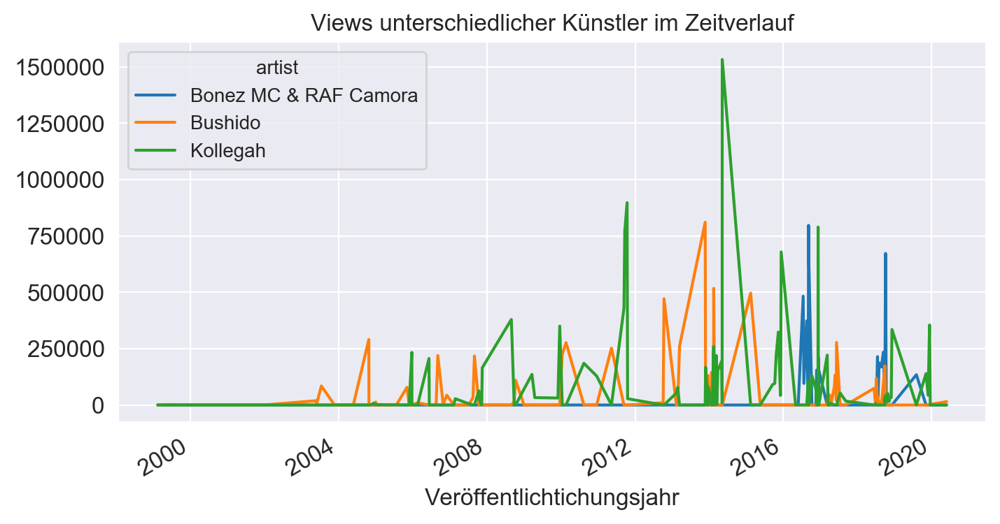

In [4]:
artists = ['Kollegah', 'Bonez MC & RAF Camora', 'Bushido']
artists_overtime = genius_df[['artist','pageviews','released_at']]
artists_overtime = artists_overtime[(artists_overtime['artist'].isin(artists)) & (artists_overtime['released_at'] != 'N/A')]
artists_overtime = artists_overtime.groupby(['artist','released_at']).agg({'pageviews': 'sum'}).reset_index()
artists_overtime.pivot(index='released_at', columns='artist', values='pageviews').fillna(0).plot(title='Views unterschiedlicher Künstler im Zeitverlauf')
plt.xlabel('Veröffentlichtichungsjahr')

Hier fallen einige Zeitpunkte stark auf. Beipielsweise der enorme Anstieg des Rap-Künstlers Kollegah im Jahre 2014. Dort wurde sein Album „King“ veröffentlicht, welches sein erfolgreichstes Album ist. Aber auch der starke Ansteig Ende 2011 markiert den Release seines Albums „Bossaura“. Auch bei Bonez MC & RAF Camora ist der Anstieg um 2016 bemerkbar, dieser ist jedoch nicht so steil wie bei Kollegahs Album „King“. Dies liegt daran, dass die einzelnen Songs ihres Albums „Palmen aus Plastik“ über mehrere Monate veröffentlicht wurden und nicht an einem Tag wie bei „King“. Auch der zweite stärkere Anstieg in 2018 markiert die Veröffentlichung des Albums „Palmen aus Plastik 2“. Auch bei Bushido ist vor allem die Zeit zwischen 2014 bis Ende 2015 interessant. In dieser Zeitspanne veröffentlichte er die Alben „Sonny Black“, „Carlo Cokxxx Nutten 3“ und „CLA$$IC (Deluxe)“, welche den Anstieg erklären.

### Künstler mit den meisten Views

Text(0, 0.5, 'Künstler')

Text(0.5, 0, 'Views in Millionen')

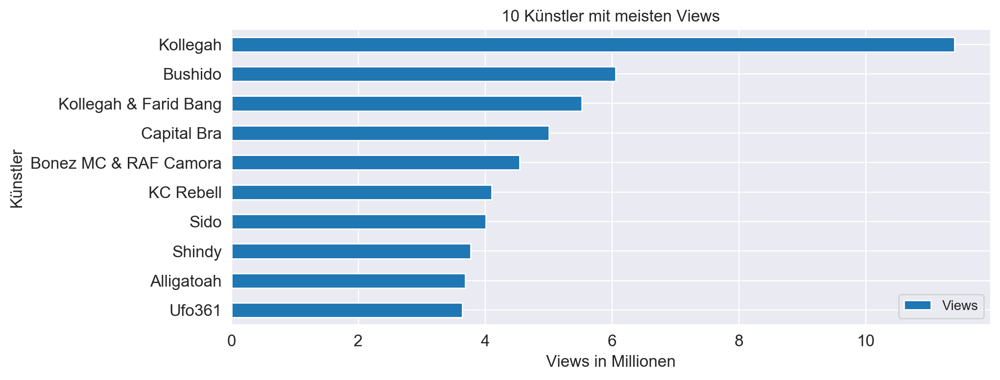

In [5]:
most_viewed_artists_df = genius_df[['artist','pageviews']]
most_viewed_artists_df = most_viewed_artists_df.groupby(['artist']).agg({'pageviews': 'sum'}).reset_index()
most_viewed_artists_df = most_viewed_artists_df.sort_values(['pageviews'], ascending=False)
most_viewed_artists = most_viewed_artists_df.head(10)
ax = most_viewed_artists.plot(x='artist', kind='barh', figsize=(10, 4), title='10 Künstler mit meisten Views')
ax.set_ylabel('Künstler')
ax.set_xlabel('Views in Millionen')
ax.legend(['Views'])
ax.invert_yaxis()
ax.xaxis.set_major_formatter(million_formatter)

### Künstler und ihre Features

Im nachfolgenden Block werden die benötigten Operationen durchgeführt, damit eine Gephi-Datei für einen Cooccurrence-Graph erstellt werden kann.

In [6]:
import itertools
def createCooccurrences(row, cooccurrences, viewed_artists):
    featured_artists = row['featured_artists'].split(',')
    main_artist = row['artist']
    if(main_artist in viewed_artists):
        artists = [ artist for artist in featured_artists if artist in viewed_artists ]
        artists.append(main_artist)
        combinations = itertools.combinations(set(artists), 2)
        for (p1, p2) in combinations:
            # sorgt für alphabetische Reihenfolge p1 < p2 im Tupel (p1, p2)
            if p1 < p2:
                cooccurrences.append((p1, p2))
            else:
                cooccurrences.append((p2, p1))
pd.set_option('display.max_rows', None)

cooccurrences = []
viewed_artists = []
for artist in most_viewed_artists_df['artist']:
    viewed_artists.append(artist) 

_ = genius_df.apply(lambda row : createCooccurrences(row, cooccurrences, viewed_artists), axis = 1)
co_df = pd.DataFrame.from_records(cooccurrences, columns=('source', 'target'))
edge_df = co_df.groupby(['source', 'target'])[['target']] \
             .count() \
             .rename(columns={'target':'weight'}).reset_index()
edge_df
import networkx as nx
graph = nx.from_pandas_edgelist(edge_df, 
                                source='source',
                                target='target',
                                edge_attr=True)

,source,target,weight
0,187 Strassenbande,Bonez MC,59
1,187 Strassenbande,Gzuz,46
2,187 Strassenbande,Gzuz & Bonez MC,1
3,187 Strassenbande,Haftbefehl,1
4,187 Strassenbande,Hanybal,1
5,187 Strassenbande,Kontra K,3
6,187 Strassenbande,Maxwell 187,21
7,187 Strassenbande,Mosh36,6
8,187 Strassenbande,Nate57,1
9,187 Strassenbande,RAF Camora,2


Der nachfolgende Block erstellt die Gephi-Datei aus dem vorher erstellten Graph:

In [9]:
#erzeugt genius_rappers.gexf Datei, die mit Gephi verwendet werden kann, um die Visualisierung erstellen zu können
nx.readwrite.write_gexf(graph, 'genius_rappers.gexf', encoding='utf-8', 
                        prettyprint=True, version='1.2draft')

Aus der vorher erstellten Gephi-Datei wird durch Befolgen der Schritte dieses Tutorials [[5](#Literatur-und-Links)] die Visualisierung ([Cooccurrence-Graph](Genius-Rappers&Features.pdf) → Chrome blockiert leider das Ansehen der PDF-Datei, in Edge funktioniert das ganze ohne Probleme) erstellt. Um mehr Communities zu identifizieren, die durch die Farbgebung der Knoten und Kanten dargestellt werden, wurde für die Modularität der Wert 0.5 verwendet.  Die Größe der Knoten hängt von der Anzahl der Auftritte des Rappers als „Hauptrapper“ oder „Featuregast“ in Songs ab. Des Weiteren ist es möglich, Knoten zu filtern, die weniger als 2 Verbindungen mit anderen Knoten haben. Leider bleibt die Einstellung der Filterung beim Speichern nicht bestehen, weshalb man in der rechten Leiste über Abfragen → Wertebereich Grad → Parameter → range diese Einstellung in Gephi vornehmen kann. Durch Bewegen des Sliders auf 2 und Drücken des Filter-Buttons wird der Graph gefiltert. Die zugehörige Gephi-Projekt-Datei heißt Genius-Rappers&Features.gephi.

Im den unteren Beispielen sieht man zwei beispielhafte Communities aus der enstandenen Visualisierung. Rap-Fans würden diese zwei Communites sofort erkennen. Die erste Community stellt die Rapgruppe „KMN Gang“ dar und die zweite die „187 Strassenbande“.

![KMN-Gang](resources/Cooccurrence-KMN-Gang.png)

![187](resources/Cooccurrence-187.png)

### Künstler mit den meisten expliziten/impliziten Songs

Ermitteln der Anzahl der expliziten (true) und impliziten (false) der Songs aller Künstler:

In [6]:
artist_explicity = genius_df[['title','artist','is_explicit']]
artist_explicity = artist_explicity.groupby(['artist','is_explicit']).count().rename(columns={'title':'count'}).reset_index()
artist_explicity

,artist,is_explicit,count
0,102 Boyz,false,8
1,102 Boyz,true,49
2,187 Strassenbande,false,5
3,187 Strassenbande,true,86
4,257ers,false,12
...,...,...,...
294,Yung Kafa & Küçük Efendi,true,16
295,Zate,false,7
296,Zate,true,65
297,Zuna,false,13


Ermitteln der Anzahl der Lieder der Künstler:

In [7]:
artist_song_count = genius_df["artist"].value_counts()
artist_song_count

Kollegah                                411
Eko Fresh                               385
Prinz Pi                                359
Bushido                                 336
Fler                                    317
Kool Savas                              287
Samy Deluxe                             278
Money Boy                               276
RAF Camora                              232
Kontra K                                211
Alligatoah                              196
Chakuza                                 191
Fard                                    188
Olexesh                                 187
257ers                                  185
Ali As                                  182
Sido                                    179
PA Sports                               161
K.I.Z.                                  156
Sierra Kidd                             155
Nazar                                   153
Ufo361                                  151
Summer Cem                      

Hier werden alle Künstler entfernt, die weniger als 10 Lieder haben, um die sinnvolle Bewertung der Explizität gewährleisten zu können:

In [8]:
def cleanArtists(row, drop_artists):
    artist = row["artist"]
    for index, value in artist_song_count.items():
        if(index == artist and value < 10):
            drop_artists.append(row.name)

drop_artists = []
_ = artist_explicity.apply(lambda row : cleanArtists(row, drop_artists), axis = 1)
artist_explicity.drop(artist_explicity.index[drop_artists], inplace=True)
artist_explicity.reset_index(drop=True, inplace=True)

Jetzt teilen wir noch die Anzahl der expliziten und impliziten Lieder mit der Anzahl aller Lieder für jeden Künstler. Dadurch erhalten wir den Prozentteil aller expliziten und impliziten Lieder für jeden Künstler:

In [9]:
def calculate_explicity_per_song(row, artist_song_count):
    artist = row["artist"]
    for index, value in artist_song_count.items():
        if(index == artist):
            return row["count"] / value
        
artist_explicity["count"] = artist_explicity.apply(lambda row : calculate_explicity_per_song(row, artist_song_count), axis = 1)
artist_explicity

,artist,is_explicit,count
0,102 Boyz,false,0.14
1,102 Boyz,true,0.86
2,187 Strassenbande,false,0.05
3,187 Strassenbande,true,0.95
4,257ers,false,0.06
...,...,...,...
239,Yung Kafa & Küçük Efendi,true,0.62
240,Zate,false,0.10
241,Zate,true,0.90
242,Zuna,false,0.23


Im Folgenden betrachten wir nur den Prozentteil der expliziten Lieder für jeden Künstler:

In [10]:
explicit_artists = artist_explicity[artist_explicity['is_explicit'] == "true"].sort_values('count', ascending=False)
explicit_artists 

,artist,is_explicit,count
225,Trailerpark,true,1.00
108,Kollegah & Farid Bang,true,1.00
203,Savas & Sido,true,1.00
39,Bushido & Shindy,true,1.00
38,Bushido & Animus,true,1.00
224,TJ_beastboy & Mary Man,true,1.00
71,Farid Bang,true,0.99
217,SpongeBOZZ,true,0.98
138,Majoe & Jasko,true,0.98
122,Lance Butters,true,0.97


In [11]:
explicit_frequencies = {}
for index, row in explicit_artists.iterrows():
    artist = row['artist']
    count = row['count']
    explicit_frequencies[artist] = count
explicit_frequencies

{'Trailerpark': 1.0,
 'Kollegah & Farid Bang': 1.0,
 'Savas & Sido': 1.0,
 'Bushido & Shindy': 1.0,
 'Bushido & Animus': 1.0,
 'TJ_beastboy & Mary Man': 1.0,
 'Farid Bang': 0.9931972789115646,
 'SpongeBOZZ': 0.9836065573770492,
 'Majoe & Jasko': 0.9767441860465116,
 'Lance Butters': 0.9701492537313433,
 'Ali Bumaye': 0.9655172413793104,
 'Battleboi Basti': 0.9629629629629629,
 'Sun Diego': 0.96,
 'SXTN': 0.96,
 'Gzuz & Bonez MC': 0.9565217391304348,
 'Kollegah': 0.9537712895377128,
 'Summer Cem': 0.9536423841059603,
 'Gzuz': 0.95,
 'LX & Maxwell': 0.95,
 'Bushido': 0.9494047619047619,
 'Money Boy': 0.9492753623188406,
 'Fard': 0.9468085106382979,
 'Eko Fresh': 0.9454545454545454,
 'Haftbefehl': 0.9453125,
 '187 Strassenbande': 0.945054945054945,
 'Seyed': 0.9433962264150944,
 'Punch Arogunz': 0.9423076923076923,
 'Sudden': 0.9402985074626866,
 'Samy Deluxe': 0.9388489208633094,
 'Kay One': 0.9380530973451328,
 'Genetikk': 0.9351851851851852,
 '257ers': 0.9351351351351351,
 'Sero El Mer

In [12]:
def explicity_wordcloud(frequencies, bg_color="black"):
    wc = WordCloud(width=800, height=400, 
                   background_color=bg_color, colormap="Paired", 
                   max_words=200) 
    # Generierung der Wordcloud
    # Worte aus Liste müssen dafür aneinander gehängt werden
    # wc.generate(' '.join(list_of_words))
    wc.generate_from_frequencies(frequencies)

    # Plot
    fig=plt.figure(figsize=(20, 10))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis("off")
    plt.tight_layout(pad=0)
    plt.show()

In der Wordcloud fällt auf, dass die Lieder der meisten Rapper größtenteils explizit sind, dies äußert sich in der Größe der Namen der Rapper.

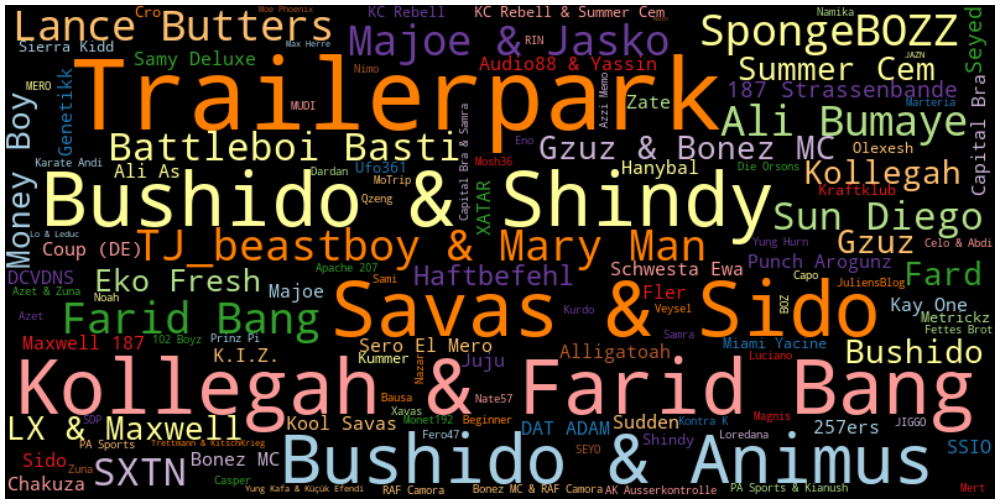

In [14]:
explicity_wordcloud(explicit_frequencies)

Im Folgenden betrachten wir nur den Prozentteil der impliziten Lieder für jeden Künstler:

In [15]:
implicit_artists = artist_explicity[artist_explicity['is_explicit'] == "false"].sort_values('count', ascending=False)
implicit_artists

,artist,is_explicit,count
163,Nash,false,0.73
123,Lo & Leduc,false,0.50
88,JAZN,false,0.50
226,Trettmann & KitschKrieg,false,0.45
153,Moe Phoenix,false,0.44
141,Max Herre,false,0.39
238,Yung Kafa & Küçük Efendi,false,0.38
42,Capital Bra & Samra,false,0.38
155,Monet192,false,0.36
236,Yung Hurn,false,0.34


In [16]:
implicit_frequencies = {}
for index, row in implicit_artists.iterrows():
    artist = row['artist']
    count = row['count']
    implicit_frequencies[artist] = count
implicit_frequencies

{'Nash': 0.7272727272727273,
 'Lo & Leduc': 0.5,
 'JAZN': 0.5,
 'Trettmann & KitschKrieg': 0.45,
 'Moe Phoenix': 0.4444444444444444,
 'Max Herre': 0.39344262295081966,
 'Yung Kafa & Küçük Efendi': 0.38461538461538464,
 'Capital Bra & Samra': 0.38461538461538464,
 'Monet192': 0.36363636363636365,
 'Yung Hurn': 0.3424657534246575,
 'Mosh36': 0.32926829268292684,
 'Samra': 0.32608695652173914,
 'RIN': 0.32558139534883723,
 'Sami': 0.32,
 'Eno': 0.3125,
 'Azzi Memo': 0.3,
 'MERO': 0.3,
 'Noah': 0.2962962962962963,
 'Fero47': 0.2857142857142857,
 'Capo': 0.2826086956521739,
 'Bausa': 0.26666666666666666,
 'Azet': 0.2571428571428571,
 'SEYO': 0.25,
 'Bonez MC & RAF Camora': 0.24528301886792453,
 'Die Orsons': 0.23958333333333334,
 'Zuna': 0.23214285714285715,
 'AK Ausserkontrolle': 0.2318840579710145,
 'Xavas': 0.23076923076923078,
 'Namika': 0.23076923076923078,
 'SDP': 0.22807017543859648,
 'Luciano': 0.22641509433962265,
 'Marteria': 0.22580645161290322,
 'RAF Camora': 0.22413793103448276

Auch in dieser Wordcloud fällt auf, dass die Lieder der meisten Rapper größtenteils explizit sind. Dies äußert sich in der Größe der Namen der Rapper, welche bei den meisten Rappern sehr klein ist. 

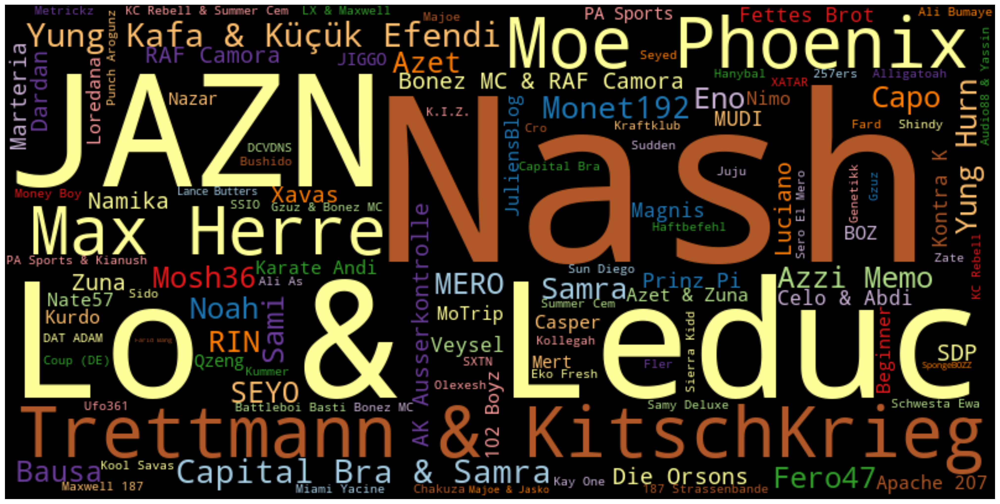

In [17]:
explicity_wordcloud(implicit_frequencies)

## Songs im Fokus

In diesem Kapitel geht es um Statistiken rund um die Deutschrap-Songs. Hierbei wird als Erstes der Anteil der expliziten und impliziten Songs untersucht, bevor schließlich die Interaktion der Fans und Genius-Nutzer mit den Songs unter die Lupe genommen wird.

### Anteil der expliziten/impliziten Songs

Viele Streaming-Plattformen kennzeichnen − wie vorher erklärt − Songs mit Explicit/Implicit. Mit Explicit werden Songs gekennzeichnet, bevor sie zensiert werden, da sie Ausdrücke oder ähnliches enthalten. Die Implicit-Version eines Songs ist dann die zensierte Version beziehungsweise ein Song, welcher nicht zensiert werden muss, da er keine vulgäre Sprache oder ähnliches enthält. In der folgenden Grafik stellen wir den Anteil der Explicit-Songs dem Anteil der Implicit-Songs unserer gecrawlten Daten gegenüber:

Text(0, 0.5, '')

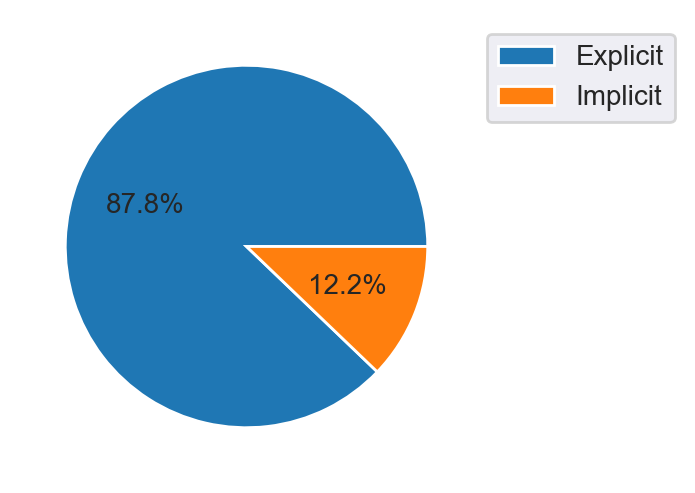

In [18]:
ax = genius_df['is_explicit'].value_counts().plot(kind='pie', autopct='%.1f%%', figsize=(4, 3), labeldistance=None)
ax.legend(['Explicit', 'Implicit'],bbox_to_anchor=(1,1), ncol=1) 
ax.set_ylabel(None)

Wie Sie sehen ist der Großteil der Deutschrap-Songs explizit, also nicht jugendfrei.

### Songs mit den meisten Contributor und Referenzen

In der nachfolgenden Statistik werden die Songs gezeigt, die die höchste Anzahl an Contributor und Referenzen haben. Ein Contributor ist ein User, der für den Song Informationen hinzugefügt hat. Diese kann eine Referenz, Informationen zum zugehörigen Album, Aufnahemorte, etc. sein. Eine Referenz ist eine Erklärung für den Inhalt des Songs. Dabei bezieht sich eine Referenz meisten auf eine Zeile im Song und erklärt deren Bedeutung.  

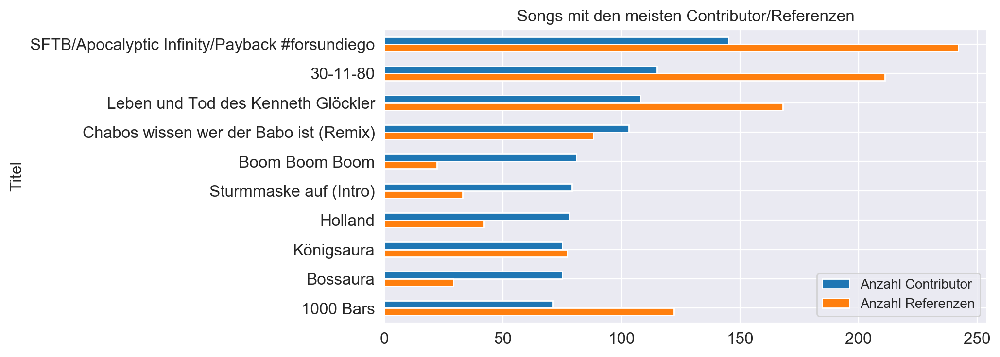

In [19]:
fan_interaction_df = genius_df[['title','artist','contributor_count', 'count_referents']]
fan_interaction_df
fan_interaction_df = fan_interaction_df.sort_values(['contributor_count', 'count_referents'], ascending=[False, False])

ax = fan_interaction_df.head(10).plot(x='title', kind="barh", title='Songs mit den meisten Contributor/Referenzen')
ax.set_ylabel("Titel")
ax.invert_yaxis()
ax.legend(["Anzahl Contributor", "Anzahl Referenzen"]);

Bei dieser Statistik fällt auf, dass die Songs „SFTB/Apocalyptic Infinity/Payback #forsundiego“ und „Leben und Tod des Kenneth Glöckler“ eine sehr hohe Anzahl an Referenzen aufweisen. Grund dafür ist höchstwahrscheinlich die Art dieser Songs. Beide Songs sind Disstracks gegen einen anderen Rappper. Bei Disstracks geht es darum, den anderen Rapper mit seinen geschriebenen Zeilen zu „zerstören“. Diese Art von Songs sind voller Beleidigungen und Verhöhnungen, die sich gegen den musikalischen Kontrahenten richten. Deshalb werden von den Fans viele unterschiedliche Zeilen genauer erklärt, um den Inhalt des Disstracks verständlich zu machen, wodurch so viele Referenzen enthalten sind.

## Worte im Fokus

Die Statistiken dieses Kapitels beziehen sich auf die Deutschrap-Texte. Die ersten beiden Unterkapitel handeln von den Worthäufigkeiten im Allgemeinen. Passend zur zentralen Frage nach Jugendfreundlichkeiten beziehungsweise Implizität handeln die darauffolgenden drei Unterkapitel von den Schimpfworten, welche in den Texten auftreten.

Bevor besagte Statistiken behandelt werden, finden Sie hier noch vorbereitende Maßnahmen zu Beginn dieses Kapitels.

Folgender Block liest alle Tokens aus allen extrahierten Songs:

In [20]:
def extract_tokens(row, songs_as_tokens):
    songs_as_tokens.append(re.findall(r"[\w']+[\.\w]*\w+", row))
    
songs_as_tokens = []
_ = genius_df['song_text'].map(lambda row: extract_tokens(row, songs_as_tokens))

Angepasste Stoppwortliste einlesen:

In [21]:
with open('resources/stopwords_de.txt', encoding='utf-8') as file:
    stopwords = file.read().splitlines()
    
stopwords.append('Yeah')
stopwords.append('yeah')
stopwords.append('Ey')
stopwords.append('ey')
stopwords.append('wouh')
#stopwords.append('uh')
#stopwords.append('Uh')
#stopwords.append('huh')

Schimpfwortliste mit Hilfe einer Schimpfwort-Webseite [[6](#Literatur-und-Links)] erstellen:

Bitte überspringen Sie den folgenden Block und fahren Sie beim darauffolgenden Block fort. Leider wurde die Webseite der Schimpfworte kurz vor Abgabe des Projekts offline genommen.

In [22]:
import requests
import scrapy

url = "http://www.insult.wiki/wiki/Schimpfwort-Liste"
reply = requests.get(url)

response = scrapy.http.TextResponse(url, body=reply.text, encoding='utf-8')

insult_list = response.css('ol li a::text').extract()

insult_list.remove('Baby') # nie als Beleidigung verwendet
insult_list.remove('Typ') # selten als Beleidigung verwendet
insult_list.remove('Ding') # nie als Beleidigung verwendet
insult_list.remove('Gangster') # selten als Beleidigung verwendet 
insult_list.remove('Alien') # selten als Beleidigung verwendet
insult_list.remove('Batzen') # meist als Synonym für „Geldbündel“ verwendet

print(insult_list)

ValueError: list.remove(x): x not in list

Glücklicherweise haben wir die Liste zur Sicherheit abgespeichert:

In [23]:
insult_list = ['ABS-Bremser', 'Aa-Esser', 'Aa-Gesicht', 'Aa-Kopf', 'Aa-Loch', 'Aa-Wurst', 'Aal', 'Aalauge', 'Aalficker', 'Aalfresse', 'Aalwurstverkäufer', 'Aas', 'Aasfresser', 'Aasgeier', 'Aasknochen', 'Abart', 'Abc-Schüler', 'Abc-Schütze', 'Abdecker', 'Abdeckstiftbenutzer', 'Abderit', 'Abendvogel', 'Abenteurer', 'Abfall', 'Abfall, biochemischer', 'Abfallprodukt', 'Abfalltonnenvollscheißer', 'Abficker', 'Abflussrohrgucker', 'Abflussrohrsauger', 'Abgaskakerlake', 'Abgasproduzent', 'Abgötter', 'Abortdeckel', 'Abschaum', 'Abscheißer', 'Abschiedswinker', 'Abschmierer', 'Abschreiber', 'Abseiler', 'Abseitserklärer', 'Abspritzer', 'Absturztorte', 'Absturzvogel', 'Abtrittfeger', 'Abtrünniger', 'Abtörner', 'Abwasserschlürfer', 'Abwichshure', 'Abzocker', 'Achselbaron', 'Achselficker', 'Achselgrind', 'Achselhaarflechter', 'Achselhaarföner', 'Achselhaarratte', 'Achselhaarspalter', 'Achsellecker', 'Achselschweißfontaine', 'Achselträger', 'Achterbahnindermittesitzer', 'Achterbahnkotzer', 'Achtgeber', 'Achthaber', 'Ackerarsch', 'Ackerfresse', 'Adamskind', 'Adamssohn', 'Adder', 'Affe', 'Affe, haarloser', 'Affenarsch', 'Affenarschficker', 'Affenarschfurchenfetischist', 'Affenarschgesicht', 'Affenarschloch', 'Affenbesamer', 'Affenbumser', 'Affeneichellecker', 'Affenfehlfick', 'Affenficker', 'Affenfotze', 'Affenfresse', 'Affengesicht', 'Affenhirn', 'Affenhoden', 'Affenjunge', 'Affenkacke', 'Affenkind', 'Affenkopf', 'Affenkönig', 'Affenmensch', 'Affenmutter', 'Affennase', 'Affensack', 'Affenschwanz', 'Affenschwanzlutscher', 'Affenschänder', 'Afterarzt', 'Afterforscher', 'Aftergelehrter', 'Afterhöhlenforscher', 'Afterkind', 'Afterkritiker', 'Afterlecker', 'Afterlehrer', 'Afterprophet', 'Afterredner', 'Afterwissenschaftler', 'Aktendrescher', 'Aktenfresser', 'Aktenkrämer', 'Aktenreiter', 'Aktenwurm', 'Alberling', 'Alfanzer', 'Alki', 'Allerweltsbetrüger', 'Allerweltscourmacher', 'Allerweltshure', 'Allerweltsnarr', 'Allerweltsraffel', 'Allerweltsranke', 'Allerweltsräuber', 'Allerweltswisser', 'Allesbesserwisser', 'Alleswisser', 'Allmannshure', 'Alltagsdichter', 'Alltagsgesicht', 'Alltagslaffe', 'Alltagsmensch', 'Alltagsseele', 'Almosenfresser', 'Alptraum', 'Alraune', 'Altenheimnutte', 'Altenheimschlampe', 'Altflicker', 'Altkluger', 'Altweiberficker', 'Alufolienglattstreicher', 'Amateur', 'Amateuse', 'Amazone', 'Ameisenbär', 'Ameisenficker', 'Ammenmacher', 'Ampelgelbbremser', 'Amsel', 'Amöbe', 'Analakrobat', 'Analatmer', 'Analbaron', 'Analbergsteiger', 'Analbesamer', 'Analbohrer', 'Analfetischist', 'Analficker', 'Analfisch', 'Analfissur', 'Analfotze', 'Analfürst', 'Analgeburt', 'Analgesicht', 'Analglocke', 'Analkopf', 'Analphabet', 'Analpilot', 'Analpirat', 'Analrakete', 'Analratte', 'Analraupe', 'Analreiniger', 'Analreiter', 'Analritter', 'Analrosine', 'Analruine', 'Analrülpser', 'Analtranse', 'Analtrompete', 'Analytiker', 'Anarchist', 'Anbeter', 'Andächtler', 'Anekdotenjäger', 'Anekdotenkrämer', 'Anfechter', 'Anfänger', 'Angaffer', 'Angeber', 'Angsthase', 'Angstkind', 'Angstmann', 'Angstpisser', 'Anhang', 'Anhetzer', 'Anhängsel', 'Anisbrenner', 'Anpinsler', 'Anreizer', 'Anstifter', 'Anstörer', 'Anthropophag', 'Antichrist', 'Antiheld', 'Antimensch', 'Anus', 'Anuslecker', 'Anzettler', 'Apfel, fauler', 'Apfeltasche', 'Apostat', 'Apostelträger', 'Aprilnarr', 'Arbeitsscheuer', 'Arkanenkrämer', 'Armleuchter', 'Arsch', 'Arschbacke', 'Arschbackenjäger', 'Arschbohrer', 'Arschbombe', 'Arschbratze', 'Arschbumser', 'Arschbär', 'Arschfalte', 'Arschficker', 'Arschfickerlehrling', 'Arschflöte', 'Arschfotze', 'Arschfresse', 'Arschgeburt', 'Arschgeier', 'Arschgeige', 'Arschgeiger', 'Arschgesicht', 'Arschgranate', 'Arschgucker', 'Arschgurke', 'Arschhaar', 'Arschi', 'Arschkacker', 'Arschkante', 'Arschkeks', 'Arschkind', 'Arschkipf', 'Arschkopf', 'Arschkrampe', 'Arschkrapfen', 'Arschkrebs', 'Arschkriecher', 'Arschkrämer', 'Arschkröte', 'Arschkrümel', 'Arschkuh', 'Arschlappen', 'Arschlecker', 'Arschloch', 'Arschlochficker', 'Arschlochkind', 'Arschlochlecker', 'Arschlutscher', 'Arschmade', 'Arschmonarch', 'Arschnase', 'Arschnutte', 'Arschpauker', 'Arschpenner', 'Arschpfeife', 'Arschpickel', 'Arschpilzsammler', 'Arschpirat', 'Arschpisser', 'Arschpopper', 'Arschrammler', 'Arschratte', 'Arschsack', 'Arschscheißer', 'Arschtrampe', 'Arschvieh', 'Arschvogel', 'Arschvotze', 'Arschwarmer', 'Arschwassertrinker', 'Arschwichser', 'Arschwurst', 'Aschenbrödel', 'Asi', 'Aslak', 'Asmodi', 'Asozialer', 'Assel', 'Assi', 'Astloch', 'Astlochbumser', 'Astlochficker', 'Atomschlumpf', 'Attrappe', 'Aufhetzer', 'Auflaurer', 'Aufmerker', 'Aufpasser', 'Aufreißer', 'Aufruhrprediger', 'Aufrührer', 'Aufschneider', 'Aufschößling', 'Aufwiegler', 'Augendiener', 'Ausbeuter', 'Ausbund', 'Ausforscher', 'Ausfrager', 'Ausgeburt', 'Ausgeburt der Hölle', 'Ausgrübler', 'Aushilfsamöbe', 'Auskehricht', 'Ausklauber', 'Auskundschafter', 'Ausplauderer', 'Ausplätscher', 'Auspuffbefruchter', 'Ausreißer', 'Aussauger', 'Ausschmierer', 'Ausschreiber', 'Ausschuss', 'Ausschwätzer', 'Ausspäher', 'Ausspürer', 'Aussätziger', 'Auswuchs', 'Auswurf', 'Auswürfling', 'Autoficker', 'Automat', 'Automatikfahrer', 'Außenseiter', 'Außerirdischer', 'BAföG-Schmarotzer', 'Babbelhans', 'Babbler', 'Babybefruchter', 'Babyface', 'Babyficker', 'Bachant', 'Bachstelze', 'Bachus', 'Bachusbruder', 'Bachusknecht', 'Backblech', 'Backofenvorheizer', 'Badeknecht', 'Badstübler', 'Bagage', 'Bagalut', 'Bagatellenkrämer', 'Bajazzo', 'Bakterienschleuder', 'Baldober', 'Balg', 'Ballast', 'Bambusratte', 'Bananenbieger', 'Bananenlutscher', 'Banause', 'Bandit', 'Bankbein', 'Bankerottirer', 'Bankert', 'Bankrutscher', 'Baraber', 'Barbar', 'Barbe', 'Barfüßler', 'Barsch', 'Bartabnehmer', 'Barthans', 'Bartkerl', 'Bartkratzer', 'Bartloser', 'Bartputzer', 'Bartschaber', 'Bartscheerer', 'Bartschinder', 'Barüschnik', 'Basilisk', 'Bastard', 'Batzenschmelzer', 'Bauchdiener', 'Bauchpfaffe', 'Bauer', 'Bauernbengel', 'Bauernbursch', 'Bauerndirne', 'Bauernfiedler', 'Bauernflegel', 'Bauernfänger', 'Bauernfünfer', 'Bauerngesindel', 'Bauernhure', 'Bauernjunge', 'Bauernkerl', 'Bauernkind', 'Bauernknoll', 'Bauernlümmel', 'Bauernmensch', 'Bauernmädchen', 'Bauernpack', 'Bauernplaker', 'Bauernsohn', 'Baumficker', 'Baumschüler', 'Bazi', 'Bazille', 'Bazillenschleuder', 'Beckenrandschwimmer', 'Bedenkenträger', 'Beidl', 'Bengel', 'Benzinpreisvergleicher', 'Berserker', 'Berufslesbe', 'Berufsopfer', 'Berufsschwuchtel', 'Berufsschwuler', 'Bescheißer', 'Besen', 'Besserwessi', 'Besserwisser', 'Bestie', 'Betonkopf', 'Betriebsunfall', 'Betrüger', 'Bettler', 'Beutelschneider', 'Biedermann', 'Bierbruder', 'Bierdimpfel', 'Bierschlampe', 'Biest', 'Bildungsnutte', 'Bison', 'Bitch', 'Blender', 'Blindgänger', 'Blockflötengesicht', 'Blockwart', 'Blondchen', 'Blutegel', 'Bluthund', 'Blutsauger', 'Blutwurst', 'Blödel', 'Blödian', 'Blödkopf', 'Blödmann', 'Blödmannsgehilfe', 'Blödvogel', 'Bock', 'Bockwurstwasserduscher', 'Bockwurstwassersäufer', 'Bohnenstange', 'Bolzen', 'Bonze', 'Bordsteinschwalbe', 'Boxenluder', 'Brandstifter', 'Bratze', 'Brechmittel', 'Bremse', 'Brillenschlange', 'Brontosaurier', 'Bruchpilot', 'Bruder, warmer', 'Brummbär', 'Brummer', 'Brüllaffe', 'Brüller', 'Bubenhure', 'Bubi', 'Buhmann', 'Bulle', 'Bumskarnickel', 'Bumskopf', 'Bumskuh', 'Buschnutte', 'Busengrabscher', 'Bussard', 'Bäffer', 'Bänkelsänger', 'Bär', 'Bärbeißer', 'Bärenführer', 'Bärenhäuter', 'Bärenjäger', 'Bösewicht', 'Bücherwurm', 'Bückling', 'Büffel', 'Bürokrat', 'Büttel', 'Cabriogeschlossenfahrer', 'Camper', 'Canaille', 'Casanova', 'Chameur', 'Chamäleon', 'Chaot', 'Charakterschwein', 'Cheater', 'Checklistenbearbeiter', 'Chefgrüßer', 'Chefzäpfchen', 'Chilliverweigerer', 'Choleriker', 'Chromosomenfasching', 'Chromosomengepansche', 'Citypupser', 'Clearasilversuchsgelände', 'Clerasiltestgelände', 'Cloake', 'Clochar', 'Clochard', 'Clown', 'Clownficker', 'Cornflakesfresser', 'Crackbitch', 'Crackhure', 'Cracknutte', 'Crackschlampe', 'Currywurst', 'Cyberschlampe', 'DAU', 'Dachplatte', 'Dackel', 'Dackelficker', 'Dackeltrainer', 'Dackelzüchter', 'Damenradfahrer', 'Dampfnudel', 'Dampfplauderer', 'Danebenpinkler', 'Danebenpisser', 'Dankesager', 'Dapp', 'Darmamöbe', 'Darmdübel', 'Darmquastenzorro', 'Darmwandgucker', 'Dauercamper', 'Dauerflenner', 'Dauerlutscher', 'Dauerwellenträger', 'Dauerwichser', 'Daumenlutscher', 'Deckschrubber', 'Delfinficker', 'Demagoge', 'Depp', 'Depp vom Dienst', 'Deppala', 'Deppkopf', 'Desperado', 'Dickarsch', 'Dickbauch', 'Dickdarmakrobat', 'Dickkopf', 'Dicknase', 'Dickschwein', 'Dickschädel', 'Dieb', 'Diebsgesindel', 'Dieselhandschuhtanker', 'Dieselhandschuhträger', 'Dildokopf', 'Dildolutscher', 'Dillo', 'Dinosaurier', 'Diplomverkehrsinselbepflanzer', 'Diplomwichser', 'Dirne', 'Disconutte', 'Discowichser', 'Diskettenformatierer', 'Dissopfer', 'Dodl', 'Doldie', 'Dollbohrer', 'Dolm', 'Donnerfotze', 'Doofbommel', 'Doofdödel', 'Doofer', 'Doofi', 'Doofian', 'Doofkopf', 'Doofmann', 'Doofnudel', 'Doppeldepp', 'Dorfdepp', 'Dorffahrrad', 'Dorfkuh', 'Dorfmatratze', 'Dorfmoped', 'Dorfnutte', 'Dorfschlampe', 'Dorftrottel', 'Dorsch', 'Dorschgesicht', 'Drache', 'Dreckhure', 'Dreckluder', 'Drecksack', 'Drecksau', 'Drecksbulle', 'Dreckschleuder', 'Drecksfotze', 'Drecksgesicht', 'Drecksgöre', 'Dreckskerl', 'Drecksmuschi', 'Drecksnutte', 'Drecksschwein', 'Dreckstück', 'Drehstuhlbesamer', 'Dreikäsehoch', 'Dreilochhure', 'Dreilochnutte', 'Dreilochschlampe', 'Dreilochstute', 'Drohne', 'Druckspüler', 'Drückeberger', 'Dschungelkind', 'Dummbeutel', 'Dummbrot', 'Dummdepp', 'Dummei', 'Dummerchen', 'Dummfotze', 'Dummhirn', 'Dummi', 'Dummkopf', 'Dummsau', 'Dummschwätzer', 'Dummy', 'Dumpfbacke', 'Dunkelmann', 'Durchfallgurgler', 'Durchfalltrinker', 'Dussel', 'Dust', 'Dämelsack', 'Dämlack', 'Döbel', 'Dödel', 'Dödelarsch', 'Dödelkopf', 'Döskopf', 'Düffeldoffel', 'Dünnbrettbohrer', 'Egoist', 'Egozentriker', 'Ehrabschneider', 'Eichelkäselutscher', 'Eichelkönig', 'Eichhörnchen', 'Eierdieb', 'Eierfeile', 'Eierhals', 'Eierkopf', 'Eiernacken', 'Eimer', 'Einfaltspinsel', 'Einsteinverschnitt', 'Ekelmann', 'Elefantenficker', 'Elektrogriller', 'Elster', 'Emanze', 'Emporkömmling', 'Entenklemmer', 'Erbsenzähler', 'Erzgauner', 'Erzhure', 'Esel', 'Eselarschficker', 'Eselficker', 'Eselpopper', 'Eselvergewaltiger', 'Eule', 'Eulenficker', 'Eulenkind', 'Eumel', 'Eumelkind', 'Eunuch', 'Euterlutscher', 'Evolutionsbremse', 'Evolutionsbremser', 'Exhibitionist', 'Exkrementenfresser', 'Fachidiot', 'Falschmünzer', 'Fatzke', 'Faulenzer', 'Faulpelz', 'Faultier', 'Feigling', 'Feldhure', 'Ferkel', 'Ferkelficker', 'Ferkelwemser', 'Festnetztelefonierer', 'Fettarsch', 'Fettsack', 'Fettwanst', 'Fickel', 'Ficker', 'Fickfehler', 'Ficksau', 'Fickschwein', 'Fickstück', 'Fiesling', 'Filzlaus', 'Fisch', 'Fischfotze', 'Fixer', 'Flachpfeife', 'Flachwichser', 'Flasche', 'Flaschenkopf', 'Flegel', 'Fliegenschiss', 'Flittchen', 'Flohficker', 'Folterknecht', 'Fotze', 'Fotzenkind', 'Fotzenknecht', 'Fotzenlecker', 'Fotzensau', 'Frauenversteher', 'Freak', 'Frechdachs', 'Fregatte', 'Freier', 'Fresser', 'Fresssack', 'Freudenmädchen', 'Frevler', 'Frischling', 'Frosch', 'Froschficker', 'Frostbeule', 'Fruchtzwerg', 'Früchtchen', 'Frühspritzer', 'Furie', 'Fuzzi', 'Fußabtreter', 'Fußfetischist', 'Fünferschüler', 'Fürst der Finsternis', 'Gabelreiter', 'Gaffer', 'Galgenhure', 'Galgenvogel', 'Gammler', 'Ganove', 'Gans', 'Garagenparker', 'Gartenzwerg', 'Gaskopf', 'Gaukler', 'Gauklershure', 'Gaul', 'Gauner', 'Gebärmutterabfall', 'Geek', 'Geilspecht', 'Geizhals', 'Geizkragen', 'Geißel der Menschheit', 'Gemüseputzer', 'Generalhure', 'Gernegroß', 'Gerät', 'Geschmeiß', 'Gesetzesbrecher', 'Gesichtsbaracke', 'Gesichtselfmeter', 'Gesindel', 'Gewitterhexe', 'Gezücht', 'Ghettoschlampe', 'Gierhals', 'Gierschlund', 'Giftzwerg', 'Gimpel', 'Gipskopf', 'Giraffe', 'Glaskugel', 'Glatzkopf', 'Gloifi', 'Glücksritter', 'Gorilla', 'Gossenpenner', 'Grabräuber', 'Grabschänder', 'Grantler', 'Grasaffe', 'Grasdackel', 'Grattler', 'Graupe', 'Greenhorn', 'Griesgram', 'Grobmotoriker', 'Grottenolm', 'Großkotz', 'Großmaul', 'Grufti', 'Gruftie', 'Grunzschwein', 'Grünschnabel', 'Grüßaugust', 'Gummihund', 'Gummipuppe', 'Gurke', 'Gutmensch', 'Göre', 'Günstling', 'Haarspalter', 'Habenichts', 'Hackfresse', 'Haderlump', 'Hafennutte', 'Hafenschlampe', 'Hahn', 'Halbaffe', 'Halbdackel', 'Hallodri', 'Halsabschneider', 'Halunke', 'Hammel', 'Hammerwerfer', 'Hampelmann', 'Hamster', 'Hansdampf', 'Hanswurst', 'Harfenspieler', 'Hartgeldnutte', 'Hartgeldstricher', 'Hartz-IV-Schmarotzer', 'Hartzer', 'Hasenfuß', 'Haubentaucher', 'Haufen', 'Hawak', 'Heckenbankert', 'Heckenpenner', 'Hehler', 'Heimscheißer', 'Heiratsschwindler', 'Hektiker', 'Henkershure', 'Herumtreiber', 'Herzensbrecher', 'Hesslon', 'Heuchler', 'Heulboje', 'Heulsuse', 'Heuschrecke', 'Hexe', 'Hinterlader', 'Hinterwäldler', 'Hippie', 'Hirni', 'Hirsch', 'Hirsel', 'Hobbygangster', 'Hochstapler', 'Hodengesicht', 'Hodensack', 'Hodenschmuser', 'Hofnarr', 'Hohlkörper', 'Hoink', 'Holzkopf', 'Homo erectus', 'Homopimmelpirat', 'Homoschlampe', 'Honk', 'Hool', 'Hormonarschloch', 'Hornochse', 'Hortkind', 'Hosenjodler', 'Hosenpinkler', 'Hosenpisser', 'Hosenscheißer', 'Hs', 'Hund', 'Hundehasser', 'Hundelecker', 'Hundertfünfundsiebziger', 'Hundeschnauze', 'Hundesohn', 'Hundsfott', 'Hundskrüppel', 'Hungerhaken', 'Hupe', 'Hupfdohle', 'Hure', 'Hurenbastard', 'Hurenbock', 'Hurenficker', 'Hurenjunge', 'Hurenjäger', 'Hurenkind', 'Hurensohn', 'Hurentochter', 'Hutsimpel', 'Hänfling', 'Höllenhund', 'Hühner-KZ-Aufseher', 'Idi', 'Idiot', 'Idiotenarsch', 'Idiotenfresse', 'Idiotengehilfe', 'Idiotenhäuptling', 'Idiotenkind', 'Ignorant', 'Ikonoklast', 'Imbissbudenkoch', 'Impotenter', 'Impotentling', 'Innentaschenbügler', 'Inselkind', 'Insgeheimrülpser', 'Intelligenzallergiker', 'Intelligenzbolzen', 'Internetausdrucker', 'Intrigant', 'Invasor', 'Inventar', 'Inzestgeburt', 'Inzuchtdepp', 'Inzuchtmeister', 'Inzüchtler', 'Irrer', 'Ische', 'Jammerer', 'Jammergestalt', 'Jammerlappen', 'Jammerossi', 'Jammersack', 'Jammerspacken', 'Jammersuse', 'Jasager', 'Jauchegrubentaucher', 'Jauchemaul', 'Jaucher', 'Jaucheschwimmer', 'Jauchetrinker', 'Jeansbügler', 'Jodelidiot', 'Jodelschnepfe', 'Jodsalzer', 'Joghurtbecherspüler', 'Jungenficker', 'Jungfer, alte', 'Jungspund', 'Junkie', 'Kachel', 'Kackawurst', 'Kackbratze', 'Kacker', 'Kackfresse', 'Kackhaufen', 'Kacklatte', 'Kackratte', 'Kackvogel', 'Kamel', 'Kameradenschwein', 'Kampflesbe', 'Kampfzwerg', 'Kanalratte', 'Kanalrattenficker', 'Kanalrattenschwanzlutscher', 'Kannibale', 'Kanonenfutter', 'Kartoffel', 'Kartoffelkopf', 'Kasper', 'Kasperle', 'Kassenpatient', 'Katzenkopf', 'Kellerkind', 'Kerl', 'Keule', 'Kichererbse', 'Kiffer', 'Killer', 'Kinderbeckenstruller', 'Kinderficker', 'Kinderleichenficker', 'Kinderschreck', 'Kinderschänder', 'Kindervergewaltiger', 'Kindskopf', 'Kirchenmaus', 'Klabautermann', 'Klassenkasper', 'Kleinhirn', 'Klippenscheißer', 'Klofrau', 'Klugscheißer', 'Klöte', 'Knabenficker', 'Knacki', 'Knallbirne', 'Knallbohne', 'Knallcharge', 'Knallerbse', 'Knallkopf', 'Knalltüte', 'Knastbruder', 'Knilch', 'Knirps', 'Knottler', 'Koffer', 'Kohlkopf', 'Kojote', 'Kollaborateur', 'Komiker', 'Kondomlutscher', 'Kondomplatzkind', 'Korinthenkacker', 'Kotfotze', 'Kotschlecker', 'Kotstecher', 'Kotzbrocken', 'Kotzefresser', 'Kotzer', 'Krampfhenne', 'Kreatur', 'Kretin', 'Kriegsverbrecher', 'Krokodilficker', 'Krämerseele', 'Kräutergärtner', 'Kröte', 'Krüppel', 'Kuh', 'Kulturbanause', 'Kurpfuscher', 'Kuttenbrunzer', 'Käsegesicht', 'Käsevotze', 'Körnerfresser', 'Kötel', 'Kürbis', 'Laberbacke', 'Laborunfall', 'Lachsack', 'Lachsnacken', 'Lackaffe', 'Lackel', 'Lackschuhpanter', 'Ladendieb', 'Laffe', 'Lahmarsch', 'Lakai', 'Lakeiengrüßer', 'Lakritzschneckenabroller', 'Lallkopf', 'Lamettabügler', 'Lammfellsohlengeher', 'Lampensau', 'Landei', 'Landfahrer', 'Landhure', 'Landlümmel', 'Landplage', 'Landpomeranze', 'Landsknecht', 'Landstreicher', 'Landungsklatscher', 'Langfinger', 'Langsamesser', 'Langschwanzpavian', 'Langweiler', 'Lappen', 'Laternenficker', 'Laternenparker', 'Laternenschlampe', 'Latexallergievortäuscher', 'Lattendieb', 'Lauch', 'Lauchkopf', 'Lausbub', 'Lausejunge', 'Lauser', 'Lavendelpflücker', 'Lazeroner', 'Leberwurst, beleidigte', 'Leibeigener', 'Leichenficker', 'Leichenfledderer', 'Leichenschänder', 'Lohnbetrüger', 'Loser', 'Lous', 'Luder', 'Luftikus', 'Luftpumpe', 'Lululutscher', 'Lump', 'Lumpenhund', 'Lumpenpack', 'Lumpensack', 'Lumpensammler', 'Lurch', 'Lurchfresse', 'Lurchi', 'Lurchkopf', 'Lusche', 'Luschenkopf', 'Luschi', 'Lustgreis', 'Lustknabe', 'Lustmolch', 'Lutscher', 'Löffel', 'Lötkolben', 'Lügenbold', 'Lügensau', 'Lügenschwein', 'Lügner', 'Lümmel', 'Lümmeltüte', 'Lümmeltütenlutscher', 'Macho', 'Macker', 'Mamaficker', 'Marktschreier', 'Massenmörder', 'Massenwichser', 'Mastdarmakrobat', 'Mastdarmgeburt', 'Mastdarmtourist', 'Mastsau', 'Matratze', 'Matschbirne', 'Mauerblümchen', 'Maulaffe', 'Maulficker', 'Maulheld', 'Maulhure', 'Maulscheißer', 'Maultier', 'Mautpreller', 'Memme', 'Menschenaffe', 'Menschenhändler', 'Mephisto', 'Merkelsschnauze', 'Metze', 'Meuchelmörder', 'Mickey-Maus-Detektiv', 'Miesepeter', 'Miesmuschel', 'Mietnomade', 'Milchbubi', 'Milchmädchen', 'Mimose', 'Missgeburt', 'Mist', 'Mistgurke', 'Mistkerl', 'Mistmade', 'Mistschwein', 'Miststück', 'Mistvieh', 'Mitgiftjäger', 'Mokkastecher', 'Mondkalb', 'Monster', 'Mops', 'Moralapostel', 'Muffel', 'Murkser', 'Muscheltaucher', 'Muschificker', 'Muschipilz', 'Muschischeißer', 'Muschkote', 'Muttiküsser', 'Mädchenzeuger', 'Mätresse', 'Möchtegern', 'Möchtegernmacho', 'Möchtegernpunk', 'Müllfresser', 'Müllkind', 'Müllmann', 'Mülltonnenschlucker', 'Nachtwächter', 'Naivling', 'Napfsülze', 'Narr', 'Nase', 'Naseweis', 'Nassauer', 'Natter', 'Neandertaler', 'Neidhammel', 'Neinsager', 'Nekromant', 'Nerd', 'Nervensäge', 'Nestbeschmutzer', 'Neureicher', 'Newbie', 'Nichts', 'Nichtsnutz', 'Nichtstuer', 'Niemand', 'Niete', 'Noob', 'Null', 'Nulpe', 'Nuss', 'Nutte', 'Nuttenarsch', 'Nuttenbefruchter', 'Nuttenbengel', 'Nuttenbumser', 'Nuttenficker', 'Nuttenfresse', 'Nuttenjäger', 'Nuttenkind', 'Nuttensau', 'Nutterich', 'Ochse', 'Ochsenkind', 'Oimel', 'Olbel', 'Omaficker', 'Onanist', 'Opaficker', 'Opfer', 'Opportunist', 'Orang-Utan', 'Orgasmusbremse', 'Original', 'Outlaw', 'Palmesel', 'Pandabär', 'Panscher', 'Pansenkind', 'Pantoffelheld', 'Papagei', 'Papierficker', 'Papiertiger', 'Papist', 'Pappenheimer', 'Pappnase', 'Paragraphenreiter', 'Parasit', 'Parfümierer', 'Parfümschlampe', 'Parkplatzschwein', 'Parkscheibenweiterdreher', 'Partybumser', 'Partyficker', 'Partykotzunke', 'Partyluder', 'Partynutte', 'Partypuper', 'Partytypenrunterholflittchen', 'Pechvogel', 'Penispumpe', 'Penner', 'Pessimist', 'Petze', 'Pfannkuchengesicht', 'Pfeife', 'Pfeifenkopf', 'Pfennigfuchser', 'Pferdeficker', 'Pflanze', 'Pflasterhirsch', 'Pflaume', 'Pflaumenaugust', 'Pfurz', 'Pfuscher', 'Phantast', 'Philister', 'Pickelgesicht', 'Piefke', 'Piepmatz', 'Pimmelficker', 'Pimmelfrau', 'Pimmellecker', 'Pimmellutscher', 'Pimmelpirat', 'Pinkler', 'Pinsel', 'Pipifrau', 'Pipimann', 'Piss-Sau', 'Pisser', 'Pissetrinker', 'Pissgesicht', 'Pisskind', 'Pisskopf', 'Pisskröte', 'Pissnelke', 'Pissvogel', 'Piç', 'Plagegeist', 'Plagiator', 'Plappermaul', 'Pleitegeier', 'Plärrer', 'Popel', 'Poperze', 'Popobumser', 'Popopirat', 'Pornoschlampe', 'Pottsau', 'Prahler', 'Prahlhans', 'Primadonna', 'Primitivling', 'Prolet', 'Proll', 'Provokateur', 'Psychopat', 'Psychopath', 'Puffmutter', 'Punk', 'Pupsbacke', 'Pupsnase', 'Pussy', 'Päderast', 'Pöbel', 'Quacksalber', 'Quadratarschloch', 'Quadratdackel', 'Quadratdepp', 'Quadratfresse', 'Quadratlatschi', 'Quadratratschen', 'Quadratschädel', 'Qualle', 'Quallenaußenrumschwimmer', 'Quallenficker', 'Quallenfischer', 'Quarkschädel', 'Quasimodo', 'Quasselstrippe', 'Quassler', 'Quastenflosser', 'Quatscher', 'Quatschkopf', 'Quengler', 'Querdenker', 'Querficker', 'Querflötenlutscher', 'Querfurzantilope', 'Querkopf', 'Querschwimmer', 'Querulant', 'Querzahnmolch', 'Quetschbirne', 'Quetschgeburt', 'Quickificker', 'Quisling', 'Quälgeist', 'Rabauke', 'Rabenaas', 'Rabenmutter', 'Raffel', 'Raffzahn', 'Rammel', 'Ratte', 'Rattenarsch', 'Rattenfänger', 'Rattenkind', 'Raubritter', 'Raufbold', 'Reaktionär', 'Rechthaber', 'Rechtsverdreher', 'Redhead', 'Renegat', 'Rhinozeros', 'Riesenross', 'Rinderficker', 'Rosettenhengst', 'Rosettenlecker', 'Rosettenschlecker', 'Rosstäuscher', 'Rotzlöffel', 'Rotznase', 'Rowdy', 'Rucksack', 'Rummelhure', 'Räuber', 'Rübennase', 'Rübensau', 'Rübenschwein', 'Rüpel', 'Rüpelradler', 'Sabbermaul', 'Sack', 'Sackgesicht', 'Sacknase', 'Sackratte', 'Sacksau', 'Sackschmatzer', 'Sadist', 'Saftkopf', 'Saftpresse', 'Saftsack', 'Saftschubse', 'Salbader', 'Satan', 'Satanist', 'Satansbraten', 'Sau', 'Saubazi', 'Saubermann', 'Saudackel', 'Saufbruder', 'Saufkopf', 'Saufotze', 'Sauhund', 'Sauhure', 'Sauschwein', 'Sautrottel', 'Schabracke', 'Schafskopf', 'Schandfleck', 'Schandgesicht', 'Schandmaul', 'Schattenparker', 'Schauspieler', 'Scheinheiliger', 'Scheißarsch', 'Scheißdreck', 'Scheiße', 'Scheißebatzen', 'Scheißeesser', 'Scheißeficker', 'Scheißefresser', 'Scheißehaufen', 'Scheißer', 'Scheißhaufen', 'Scheißhausfliege', 'Scheißhausfotze', 'Scheißhausnutte', 'Scheißhausratte', 'Scheißkerl', 'Scheißkind', 'Scheißkopf', 'Scheißvieh', 'Schelm', 'Scherge', 'Scherzbold', 'Scherzkeks', 'Scheusal', 'Schickse', 'Schieber', 'Schielauge', 'Schiffschaukelbremser', 'Schimmelmöse', 'Schimmelpimmel', 'Schinder', 'Schindluder', 'Schisser', 'Schisskind', 'Schitte', 'Schlachtschiff', 'Schlafmütze', 'Schlammsau', 'Schlampe', 'Schlampenficker', 'Schlampenfotze', 'Schlampenheini', 'Schlampenkind', 'Schlampenkuh', 'Schlampensau', 'Schlampenschwein', 'Schlampensohn', 'Schlampentochter', 'Schlampenvieh', 'Schlampenwichser', 'Schlamper', 'Schlange', 'Schlapppisser', 'Schlappschwanz', 'Schlauberger', 'Schlaukopf', 'Schlaumeier', 'Schlawiner', 'Schleimbeutel', 'Schleimer', 'Schleimpilz', 'Schleimscheißer', 'Schlepper', 'Schlepphoden', 'Schließmuskelbesamer', 'Schließmuskelfanatiker', 'Schlingel', 'Schlitzer', 'Schlitzohr', 'Schluckluder', 'Schluckspecht', 'Schlumpf', 'Schläger', 'Schlüpferpilot', 'Schlüpferschnüffler', 'Schlüpferstürmer', 'Schlüsselkind', 'Schmalspurwichser', 'Schmarotzer', 'Schmarrer', 'Schmeißfliege', 'Schmierfink', 'Schmock', 'Schmutzfink', 'Schnabeltasse', 'Schnalle', 'Schnallentreiber', 'Schnapsdrossel', 'Schnapsnase', 'Schnarcher', 'Schnarchzapfen', 'Schnecke', 'Schnellspanner', 'Schnepfe', 'Schnorrer', 'Schnullerbacke', 'Schnulli', 'Schnösel', 'Schnüffler', 'Schreckschraube', 'Schreihals', 'Schrittschwitzer', 'Schrubber', 'Schrulle', 'Schuft', 'Schurke', 'Schussel', 'Schwachkopf', 'Schwachmat', 'Schwachsinniger', 'Schwammerl', 'Schwanzkäse', 'Schwanzlutscher', 'Schwarzfahrer', 'Schwein', 'Schweinebacke', 'Schweineficker', 'Schweinehund', 'Schweinepriester', 'Schweinesohn', 'Schwerverbrecher', 'Schwindler', 'Schwitzficker', 'Schwuchtel', 'Schwulette', 'Schwuli', 'Schwächling', 'Schwätzer', 'Schädling', 'Schürzenjäger', 'Schüssel', 'Seegurke', 'Seerosengießer', 'Selbstmörder', 'Sesselfurzer', 'Seuchenvogel', 'Sextourist', 'Siebenschläfer', 'Siffkopp', 'Simpel', 'Sittenstrolch', 'Sitzpinkler', 'Sklavenhure', 'Sklaventreiber', 'Snob', 'Socke', 'Sockenfalter', 'Sodomit', 'Softie', 'Soldatenhure', 'Sonntagsfahrer', 'Sozialparasit', 'Sozialschmarotzer', 'Spachtel', 'Spacken', 'Spacko', 'Spanner', 'Spargeltarzan', 'Spasti', 'Speckjäger', 'Speichellecker', 'Spermarutsche', 'Spermaschlucker', 'Spielverderber', 'Spießbürger', 'Spießer', 'Spießgeselle', 'Spinatwachtel', 'Spinnenficker', 'Spinner', 'Spitzel', 'Spitzklicker', 'Spritzgebäck', 'Steckdosenbefruchter', 'Stehaufmännchen', 'Stehlampe', 'Stehpisser', 'Stenz', 'Stiefellecker', 'Stinker', 'Stinkmorchel', 'Stinksau', 'Stinkstiefel', 'Stinktier', 'Stockfisch', 'Stoffel', 'Straßenkind', 'Straßenmädchen', 'Straßenräuber', 'Streber', 'Streithammel', 'Streithansel', 'Stricher', 'Strichjunge', 'Strichmädchen', 'Strichnutte', 'Strolch', 'Strunz', 'Stubenhocker', 'Studentenhure', 'Sturer', 'Sturkopf', 'Störenfried', 'Stück Scheiße', 'Stümper', 'Sumpfhuhn', 'Sumpfkuh', 'Suppenkasper', 'Swinger', 'Systemnutte', 'Säckel', 'Säufer', 'Sünder', 'Süß', 'Tagedieb', 'Taschendieb', 'Tastaturabdecker', 'Tattergreis', 'Taugenichts', 'Teufel', 'Teufelsbraten', 'Teufelsfrucht', 'Teufelshexe', 'Teufelshure', 'Tierquäler', 'Tierschänder', 'Tittendachs', 'Toilettengeburt', 'Toilettenkiffer', 'Tollpatsch', 'Torfkopf', 'Torfnase', 'Tortenarsch', 'Totengräbershure', 'Totschwätzer', 'Trampel', 'Trampeltier', 'Transe', 'Transenkopf', 'Trantüte', 'Tratschtante', 'Traumtänzer', 'Trittbrettfahrer', 'Troll', 'Trottel', 'Trotzkopf', 'Trulla', 'Träumer', 'Trödler', 'Tucke', 'Tunichtgut', 'Tunte', 'Turnbeutelvergesser', 'Tusse', 'Tussi', 'Tussie', 'Tyrann', 'Tölpel', 'Umstandskrämer', 'Umweltsau', 'Umweltverschmutzer', 'Unflat', 'Ungeheuer', 'Ungeziefer', 'Ungustl', 'Unhold', 'Unke', 'Unmensch', 'Unperson', 'Unsympath', 'Unterhaltsnutte', 'Untoter', 'Urning', 'Vaginalwurm', 'Vampir', 'Vandale', 'Vaterficker', 'Venusfliegenfalle', 'Verbalerotiker', 'Verbrecher', 'Verderber', 'Vereinsmatratze', 'Vereinsmeier', 'Verfallsdatumleser', 'Verfallsdatumspaniker', 'Verführer', 'Vergewohltätiger', 'Verkehrsrowdy', 'Verlierer', 'Verräter', 'Versager', 'Viech', 'Vielfraß', 'Vierauge', 'Vogelscheuche', 'Volksschädling', 'Volksverräter', 'Vollassi', 'Volldepp', 'Vollidiot', 'Vollpfosten', 'Vollwurst', 'Vorstadtcasanova', 'Wadenbeißer', 'Waldfee', 'Waldschrat', 'Wanze', 'Wappler', 'Warmduscher', 'Warzenschwein', 'Waschlappen', 'Waschweib', 'Wasserkopf', 'Wechselbalg', 'Weib', 'Weiberheld', 'Weichbirne', 'Weichei', 'Weihnachtsgans', 'Weihnachtsmann', 'Weinpanscher', 'Wendehals', 'Wetterhexe', 'Wichsbirne', 'Wichser', 'Wichslappen', 'Wicht', 'Wichtigtuer', 'Widerling', 'Widerspruchsgeist', 'Wildsau', 'Wildschwein', 'Windbeutel', 'Windei', 'Windelarsch', 'Windelfetischist', 'Windhund', 'Winkeladvokat', 'Wirrkopf', 'Witzbold', 'Witzfigur', 'Witzknubbel', 'Wotansbraten', 'Wucherer', 'Wundertüte', 'Wurm', 'Wurstbrot', 'Wurzelsepp', 'Würmling', 'Würstchen', 'Wüstling', 'Wüterich', 'Xanthippe', 'Xylakant', 'YPS-Spezialagent', 'Yak', 'Yak-Cowboy', 'Yakarsch', 'Yakuza-Fotze', 'Yeti', 'Yetificker', 'Yogafotze', 'Yogaschlampe', 'Yogiteetrinker', 'Zahnarztspritzenbettler', 'Zahnarztterminverschieber', 'Zahnbürstenborstenverbieger', 'Zahnfüllung', 'Zahnlücke', 'Zahnspangenfresse', 'Zahnsteinlutscher', 'Zahnstocher', 'Zahnwichser', 'Zander', 'Zangengeburt', 'Zapfen', 'Zappelphilipp', 'Zarter', 'Zauberflöte', 'Zaungaffer', 'Zaunpinkler', 'Zausel', 'Zechpreller', 'Zecke', 'Zerstörer', 'Zettelschlampe', 'Zicke', 'Ziege', 'Ziegenficker', 'Ziegenschänder', 'Zimmermädchenverführer', 'Zimmerpflanzengießer', 'Zimperliese', 'Zimtzicke', 'Zipfelschwinger', 'Zuagroaster', 'Zuhälter', 'Zweitligist', 'Zwergnase', 'Zwitter', 'Zyklopenfotze', 'Zyniker', 'Zyste', 'Zystenfresse', 'Äffchen', 'Äffer', 'Ölgötze']
print(insult_list)

['ABS-Bremser', 'Aa-Esser', 'Aa-Gesicht', 'Aa-Kopf', 'Aa-Loch', 'Aa-Wurst', 'Aal', 'Aalauge', 'Aalficker', 'Aalfresse', 'Aalwurstverkäufer', 'Aas', 'Aasfresser', 'Aasgeier', 'Aasknochen', 'Abart', 'Abc-Schüler', 'Abc-Schütze', 'Abdecker', 'Abdeckstiftbenutzer', 'Abderit', 'Abendvogel', 'Abenteurer', 'Abfall', 'Abfall, biochemischer', 'Abfallprodukt', 'Abfalltonnenvollscheißer', 'Abficker', 'Abflussrohrgucker', 'Abflussrohrsauger', 'Abgaskakerlake', 'Abgasproduzent', 'Abgötter', 'Abortdeckel', 'Abschaum', 'Abscheißer', 'Abschiedswinker', 'Abschmierer', 'Abschreiber', 'Abseiler', 'Abseitserklärer', 'Abspritzer', 'Absturztorte', 'Absturzvogel', 'Abtrittfeger', 'Abtrünniger', 'Abtörner', 'Abwasserschlürfer', 'Abwichshure', 'Abzocker', 'Achselbaron', 'Achselficker', 'Achselgrind', 'Achselhaarflechter', 'Achselhaarföner', 'Achselhaarratte', 'Achselhaarspalter', 'Achsellecker', 'Achselschweißfontaine', 'Achselträger', 'Achterbahnindermittesitzer', 'Achterbahnkotzer', 'Achtgeber', 'Achthaber',

### Worthäufigkeiten pro Deutschrapper (ohne Stoppwerte)

Von welchem Rapper möchten Sie die Worthäufigkeiten sehen? Kollegah


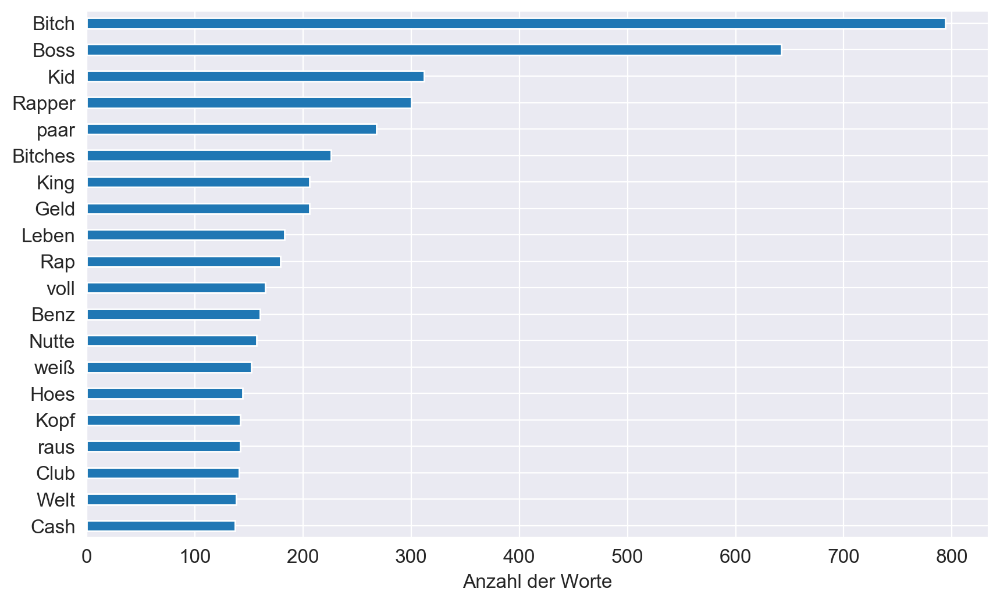

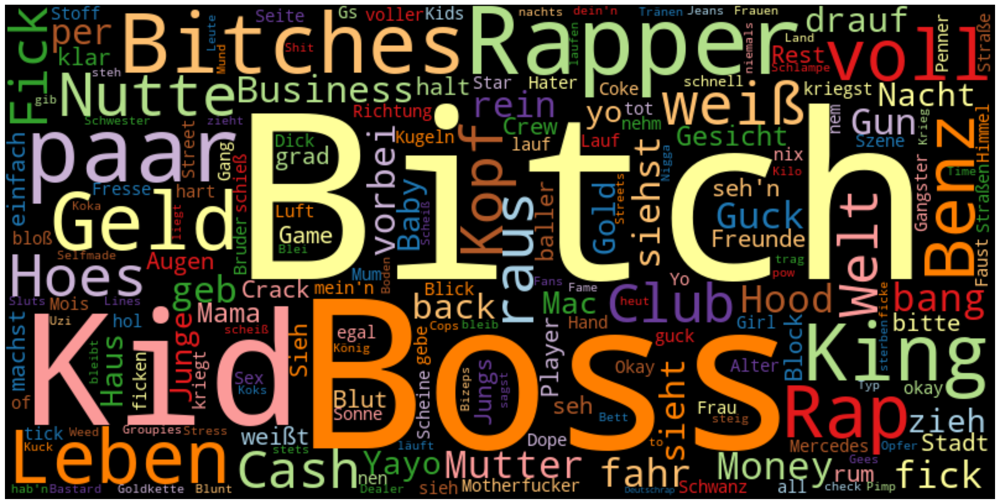

In [24]:
rapper = input("Von welchem Rapper möchten Sie die Worthäufigkeiten sehen? ")
cutout = genius_df[['title','song_text','artist']]
cutout = cutout[cutout['artist']==rapper]
tokens_per_rapper = []
_ = cutout['song_text'].map(lambda row: extract_tokens(row, tokens_per_rapper))
txa_plot(Counter([t for song in tokens_per_rapper for t in song if t.lower() not in stopwords and t not in rapper]).most_common(20))
txa_wordcloud(Counter([t for song in tokens_per_rapper for t in song if t.lower() not in stopwords and t not in rapper]))

# bekannte Rapper: Kollegah, Kontra K, RIN, Bushido, Shindy, Apache, Summer Cem, Shirin David, Prinz Pi, Capital Bra, Samra,
# Ufo361, Kool Savas, Sido, Marteria, Bausa, Haftbefehl, Capo, 187 Strassenbande, Mero, Eno, Kay One, Dardan, Loredana, 
# MoTrip, Eko Fresh, Fler, Juju, Casper, KC Rebell, Fettes Brot, Eno, RAF Camora, Cro, Manuellsen, Ali Bumaye, Ali As

### Worthäufigkeiten von Deutschrappern im Vergleich (ohne Stoppwerte)

In [25]:
from wordcloud import WordCloud

def topic_cloud(list_of_words, num_topic, n_top_words = 50, subplot=None):
    
    wc = WordCloud(width=400, height=200, background_color="black", colormap="Paired", max_words=n_top_words) 
    wc.generate_from_frequencies(Counter(list_of_words))

    if subplot:
        plt.subplot(*subplot)
    else:
        fig=plt.figure(figsize=(6, 3))
    plt.tight_layout(pad=0)
    plt.title(f"{num_topic}", size=20, y=1.05)
    plt.imshow(wc, interpolation='bilinear')
    plt.axis("off")

<Figure size 1200x1200 with 0 Axes>

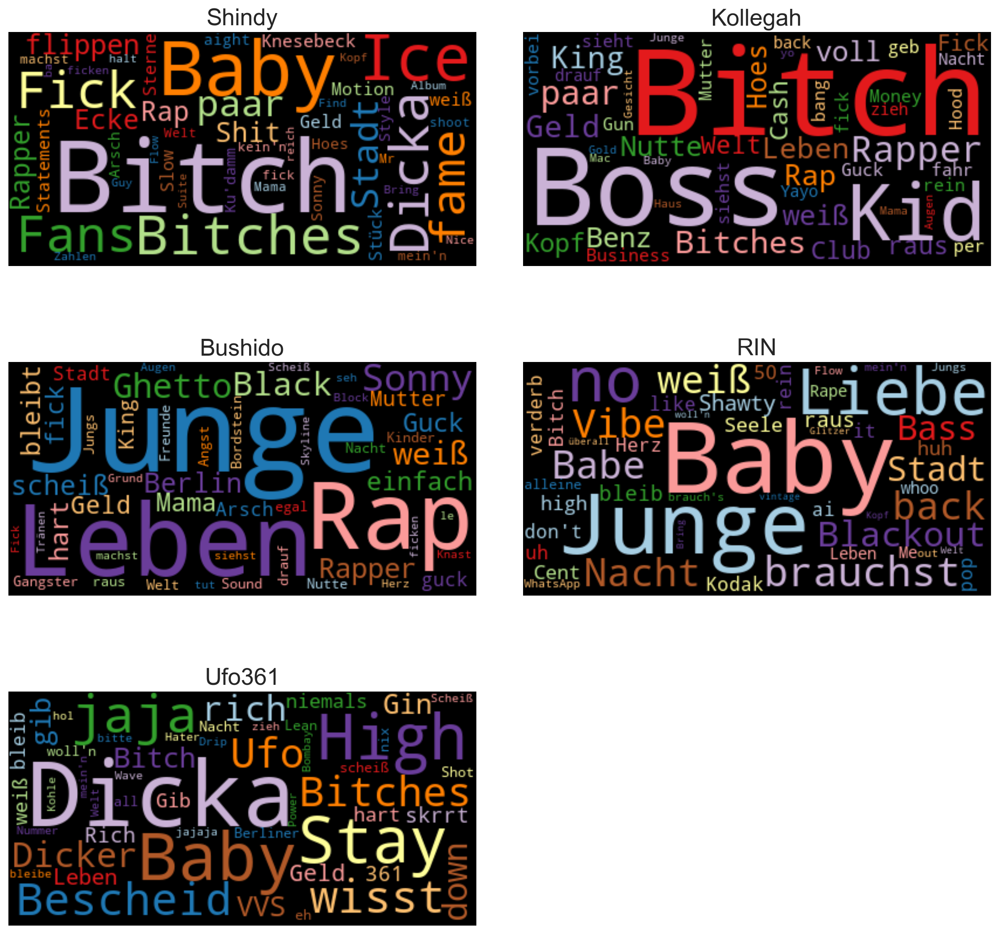

In [26]:
most_frequently = []

def frequency_finder(name):
    artists = genius_df['artist']
    tokens_rapper = []
    k = 0
    for a in artists:
        if (a == name):
            for t in songs_as_tokens[k]:
                tokens_rapper.append(t)
        k = k + 1
    most_frequently_rapper = [t for t in tokens_rapper if t.lower() not in stopwords and t != name]
    most_frequently.append((name, most_frequently_rapper))

frequency_finder('Shindy')
frequency_finder('Kollegah')
frequency_finder('Bushido')
frequency_finder('RIN')
frequency_finder('Ufo361')

num_topics = 5

n_cols = 2
n_rows = 3

plt.figure(figsize=(12,12))
for i in tqdm(range(0, num_topics)):
    subplot = (n_rows, n_cols, i+1)
    topic_cloud(most_frequently[i][1], most_frequently[i][0], subplot=subplot)
    
plt.subplots_adjust(hspace=0, wspace=0.1)

### Schimpfworthäufigkeiten pro Deutschrapper

Von welchem Rapper möchten Sie die Schimpfworthäufigkeiten sehen? Kollegah


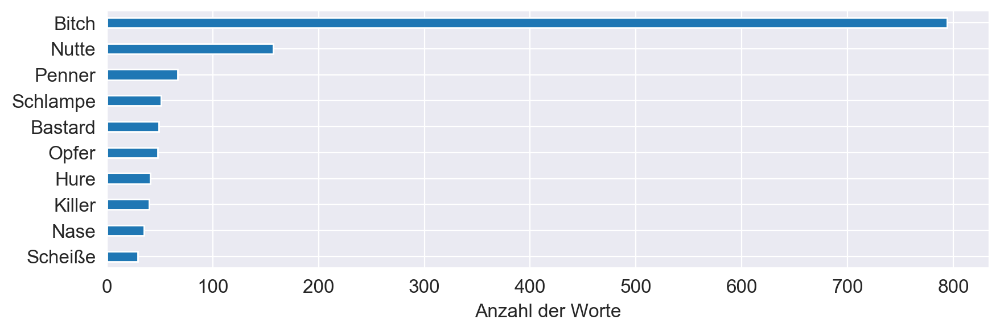

In [27]:
rapper = input("Von welchem Rapper möchten Sie die Schimpfworthäufigkeiten sehen? ")

cutout = genius_df[['title','song_text','artist']]
cutout = cutout[cutout['artist']==rapper]
tokens_per_rapper = []
_ = cutout['song_text'].map(lambda row: extract_tokens(row, tokens_per_rapper))
insult_frequency = [t for song in tokens_per_rapper for t in song if t in insult_list]
txa_plot(Counter(insult_frequency).most_common(10))

# bekannte Rapper: Kollegah, Kontra K, RIN, Bushido, Shindy, Apache, Summer Cem, Shirin David, Prinz Pi, Capital Bra, Samra,
# Ufo361, Kool Savas, Sido, Marteria, Bausa, Haftbefehl, Capo, 187 Strassenbande, Mero, Eno, Kay One, Dardan, Loredana, 
# MoTrip, Eko Fresh, Fler, Juju, Casper, KC Rebell, Fettes Brot, Eno, RAF Camora, Cro, Manuellsen, Ali Bumaye, Ali As

### Schimpfworthäufigkeiten im Deutschrap

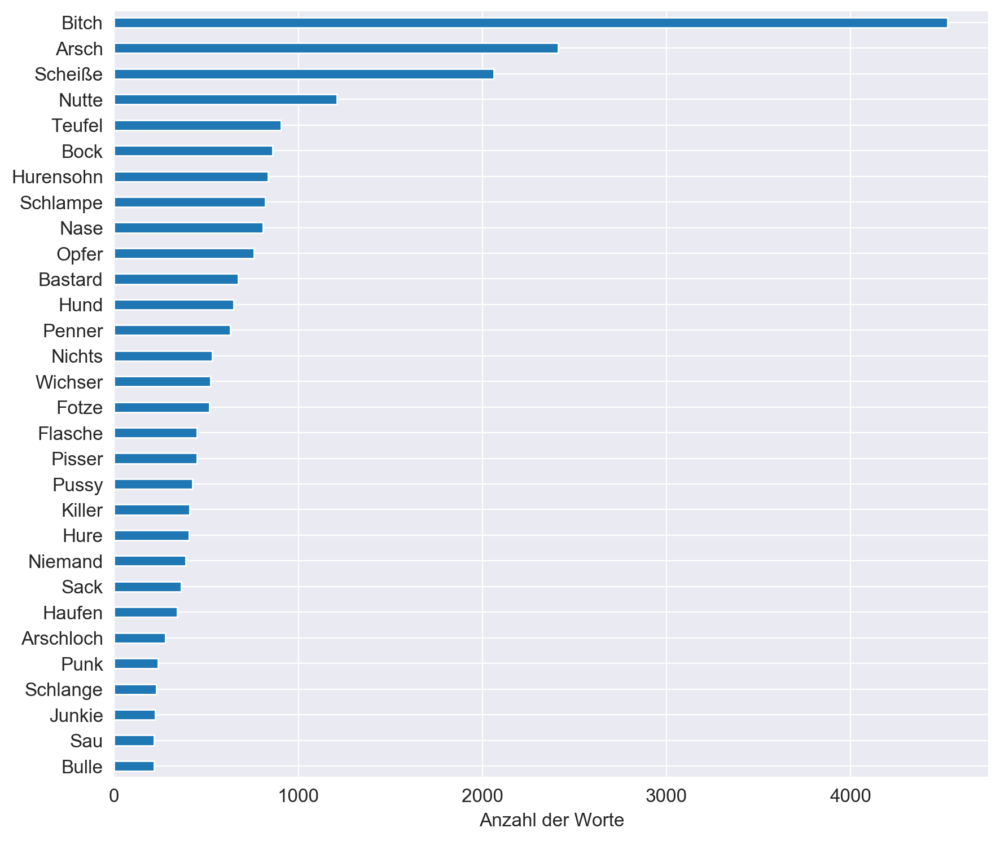

In [28]:
rap_insults = []
insult_count = 0
for song_t in songs_as_tokens:
    for t in song_t:
        if (t in insult_list):
            rap_insults.append(t)
            insult_count = insult_count + 1
txa_plot(Counter(rap_insults).most_common(30))

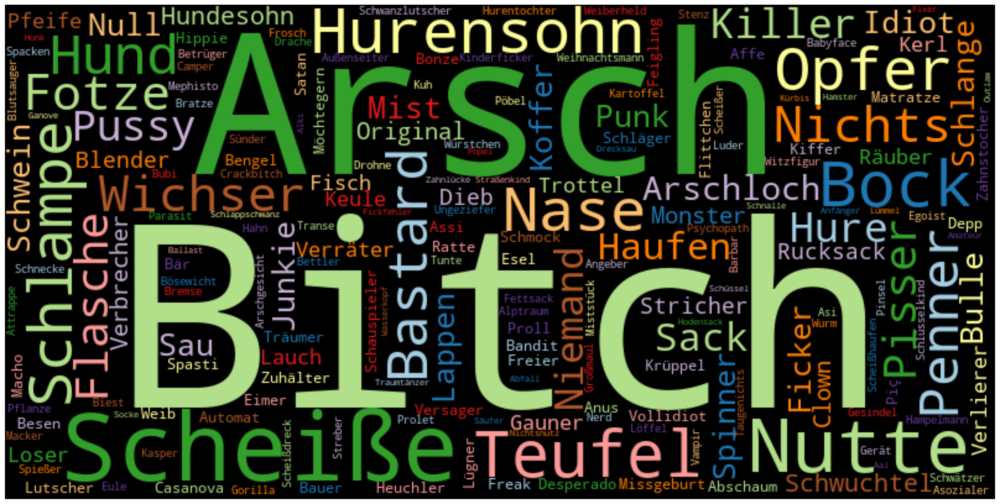

In [29]:
txa_wordcloud(rap_insults)

Der folgende Block gibt alle Schimpfwörter und den Song, in dem sie vorkommen, aus:

In [30]:
texts = genius_df['song_text']
artists = genius_df['artist']
titles = genius_df['title']

rap_insults = []
insult_count = 0
j = 0

for song_t in songs_as_tokens:
    for t in song_t:
        if (t in insult_list):
            print('%10s —— %s (%s)' % (t, titles[j], artists[j]))
            rap_insults.append(t)
            insult_count = insult_count + 1
    j = j + 1
print(insult_count)

      Nase —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
     Bitch —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
   Scheiße —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
     Opfer —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
     Arsch —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
 Hundesohn —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
      Nase —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
     Bitch —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
     Bitch —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
      Hund —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
    Penner —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
      Nase —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
     Bitch —— Chabos wissen wer der Babo ist (Remix) (Haftbefehl)
      Nase —— Chabos wissen wer der Babo ist (Haftbefehl)
     Bitch —— Chabos wissen wer der Babo ist (Haftbefehl)
     Opfer —— Chabos wisse

   Schmock —— 24h (Eno)
Schwuchtel —— 24h (Eno)
      Nase —— 24h (Eno)
    Pisser —— 24h (Eno)
   Blender —— Straßenabitur (Eno)
      Hund —— Straßenabitur (Eno)
     Fotze —— Rein raus (Eno)
Volksverräter —— Marionetten (Söhne Mannheims)
     Bauer —— Marionetten (Söhne Mannheims)
   Scheiße —— Ohrwurm (Eno)
   Scheiße —— Ohrwurm (Eno)
   Scheiße —— Ohrwurm (Eno)
   Scheiße —— Ohrwurm (Eno)
    Ficker —— Ohrwurm (Eno)
       Asi —— Ohrwurm (Eno)
   Scheiße —— Ohrwurm (Eno)
   Scheiße —— Ohrwurm (Eno)
   Scheiße —— Ohrwurm (Eno)
   Scheiße —— Ohrwurm (Eno)
     Arsch —— Ohrwurm (Eno)
   Scheiße —— Ohrwurm (Eno)
   Scheiße —— Ohrwurm (Eno)
   Scheiße —— Ohrwurm (Eno)
   Scheiße —— Ohrwurm (Eno)
     Arsch —— Human Centipede (Bushido)
     Nutte —— Human Centipede (Bushido)
 Hurensohn —— Human Centipede (Bushido)
     Nutte —— Human Centipede (Bushido)
     Nutte —— Human Centipede (Bushido)
     Clown —— Human Centipede (Bushido)
    Pfeife —— Human Centipede (Bushido)
 Hurensohn —— H

     Pöbel —— Megalomanie (A Cappella) (Bushido & Shindy)
     Pöbel —— Megalomanie (A Cappella) (Bushido & Shindy)
     Pöbel —— Megalomanie (A Cappella) (Bushido & Shindy)
     Pöbel —— Megalomanie (A Cappella) (Bushido & Shindy)
     Arsch —— G$D (A Cappella) (Bushido & Shindy)
     Bitch —— G$D (A Cappella) (Bushido & Shindy)
      Nase —— G$D (A Cappella) (Bushido & Shindy)
   Scheiße —— $ONN¥ (A Cappella) (Bushido & Shindy)
      Nase —— $ONN¥ (A Cappella) (Bushido & Shindy)
    Teufel —— $ONN¥ (A Cappella) (Bushido & Shindy)
   Scheiße —— $ONN¥ (A Cappella) (Bushido & Shindy)
   Scheiße —— $ONN¥ (A Cappella) (Bushido & Shindy)
Missgeburt —— $ONN¥ (A Cappella) (Bushido & Shindy)
 Hurensohn —— $ONN¥ (A Cappella) (Bushido & Shindy)
   Wichser —— $ONN¥ (A Cappella) (Bushido & Shindy)
     Fotze —— $ONN¥ (A Cappella) (Bushido & Shindy)
     Arsch —— Best Of (Kurdo)
Verbrecher —— Best Of (Kurdo)
Schwuchtel —— Best Of (Kurdo)
Verbrecher —— Best Of (Kurdo)
Schwuchtel —— Best Of (Kurdo)


    Junkie —— Donuts (Gzuz)
   Flasche —— Donuts (Gzuz)
    Teufel —— Was hat es gebracht (Gzuz)
   Flasche —— Was hat es gebracht (Gzuz)
  Schlampe —— Wie Gazi (Gzuz)
    Bandit —— Wie Gazi (Gzuz)
     Arsch —— Was ist jetzt (Gzuz)
  Schlampe —— Kopfnüsse (Gzuz)
 Vollidiot —— Kopfnüsse (Gzuz)
  Schlampe —— Loco (Gzuz)
   Flasche —— Loco (Gzuz)
   Niemand —— Loco (Gzuz)
  Schlampe —— Loco (Gzuz)
  Schlampe —— Loco (Gzuz)
     Arsch —— Gazozial (Gzuz)
 Asozialer —— Gazozial (Gzuz)
    Teufel —— Vor der Tür (Gzuz)
    Koffer —— Vor der Tür (Gzuz)
    Haufen —— Vor der Tür (Gzuz)
     Fotze —— Vor der Tür (Gzuz)
     Bulle —— Vor der Tür (Gzuz)
     Arsch —— Vor der Tür (Gzuz)
Neandertaler —— Vor der Tür (Gzuz)
     Fotze —— Vor der Tür (Gzuz)
     Idiot —— Niemals satt (Gzuz)
   Niemand —— Was erlebt (Gzuz)
   Niemand —— Was erlebt (Gzuz)
   Niemand —— Was erlebt (Gzuz)
   Niemand —— Was erlebt (Gzuz)
    Teufel —— Diskutieren?! (Gzuz)
Verbrecher —— Träume (Gzuz)
    Teufel —— Träume (Gz

   Wichser —— Täterprofil (187 Strassenbande)
    Pisser —— Täterprofil (187 Strassenbande)
   Wichser —— Täterprofil (187 Strassenbande)
     Opfer —— Täterprofil (187 Strassenbande)
   Scheiße —— Bis jetzt alles cool (187 Strassenbande)
Bauernsohn —— Bis jetzt alles cool (187 Strassenbande)
     Pussy —— Bis jetzt alles cool (187 Strassenbande)
     Ratte —— Bis jetzt alles cool (187 Strassenbande)
    Drohne —— Sampler 4 (Snippet) (187 Strassenbande)
      Nase —— Sampler 4 (Snippet) (187 Strassenbande)
     Arsch —— Sampler 4 (Snippet) (187 Strassenbande)
    Junkie —— Sampler 4 (Snippet) (187 Strassenbande)
    Bandit —— Sampler 4 (Snippet) (187 Strassenbande)
  Schlampe —— Sampler 4 (Snippet) (187 Strassenbande)
     Pussy —— Sampler 4 (Snippet) (187 Strassenbande)
      Bock —— Sampler 4 (Snippet) (187 Strassenbande)
     Arsch —— Lächeln (187 Strassenbande)
      Hure —— Mit Absicht (187 Strassenbande)
Schlachtschiff —— Mit Absicht (187 Strassenbande)
    Lappen —— Mit Absicht 

     Clown —— Koch, Koch! (LX & Maxwell)
     Bitch —— Koch, Koch! (LX & Maxwell)
    Teufel —— Koch, Koch! (LX & Maxwell)
    Teufel —— Koch, Koch! (LX & Maxwell)
     Socke —— Lass die Sonne rein (LX & Maxwell)
Verbrecher —— Salz & Pfeffer (LX & Maxwell)
      Hund —— Salz & Pfeffer (LX & Maxwell)
Verbrecher —— Salz & Pfeffer (LX & Maxwell)
Verbrecher —— Salz & Pfeffer (LX & Maxwell)
      Hure —— Sitzen auf Chrom (LX & Maxwell)
 Hodensack —— Sitzen auf Chrom (LX & Maxwell)
     Fotze —— Sitzen auf Chrom (LX & Maxwell)
      Bubi —— Sitzen auf Chrom (LX & Maxwell)
 Hurensohn —— Sitzen auf Chrom (LX & Maxwell)
     Bitch —— ML (LX & Maxwell)
    Koffer —— ML (LX & Maxwell)
      Bock —— ML (LX & Maxwell)
 Hundesohn —— ML (LX & Maxwell)
      Hund —— Jeden Tag (LX & Maxwell)
     Arsch —— Jeden Tag (LX & Maxwell)
     Luder —— Jeden Tag (LX & Maxwell)
    Haufen —— Farbe ins Spiel (LX & Maxwell)
   Flasche —— Farbe ins Spiel (LX & Maxwell)
      Affe —— Farbe ins Spiel (LX & Maxwell)
 

     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Bitch —— Leck Sibbi (Nimo)
     Pussy —— Weil ein Adler nicht mit Tauben fliegt (Nimo)
 Hurensohn —

      Nase —— Nach wie vor (187 Strassenbande)
     Bonze —— Hauptschülerrap (187 Strassenbande)
      Nase —— Platz da! (187 Strassenbande)
 Kartoffel —— Platz da! (187 Strassenbande)
     Nutte —— Platz da! (187 Strassenbande)
     Arsch —— Platz da! (187 Strassenbande)
   Bastard —— Platz da! (187 Strassenbande)
   Krüppel —— Platz da! (187 Strassenbande)
   Bastard —— Platz da! (187 Strassenbande)
     Pussy —— Platz da! (187 Strassenbande)
     Arsch —— Platz da! (187 Strassenbande)
     Bitch —— Platz da! (187 Strassenbande)
   Bastard —— Platz da! (187 Strassenbande)
   Bastard —— Platz da! (187 Strassenbande)
   Krüppel —— Platz da! (187 Strassenbande)
   Bastard —— Platz da! (187 Strassenbande)
   Flasche —— Heut is Party (187 Strassenbande)
     Arsch —— Heut is Party (187 Strassenbande)
     Arsch —— Das Gangsta (187 Strassenbande)
      Nase —— Das Gangsta (187 Strassenbande)
    Ficker —— Stolz Deutsch (187 Strassenbande)
    Ficker —— Stolz Deutsch (187 Strassenbande)
   

  Verräter —— Was sie Wollen (RAF Camora)
  Verräter —— Was sie Wollen (RAF Camora)
   Niemand —— Was sie Wollen (RAF Camora)
   Bastard —— Was sie Wollen (RAF Camora)
    Koffer —— Benzin (Olexesh)
  Schlampe —— Benzin (Olexesh)
     Arsch —— Benzin (Olexesh)
      Nase —— Benzin (Olexesh)
      Bock —— Benzin (Olexesh)
    Teufel —— Feuer (Olexesh)
    Teufel —— Feuer (Olexesh)
    Teufel —— Feuer (Olexesh)
    Teufel —— Feuer (Olexesh)
    Teufel —— Feuer (Olexesh)
    Teufel —— Feuer (Olexesh)
   Träumer —— Mein Herz brennt (Cover) (RAF Camora)
   Parasit —— Es (RAF Camora)
     Arsch —— Weg (RAF Camora)
     Opfer —— Weg (RAF Camora)
   Flasche —— Champion (RAF Camora)
   Niemand —— Wenn ich will (RAF Camora)
      Punk —— Wenn ich will (RAF Camora)
Verbrecher —— Wenn ich will (RAF Camora)
   Schmock —— Schick Kunden drauf (Olexesh)
      Dieb —— Schick Kunden drauf (Olexesh)
Waschlappen —— Schick Kunden drauf (Olexesh)
     Loser —— Neuer Sheriff in der Stadt (Olexesh)
    Killer

 Miststück —— Hundeblick (Olexesh)
      Hund —— Hundeblick (Olexesh)
      Hure —— Hundeblick (Olexesh)
      Sack —— Bugs & Bunnies (Olexesh)
    Junkie —— Bugs & Bunnies (Olexesh)
   Scheiße —— Alles für dich (Olexesh)
      Sack —— Ich mach das (Olexesh)
   Scheiße —— Ich mach das (Olexesh)
     Besen —— Ich mach das (Olexesh)
     Arsch —— Drunken Masta (Olexesh)
  Schlampe —— Moonwalk (Olexesh)
      Depp —— Moonwalk (Olexesh)
Hurentochter —— Moonwalk (Olexesh)
  Schlampe —— Moonwalk (Olexesh)
  Schlampe —— Moonwalk (Olexesh)
 Hurensohn —— Weyauu (Olexesh)
  Schüssel —— Weyauu (Olexesh)
      Bock —— Weyauu (Olexesh)
    Haufen —— Mutprobe (Olexesh)
     Besen —— Buyaka (Olexesh)
Missgeburt —— Buyaka (Olexesh)
      Bock —— 64 Kammern (Olexesh)
   Scheiße —— 64 Kammern (Olexesh)
  Stricher —— 64 Kammern (Olexesh)
      Bock —— 64 Kammern (Olexesh)
     Bulle —— 64 Kammern (Olexesh)
     Ratte —— 64 Kammern (Olexesh)
    Nichts —— Blickwinkel (Olexesh)
    Nichts —— Blickwinkel (O

     Proll —— Beeef Beeef Beeef (RAF Camora)
    Penner —— Beeef Beeef Beeef (RAF Camora)
   Bastard —— Ruhe vor dem  Sturm 2007 (RAF Camora)
   Bastard —— Ruhe vor dem  Sturm 2007 (RAF Camora)
   Bastard —— 2008 (RAF Camora)
       Bär —— 2008 (RAF Camora)
     Opfer —— 2008 (RAF Camora)
 Verlierer —— Game ist ein Hund (RAF Camora)
      Bock —— Game ist ein Hund (RAF Camora)
   Träumer —— Game ist ein Hund (RAF Camora)
      Hund —— Game ist ein Hund (RAF Camora)
    Dackel —— Game ist ein Hund (RAF Camora)
     Fisch —— Game ist ein Hund (RAF Camora)
      Bock —— Missgunst (RAF Camora)
   Bastard —— Missgunst (RAF Camora)
     Opfer —— Puta Madre (RAF Camora)
       Piç —— Puta Madre (RAF Camora)
Scheißdreck —— Wilson X (RAF Camora)
Scheißdreck —— Wilson X (RAF Camora)
   Spießer —— Mein Croko ist Hipster (RAF Camora)
     Satan —— Rabe (RAF Camora)
    Teufel —— Rabe (RAF Camora)
    Penner —— Spaceman (RAF Camora)
    Teufel —— Fickt euch (RAF Camora)
   Bastard —— Fickt euch (RA

  Rucksack —— Winner (RAF Camora)
     Arsch —— Yo (RAF Camora)
     Fisch —— Yo (RAF Camora)
  Schlampe —— 3 Mal (RAF Camora)
     Arsch —— 3 Mal (RAF Camora)
 Hundesohn —— Machinegunflows (SpongeBOZZ)
  Stricher —— Machinegunflows (SpongeBOZZ)
     Pussy —— Machinegunflows (SpongeBOZZ)
   Streber —— Machinegunflows (SpongeBOZZ)
   Blender —— Machinegunflows (SpongeBOZZ)
     Bitch —— El Chapo (SpongeBOZZ)
  Stricher —— El Chapo (SpongeBOZZ)
     Ratte —— El Chapo (SpongeBOZZ)
 Hundesohn —— El Chapo (SpongeBOZZ)
     Bitch —— El Chapo (SpongeBOZZ)
     Nutte —— El Chapo (SpongeBOZZ)
     Opfer —— El Chapo (SpongeBOZZ)
    Killer —— El Chapo (SpongeBOZZ)
     Nutte —— El Chapo (SpongeBOZZ)
Rattenfänger —— El Chapo (SpongeBOZZ)
    Teufel —— Gewarnt (RAF Camora)
     Opfer —— Flex (RAF Camora)
  Stricher —— Bikini Bottom Gangster II (SpongeBOZZ)
     Bitch —— Bikini Bottom Gangster II (SpongeBOZZ)
      Bock —— Bin weg (RAF Camora)
    Nichts —— Bin weg (RAF Camora)
     Nutte —— 1%er (

   Trottel —— Scheiß auf eure Party (Ufo361)
    Lügner —— Scheiß auf eure Party (Ufo361)
   Träumer —— Eloah (Sun Diego)
      Hund —— Sieh es endlich ein (KC Rebell)
   Pflanze —— Wölfe (Kontra K)
     Fotze —— Kopf schrott (Azet)
    Bandit —— Kopf schrott (Azet)
     Arsch —— Kopf schrott (Azet)
   Scheiße —— Kopf schrott (Azet)
      Nase —— Vallah (Azet)
    Teufel —— So wie du (Azet)
    Teufel —— So wie du (Azet)
Verbrecher —— Wir gehn ab (AK Ausserkontrolle)
   Bastard —— Wir gehn ab (AK Ausserkontrolle)
   Spinner —— Das Rennen* (RIN)
Verbrecher —— 2 Minuten (AK Ausserkontrolle)
    Bengel —— Flexscheibe (AK Ausserkontrolle)
      Nase —— Flexscheibe (AK Ausserkontrolle)
  Original —— Original (Zuna)
  Original —— Original (Zuna)
  Original —— Original (Zuna)
  Original —— Original (Zuna)
  Original —— Original (Zuna)
  Original —— Original (Zuna)
  Original —— Original (Zuna)
  Original —— Original (Zuna)
Missgeburt —— Raw (Sun Diego)
Missgeburt —— Raw (Sun Diego)
     Nutte

     Freak —— Bang Bang (Ufo361)
   Scheiße —— Bang Bang (Ufo361)
     Biest —— Bang Bang (Ufo361)
    Kiffer —— Bitches wollen (Ufo361)
    Teufel —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Pussy —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Arsch —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Bitch —— Bitches wollen (Ufo361)
     Arsch —— Bleib auf dem Teppich (Ufo361)
      Hund —— Bleib auf dem Teppich (Ufo361)
      Bock —— Bleib auf dem Teppich (Ufo361)
     Arsch —— Bleib auf dem Teppich (Ufo361)
 Verlierer —— Bleib auf dem Teppich (Ufo361)
    Spasti —— Bleib auf dem Te

 Hundesohn —— Rauch rein (Summer Cem)
     Arsch —— Rauch rein (Summer Cem)
     Bitch —— Rauch rein (Summer Cem)
   Scheiße —— Rauch rein (Summer Cem)
     Opfer —— Was du denkst (Summer Cem)
     Bitch —— Was du denkst (Summer Cem)
   Scheiße —— Was weißt du davon (Summer Cem)
      Sack —— Wärst du doch geblieben (Summer Cem)
       Asi —— Wärst du doch geblieben (Summer Cem)
   Scheiße —— Wenn das alles ist (Summer Cem)
 Hundesohn —— Wenn das alles ist (Summer Cem)
     Bitch —— Wolke 7 (Summer Cem)
      Esel —— Wolke 7 (Summer Cem)
     Proll —— Wolke 7 (Summer Cem)
     Proll —— Wolke 7 (Summer Cem)
     Bitch —— Bitte Spitte Cocaina (Summer Cem)
     Bitch —— Bitte Spitte Cocaina (Summer Cem)
     Nutte —— Bitte Spitte Cocaina (Summer Cem)
      Dieb —— Bitte Spitte Cocaina (Summer Cem)
     Arsch —— Bitte Spitte Cocaina (Summer Cem)
    Spasti —— Pink Floyd (Summer Cem)
     Arsch —— Es war Cem (Summer Cem)
   Flasche —— Nicht komplett (Summer Cem)
  Original —— Nicht komplett

 Zerstörer —— Der letzte Tag deines Lebens (Farid Bang)
Schwuchtel —— Der letzte Tag deines Lebens (Farid Bang)
    Transe —— Der letzte Tag deines Lebens (Farid Bang)
     Bitch —— Der letzte Tag deines Lebens (Farid Bang)
  Zuhälter —— Der letzte Tag deines Lebens (Farid Bang)
 Zerstörer —— Der letzte Tag deines Lebens (Farid Bang)
  Stricher —— Der letzte Tag deines Lebens (Farid Bang)
     Bitch —— Der letzte Tag deines Lebens (Farid Bang)
   Wichser —— Der letzte Tag deines Lebens (Farid Bang)
 Zerstörer —— Der letzte Tag deines Lebens (Farid Bang)
     Nutte —— Farid Bang (2012) (Farid Bang)
    Junkie —— Farid Bang (2012) (Farid Bang)
       Asi —— Farid Bang (2012) (Farid Bang)
      Assi —— Farid Bang (2012) (Farid Bang)
  Stricher —— Farid Bang (2012) (Farid Bang)
     Bulle —— Farid Bang (2012) (Farid Bang)
Möchtegern —— Farid Bang (2012) (Farid Bang)
    Penner —— Farid Bang (2012) (Farid Bang)
    Penner —— Farid Bang (2012) (Farid Bang)
      Kerl —— Farid Bang (2012) (Fa

    Penner —— Ey Yo (Farid Bang)
Armleuchter —— Ey Yo (Farid Bang)
 Hundesohn —— Ey Yo (Farid Bang)
    Spasti —— Ey Yo (Farid Bang)
    Penner —— Ey Yo (Farid Bang)
     Clown —— Ey Yo (Farid Bang)
      Nase —— Ey Yo (Farid Bang)
      Affe —— Ey Yo (Farid Bang)
    Penner —— Ey Yo (Farid Bang)
  Rucksack —— Ey Yo (Farid Bang)
     Bitch —— Ey Yo (Farid Bang)
     Bitch —— Ey Yo (Farid Bang)
     Bitch —— Ey Yo (Farid Bang)
      Hure —— Ey Yo (Farid Bang)
      Hahn —— Ey Yo (Farid Bang)
Schwanzlutscher —— Klick Klick Boom (Farid Bang)
 Arschloch —— Klick Klick Boom (Farid Bang)
Missgeburt —— Klick Klick Boom (Farid Bang)
     Arsch —— Klick Klick Boom (Farid Bang)
   Scheiße —— Klick Klick Boom (Farid Bang)
     Tunte —— Klick Klick Boom (Farid Bang)
Gartenzwerg —— Klick Klick Boom (Farid Bang)
     Fisch —— Klick Klick Boom (Farid Bang)
     Arsch —— Klick Klick Boom (Farid Bang)
     Arsch —— Klick Klick Boom (Farid Bang)
     Arsch —— Klick Klick Boom (Farid Bang)
 Arschloch —— 

   Angeber —— Johnny Fontaine (Farid Bang)
  Schläger —— Johnny Fontaine (Farid Bang)
     Opfer —— Johnny Fontaine (Farid Bang)
     Opfer —— Johnny Fontaine (Farid Bang)
     Bitch —— Johnny Fontaine (Farid Bang)
     Bitch —— Johnny Fontaine (Farid Bang)
      Kerl —— Dreh’ die Zeit zurück (Farid Bang)
    Teufel —— Dreh’ die Zeit zurück (Farid Bang)
  Lutscher —— Tag der Abrechnung (Farid Bang)
     Arsch —— Tag der Abrechnung (Farid Bang)
 Glatzkopf —— Tag der Abrechnung (Farid Bang)
 Hurensohn —— Tag der Abrechnung (Farid Bang)
    Penner —— Tag der Abrechnung (Farid Bang)
  Rucksack —— Tag der Abrechnung (Farid Bang)
 Asozialer —— Asozialer Marokkaner (Farid Bang)
    Nichts —— Asozialer Marokkaner (Farid Bang)
Missgeburt —— Asozialer Marokkaner (Farid Bang)
     Fotze —— Asozialer Marokkaner (Farid Bang)
 Hurensohn —— Asozialer Marokkaner (Farid Bang)
     Bonze —— Willkommen auf der Kö (Farid Bang)
    Lappen —— Willkommen auf der Kö (Farid Bang)
Arschgesicht —— Willkommen auf

 Arschloch —— Arschloch (Farid Bang)
   Schwein —— Arschloch (Farid Bang)
 Arschloch —— Arschloch (Farid Bang)
 Arschloch —— Arschloch (Farid Bang)
   Schwein —— Arschloch (Farid Bang)
 Arschloch —— Arschloch (Farid Bang)
      Hure —— 40 Kugeln (Farid Bang)
Massenmörder —— 40 Kugeln (Farid Bang)
 Hurensohn —— 40 Kugeln (Farid Bang)
 Desperado —— 40 Kugeln (Farid Bang)
 Hurensohn —— 40 Kugeln (Farid Bang)
     Satan —— 40 Kugeln (Farid Bang)
    Säufer —— 40 Kugeln (Farid Bang)
Neureicher —— 40 Kugeln (Farid Bang)
   Wichser —— 40 Kugeln (Farid Bang)
    Teufel —— Nach oben (Farid Bang)
   Niemand —— Nach oben (Farid Bang)
   Wichser —— Nach oben (Farid Bang)
   Scheiße —— Nach oben (Farid Bang)
   Scheiße —— Blut auf dem Asphalt (Farid Bang)
     Fotze —— Blut auf dem Asphalt (Farid Bang)
    Kasper —— Blut auf dem Asphalt (Farid Bang)
  Zuhälter —— Blut auf dem Asphalt (Farid Bang)
      Hure —— Blut auf dem Asphalt (Farid Bang)
   Bastard —— Blut auf dem Asphalt (Farid Bang)
 Hurens

    Lappen —— Nobody (Sun Diego)
Schlappschwanz —— Nobody (Sun Diego)
     Lauch —— Nobody (Sun Diego)
   Bastard —— Nobody (Sun Diego)
Schlappschwanz —— Nobody (Sun Diego)
     Lauch —— Nobody (Sun Diego)
   Bastard —— Nobody (Sun Diego)
  Stricher —— Nobody (Sun Diego)
Missgeburt —— Nobody (Sun Diego)
     Lauch —— Nobody (Sun Diego)
   Wichser —— Nobody (Sun Diego)
Schwuchtel —— Nobody (Sun Diego)
   Bastard —— Nobody (Sun Diego)
     Bitch —— Nobody (Sun Diego)
     Bitch —— Nobody (Sun Diego)
      Nase —— Nobody (Sun Diego)
     Pussy —— Nobody (Sun Diego)
     Bitch —— Nobody (Sun Diego)
    Penner —— Nobody (Sun Diego)
 Hundesohn —— Nobody (Sun Diego)
Schlappschwanz —— Nobody (Sun Diego)
     Lauch —— Nobody (Sun Diego)
   Bastard —— Nobody (Sun Diego)
Schlappschwanz —— Nobody (Sun Diego)
     Lauch —— Nobody (Sun Diego)
   Bastard —— Nobody (Sun Diego)
  Stricher —— Nobody (Sun Diego)
Missgeburt —— Nobody (Sun Diego)
   Wichser —— Nobody (Sun Diego)
      Hund —— Brenn den Clu

      Nase —— Eliantte (Ufo361)
   Flasche —— Rich Rich (Ufo361)
     Satan —— Rich Rich (Ufo361)
     Bitch —— Was du reydest!? (Ufo361)
     Bitch —— Was du reydest!? (Ufo361)
      Hund —— 1988 (Ufo361)
     Bitch —— 1988 (Ufo361)
     Bitch —— 1988 (Ufo361)
     Bitch —— 1988 (Ufo361)
 Flittchen —— Drumloop (Ufo361)
     Bitch —— Drumloop (Ufo361)
    Pisser —— Drumloop (Ufo361)
     Bitch —— Drumloop (Ufo361)
 Flittchen —— Drumloop (Ufo361)
     Bitch —— Döörty (Ufo361)
Langfinger —— Döörty (Ufo361)
    Penner —— Brett (Ufo361)
     Besen —— Brett (Ufo361)
     Opfer —— Brett (Ufo361)
     Bitch —— Brett (Ufo361)
     Besen —— Brett (Ufo361)
     Bitch —— HipHop (Ufo361)
    Nichts —— Seit dem ersten Tag (Ufo361)
   Scheiße —— Seit dem ersten Tag (Ufo361)
    Kiffer —— GanjaBoi (Ufo361)
    Nichts —— GanjaBoi (Ufo361)
   Spießer —— Hausparty (Ufo361)
     Nutte —— Hausparty (Ufo361)
     Bitch —— Hausparty (Ufo361)
      Nerd —— Hausparty (Ufo361)
     Bitch —— Atom (Ufo361)
  Fet

    Pisser —— 100 (Summer Cem)
    Penner —— 100 (Summer Cem)
    Prolet —— 100 (Summer Cem)
     Bitch —— AG Turbo (Summer Cem)
     Bitch —— AG Turbo (Summer Cem)
    Killer —— AG Turbo (Summer Cem)
    Penner —— AG Turbo (Summer Cem)
      Bock —— AG Turbo (Summer Cem)
      Eule —— AG Turbo (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
    Macker —— Kopf hoch Bitch (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
    Macker —— Kopf hoch Bitch (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
     Bitch —— Kopf hoch Bitch (Summer Cem)
    Macker —— Kopf hoch Bitch (Summer Cem)
      Hund —— Kopf hoch Bitch (Summer Cem)
   

    Haufen —— Ohne Ausnahme (AK Ausserkontrolle)
   Scheiße —— Ohne Ausnahme (AK Ausserkontrolle)
   Scheiße —— Realer gehts nicht (AK Ausserkontrolle)
     Arsch —— Realer gehts nicht (AK Ausserkontrolle)
   Scheiße —— District (AK Ausserkontrolle)
      Hure —— Lafayette (AK Ausserkontrolle)
      Bock —— Lafayette (AK Ausserkontrolle)
     Nutte —— Lafayette (AK Ausserkontrolle)
     Nutte —— Lafayette (AK Ausserkontrolle)
     Pussy —— Lafayette (AK Ausserkontrolle)
   Bastard —— Lafayette (AK Ausserkontrolle)
     Bitch —— Koka (Azet)
     Bitch —— Koka (Azet)
     Bitch —— Koka (Azet)
     Bitch —— Koka (Azet)
     Bitch —— Koka (Azet)
     Bitch —— Koka (Azet)
     Arsch —— Koka (Azet)
  Verräter —— Kriminell (Zuna)
     Arsch —— Kriminell (Zuna)
     Bitch —— Kriminell (Zuna)
      Nase —— Kriminell (Zuna)
   Automat —— Kriminell (Zuna)
     Fotze —— Überall (Zuna)
 Hurensohn —— Überall (Zuna)
    Nichts —— Überall (Zuna)
   Wichser —— Überall (Zuna)
   Automat —— Überall (Zuna

   Scheiße —— Wo sie scheitern (Kontra K)
   Scheiße —— Wo sie scheitern (Kontra K)
    Teufel —— Wo sie scheitern (Kontra K)
  Heuchler —— Wo sie scheitern (Kontra K)
   Scheiße —— Wo sie scheitern (Kontra K)
   Scheiße —— Soldaten (Kontra K)
     Arsch —— Soldaten (Kontra K)
    Räuber —— Skimaske (Kontra K)
   Bastard —— Skimaske (Kontra K)
    Räuber —— Skimaske (Kontra K)
  Gesindel —— Skimaske (Kontra K)
    Räuber —— Skimaske (Kontra K)
      Bock —— Atme den Regen (Video Edit) (Kontra K)
     Proll —— Ehrensache (Bonustrack) (Kontra K)
     Arsch —— Ehrensache (Bonustrack) (Kontra K)
    Ficker —— Ehrensache (Bonustrack) (Kontra K)
      Hund —— Pumpgun (Kontra K)
      Hund —— Pumpgun (Kontra K)
Scheißhaufen —— Pumpgun (Kontra K)
Blindgänger —— Pumpgun (Kontra K)
    Nichts —— Pumpgun (Kontra K)
Crackbitch —— Pumpgun (Kontra K)
      Sack —— Pumpgun (Kontra K)
      Hure —— Pumpgun (Kontra K)
  Schlampe —— Danke (Kontra K)
     Fotze —— Danke (Kontra K)
      Hure —— Danke (Ko

    Teufel —— 2 Seelen (Kontra K)
    Teufel —— Gute Nacht (Kontra K)
    Teufel —— Power (Kontra K)
  Schlange —— Hände weg (Kontra K)
     Fisch —— Hände weg (Kontra K)
  Abschaum —— Diamanten (Kontra K)
   Scheiße —— Betonwüste (Kontra K)
    Teufel —— Betonwüste (Kontra K)
     Ratte —— Ratte (Kontra K)
      Hund —— Ratte (Kontra K)
      Hund —— Ratte (Kontra K)
     Ratte —— Ratte (Kontra K)
     Clown —— Diemak (Kontra K)
     Clown —— Diemak (Kontra K)
   Scheiße —— Diemak (Kontra K)
     Clown —— Diemak (Kontra K)
     Clown —— Diemak (Kontra K)
    Egoist —— Nur noch eine Kugel (Kontra K)
    Teufel —— Nur noch eine Kugel (Kontra K)
   Bastard —— Nur noch eine Kugel (Kontra K)
    Nichts —— Nur noch eine Kugel (Kontra K)
    Teufel —— Hoch (Kontra K)
   Wichser —— Hoch (Kontra K)
    Teufel —— Hoch (Kontra K)
   Wichser —— Courage (Kontra K)
    Teufel —— Courage (Kontra K)
   Wichser —— Courage (Kontra K)
   Wichser —— Courage (Kontra K)
    Abfall —— Courage (Kontra K)
   

     Opfer —— Endlich erwachsen (Kontra K)
   Scheiße —— Endlich erwachsen (Kontra K)
     Opfer —— Endlich erwachsen (Kontra K)
      Hund —— Endlich erwachsen (Kontra K)
     Arsch —— Endlich erwachsen (Kontra K)
      Nase —— Endlich erwachsen (Kontra K)
    Teufel —— Endlich erwachsen (Kontra K)
      Nase —— Endlich erwachsen (Kontra K)
     Opfer —— Augen im Rücken (Kontra K)
    Haufen —— Augen im Rücken (Kontra K)
   Scheiße —— Augen im Rücken (Kontra K)
      Hure —— Augen im Rücken (Kontra K)
   Scheiße —— Wieder ein Tag (Kontra K)
    Ficker —— Wieder ein Tag (Kontra K)
   Bastard —— Wieder ein Tag (Kontra K)
    Junkie —— Wieder ein Tag (Kontra K)
     Opfer —— Andere machen Mukke, wir machen Ernst (Kontra K)
     Ratte —— Zeit (Kontra K)
   Bastard —— Ein Atemzug (Kontra K)
   Scheiße —— Ein Atemzug (Kontra K)
   Wichser —— Ein Atemzug (Kontra K)
     Opfer —— Ein Atemzug (Kontra K)
     Bitch —— Mein Revier (Kontra K)
    Haufen —— Mein Revier (Kontra K)
     Bitch —— Mei

    Penner —— Nullkommaeins (SSIO)
Hackfresse —— Nullkommaeins (SSIO)
    Penner —— Nullkommaeins (SSIO)
     Opfer —— Nullkommaeins (SSIO)
    Penner —— Nullkommaeins (SSIO)
       Bär —— Nullkommaeins (SSIO)
    Penner —— Nullkommaeins (SSIO)
     Nutte —— Don & Fuß (SSIO)
  Rucksack —— Don & Fuß (SSIO)
  Rucksack —— Don & Fuß (SSIO)
      Dieb —— Don & Fuß (SSIO)
Hungerhaken —— Bitte keine Anzeige machen (SSIO)
 Zahnlücke —— Lockige Brusthaare (SSIO)
    Lügner —— Lockige Brusthaare (SSIO)
     Nutte —— GoPro (SSIO)
Arschfotze —— GoPro (SSIO)
     Arsch —— GoPro (SSIO)
     Arsch —— GoPro (SSIO)
  Schnecke —— GoPro (SSIO)
      Bock —— Kein Bock (SSIO)
    Pisser —— Kein Bock (SSIO)
      Bock —— Kein Bock (SSIO)
  Zuhälter —— Kein Bock (SSIO)
    Junkie —— Kein Bock (SSIO)
      Bock —— Kein Bock (SSIO)
      Bock —— Kein Bock (SSIO)
      Bock —— Kein Bock (SSIO)
      Bock —— Kein Bock (SSIO)
      Bock —— Kein Bock (SSIO)
      Bock —— Kein Bock (SSIO)
      Bock —— Kein Bock (S

     Arsch —— Bankster (AK Ausserkontrolle)
      Nase —— Bankster (AK Ausserkontrolle)
 Hurensohn —— Wenns drauf ankommt (AK Ausserkontrolle)
 Hurensohn —— Wenns drauf ankommt (AK Ausserkontrolle)
 Hurensohn —— Wenns drauf ankommt (AK Ausserkontrolle)
     Nutte —— Full Time Hustler (AK Ausserkontrolle)
     Nutte —— Full Time Hustler (AK Ausserkontrolle)
     Nutte —— Full Time Hustler (AK Ausserkontrolle)
     Nutte —— Full Time Hustler (AK Ausserkontrolle)
Halsabschneider —— Dahab (AK Ausserkontrolle)
    Killer —— Dahab (AK Ausserkontrolle)
      Nase —— Wer weiß (Alligatoah)
 Hurensohn —— Wer weiß (Alligatoah)
    Haufen —— Omega (Kollegah)
      Punk —— Omega (Kollegah)
    Penner —— Omega (Kollegah)
      Nase —— Omega (Kollegah)
   Scheiße —— JAJA (Fero47)
   Scheiße —— JAJA (Fero47)
   Scheiße —— JAJA (Fero47)
  Mephisto —— Safari (Maxwell 187)
  Mephisto —— Safari (Maxwell 187)
  Mephisto —— Safari (Maxwell 187)
  Mephisto —— Safari (Maxwell 187)
  Mephisto —— Safari (Maxwel

     Pussy —— Nese Don (Azet & Zuna)
  Verräter —— Nese Don (Azet & Zuna)
    Killer —— Geld verdammt (Azet & Zuna)
Psychopath —— Geld verdammt (Azet & Zuna)
  Schlampe —— Geld verdammt (Azet & Zuna)
     Pussy —— Wenn die Sonne untergeht (Azet & Zuna)
  Schlange —— Wenn die Sonne untergeht (Azet & Zuna)
  Schlampe —— Fragen (Azet & Zuna)
     Bitch —— Fragen (Azet & Zuna)
      Nase —— Fragen (Azet & Zuna)
     Arsch —— Fragen (Azet & Zuna)
   Automat —— Zieh (Azet & Zuna)
Möchtegern —— 500.000 Spezial (Mert)
     Nutte —— König (Mert)
      Nase —— König (Mert)
     Bitch —— Piskopat (Mert)
     Bitch —— Piskopat (Mert)
     Bitch —— Piskopat (Mert)
     Bitch —— Piskopat (Mert)
  Schlampe —— Piskopat (Mert)
     Bitch —— Piskopat (Mert)
     Bitch —— Like geile Bitches (Mert)
     Arsch —— Like geile Bitches (Mert)
      Hure —— Like geile Bitches (Mert)
      Hure —— Like geile Bitches (Mert)
Möchtegern —— Like geile Bitches (Mert)
      Null —— Boxerschnitt (Mert)
      Null —— Bo

   Krüppel —— Endlich normale Leute (Trailerpark)
     Bitch —— Endlich normale Leute (Trailerpark)
  Schläger —— TP4L (Trailerpark)
     Bitch —— TP4L (Trailerpark)
     Bitch —— TP4L (Trailerpark)
   Scheiße —— TP4L (Trailerpark)
Warzenschwein —— TP4L (Trailerpark)
  Schläger —— TP4L (Trailerpark)
     Bitch —— TP4L (Trailerpark)
     Bitch —— TP4L (Trailerpark)
   Scheiße —— TP4L (Trailerpark)
     Fotze —— TP4L (Trailerpark)
     Nutte —— TP4L (Trailerpark)
  Schläger —— TP4L (Trailerpark)
     Bitch —— TP4L (Trailerpark)
     Bitch —— TP4L (Trailerpark)
     Bitch —— Poo Fighters (Trailerpark)
   Scheiße —— Poo Fighters (Trailerpark)
   Scheiße —— Hab dich mal nicht so (Trailerpark)
     Bitch —— Hab dich mal nicht so (Trailerpark)
     Lauch —— Neongrüner Auswurf (Trailerpark)
   Auswurf —— Neongrüner Auswurf (Trailerpark)
   Auswurf —— Neongrüner Auswurf (Trailerpark)
     Arsch —— Neongrüner Auswurf (Trailerpark)
   Flasche —— Neongrüner Auswurf (Trailerpark)
   Auswurf —— Neon

   Spießer —— Ganz genau (Samy Deluxe)
     Arsch —— Blinded (Samy Deluxe)
   Scheiße —— Homie (Samy Deluxe)
    Nichts —— Homie (Samy Deluxe)
      Nase —— Sag Mir Was Du Siehst (Samy Deluxe)
    Haufen —— DSB (Samy Deluxe)
      Bock —— DSB (Samy Deluxe)
      Bock —— DSB (Samy Deluxe)
     Arsch —— DSB (Samy Deluxe)
     Bitch —— Warte mal Sam (Samy Deluxe)
    Penner —— Warte mal Sam (Samy Deluxe)
    Penner —— Warte mal Sam (Samy Deluxe)
     Arsch —— Schönste Frau (Samy Deluxe)
     Arsch —— Schönste Frau (Samy Deluxe)
   Scheiße —— Ach was, Mama (Samy Deluxe)
     Bulle —— Ach was, Mama (Samy Deluxe)
   Wichser —— Ach was, Mama (Samy Deluxe)
   Niemand —— Ach was, Mama (Samy Deluxe)
      Kerl —— S.O.S. Liebe (Samy Deluxe)
   Scheiße —— S.O.S. Liebe (Samy Deluxe)
     Arsch —— Dies ist HF (Samy Deluxe)
 Verlierer —— Extra Extra (Samy Deluxe)
     Arsch —— Extra Extra (Samy Deluxe)
   Scheiße —— Beatboxskit (Samy Deluxe)
       Sau —— Beatboxskit (Samy Deluxe)
   Schwein —— Beatb

     Bitch —— Sneakerking III (RMX Pack) (Prinz Pi)
Rattenfänger —— Wunderkind (Prinz Pi)
      Bock —— ​gOOdbYe (Dardan)
      Bock —— ​gOOdbYe (Dardan)
      Bock —— ​gOOdbYe (Dardan)
      Bock —— ​gOOdbYe (Dardan)
    Haufen —— Sneakerking 3 Remix (Var. 1) (Prinz Pi)
  Grantler —— Sneakerking 3 Remix (Var. 1) (Prinz Pi)
      Nase —— Sneakerking 3 Remix (Var. 1) (Prinz Pi)
     Bitch —— Sneakerking 3 Remix (Var. 1) (Prinz Pi)
      Bock —— ​gOOdbYe (A Cappella) (Dardan)
      Bock —— ​gOOdbYe (A Cappella) (Dardan)
      Bock —— ​gOOdbYe (A Cappella) (Dardan)
      Bock —— ​gOOdbYe (A Cappella) (Dardan)
     Satan —— High-Tech-Rapclick (Prinz Pi)
   Monster —— High-Tech-Rapclick (Prinz Pi)
    Junkie —— Mein Strand (Prinz Pi)
      Sack —— Mein Strand (Prinz Pi)
      Nase —— Morgens (Prinz Pi)
   Monster —— Morgens (Prinz Pi)
   Monster —— Morgens (Prinz Pi)
   Wichser —— Morgens (Prinz Pi)
      Punk —— Homie Hymne (Prinz Pi)
      Sack —— Homie Hymne (Prinz Pi)
     Arsch —— ​mOn

     Freak —— Doitschrap Festival (Samy Deluxe)
   Monster —— Doitschrap Festival (Samy Deluxe)
   Niemand —— Doitschrap Festival (Samy Deluxe)
     Nutte —— Doitschrap Festival (Samy Deluxe)
    Killer —— D.e.l.u.x.e. (Samy Deluxe)
 Hanswurst —— D.e.l.u.x.e. (Samy Deluxe)
     Bitch —— D.e.l.u.x.e. (Samy Deluxe)
     Bitch —— Pandemonium (Samy Deluxe)
Stubenhocker —— Pandemonium (Samy Deluxe)
    Junkie —— Pandemonium (Samy Deluxe)
Heimscheißer —— Pandemonium (Samy Deluxe)
      Null —— Perlen vor die Säue (Samy Deluxe)
Hinterwäldler —— Hab Gehört 2013 (Samy Deluxe)
     Popel —— Hab Gehört 2013 (Samy Deluxe)
     Popel —— Hab Gehört 2013 (Samy Deluxe)
   Blender —— Das Phantom der Seifenoper (Samy Deluxe)
     Arsch —— Rapper sind gefickt (Samy Deluxe)
   Niemand —— Rapper sind gefickt (Samy Deluxe)
Massenmörder —— Rapper sind gefickt (Samy Deluxe)
     Bitch —— Hallo (D.E.L.U.X Zum E) (Samy Deluxe)
 Unsympath —— Halt Dich Gut Fest (Samy Deluxe)
   Blender —— Gucci Intro (Samy Deluxe

  Rucksack —— Träumer ’05 (Biztram Remix) (Prinz Pi)
      Nase —— Um 6 Uhr (Prinz Pi)
     Arsch —— Um 6 Uhr (Prinz Pi)
     Assel —— Knüller Pur (Prinz Pi)
     Popel —— Knüller Pur (Prinz Pi)
      Nase —— Knüller Pur (Prinz Pi)
    Abfall —— Knüller Pur (Prinz Pi)
    Lappen —— Ralle 2005 (Prinz Pi)
    Lappen —— Ralle 2005 (Prinz Pi)
    Spasti —— Ralle 2005 (Prinz Pi)
     Arsch —— Ralle 2005 (Prinz Pi)
     Bitch —— Ralle 2005 (Prinz Pi)
      Sack —— Ralle 2005 (Prinz Pi)
      Hure —— Willkommen in der Hauptstadt (Prinz Pi)
     Assel —— Mein Leben (Prinz Pi)
     Arsch —— Mein Leben (Prinz Pi)
    Teufel —— Mein Leben (Prinz Pi)
     Bitch —— 99 Probleme (Prinz Pi)
     Opfer —— 99 Probleme (Prinz Pi)
   Scheiße —— 99 Probleme (Prinz Pi)
    Haufen —— 99 Probleme (Prinz Pi)
      Weib —— Die Antwort (Prinz Pi)
   Poperze —— Mikrokosmos Weltweit (Prinz Pi)
Gummipuppe —— Mikrokosmos Weltweit (Prinz Pi)
  Matratze —— Jeden Tag (Prinz Pi)
  Verräter —— Keine Liebe (Prinz Pi)
    

     Arsch —— 3 Minuten (Prinz Pi)
      Bock —— 3 Minuten (Prinz Pi)
     Arsch —— Heimlicher Abgang (Prinz Pi)
     Fotze —— Wir Ficken Die Welt (Prinz Pi)
Dorftrottel —— Wir Ficken Die Welt (Prinz Pi)
      Weib —— Handeln (Prinz Pi)
   Scheiße —— Handeln (Prinz Pi)
      Weib —— Handeln (Prinz Pi)
     Arsch —— Handeln (Prinz Pi)
      Weib —— Handeln (Prinz Pi)
    Hippie —— Handeln (Prinz Pi)
      Weib —— Handeln (Prinz Pi)
  Schlange —— Fehler (Prinz Pi)
Schweinehund —— Fehler (Prinz Pi)
    Nichts —— Der Regenmacher (Prinz Pi)
     Gerät —— Die grosse Genozid Show (Prinz Pi)
    Teufel —— Die grosse Genozid Show (Prinz Pi)
 Schädling —— Höhlenmensch (Prinz Pi)
 Schädling —— Höhlenmensch (Prinz Pi)
  Schüssel —— Minenfeld (Prinz Pi)
   Spinner —— Minenfeld (Prinz Pi)
   Scheiße —— Trümmer (Prinz Pi)
    Teufel —— Trümmer (Prinz Pi)
      Hund —— Trümmer (Prinz Pi)
      Mist —— Meine Reise (Prinz Pi)
      Mist —— Meine Reise (Prinz Pi)
   Spinner —— Behutsame Einführung (Prinz

Antichrist —— Dumm (Prinz Pi)
Dinosaurier —— Schiefe Pyramiden (Prinz Pi)
      Bock —— Schiefe Pyramiden (Prinz Pi)
      Mist —— Schiefe Pyramiden (Prinz Pi)
    Gaffer —— Schwarze Wolke (Prinz Pi)
    Nichts —— Schwarze Wolke (Prinz Pi)
   Scheiße —— Frühstücksclub der toten Dichter (Prinz Pi)
  Feigling —— Rost (Prinz Pi)
    Drohne —— Rost (Prinz Pi)
    Drache —— Rost (Prinz Pi)
    Nichts —— Asoziale Kontakte (Prinz Pi)
    Teufel —— Asoziale Kontakte (Prinz Pi)
      Mist —— 100x (Prinz Pi)
    Nichts —— 100x (Prinz Pi)
     Proll —— 100x (Prinz Pi)
    Säufer —— Säulen der Gesellschaft (Prinz Pi)
    Nichts —— Säulen der Gesellschaft (Prinz Pi)
    Nichts —— Säulen der Gesellschaft (Prinz Pi)
    Nichts —— Säulen der Gesellschaft (Prinz Pi)
    Lappen —— Fähnchen im Wind (Prinz Pi)
    Haufen —— Fähnchen im Wind (Prinz Pi)
   Niemand —— Hinter Tennisplätzen (Prinz Pi)
   Zyniker —— Moderne Zeiten (Prinz Pi)
    Koffer —— Neue Drogen (Prinz Pi)
   Scheiße —— Der Angsthasentwist

      Nase —— Seid ihr dabei (257ers)
   Scheiße —— Gib ma ein aus (257ers)
      Mist —— Gib ma ein aus (257ers)
     Clown —— Gib ma ein aus (257ers)
   Wichser —— Gib ma ein aus (257ers)
   Wichser —— Gib ma ein aus (257ers)
    Lappen —— Gib ma ein aus (257ers)
   Scheiße —— Gib ma ein aus (257ers)
 Hurensohn —— Gib ma ein aus (257ers)
 Hurensohn —— Gib ma ein aus (257ers)
 Hurensohn —— Gib ma ein aus (257ers)
      Nase —— Let’s Sexualität (257ers)
    Spasti —— Let’s Sexualität (257ers)
   Bastard —— Outro (Boomshakkalakka) (257ers)
     Bitch —— Outro (Boomshakkalakka) (257ers)
     Keule —— Mutanten übernehmen (257ers)
     Arsch —— Mutanten übernehmen (257ers)
     Arsch —— Mutanten übernehmen (257ers)
     Arsch —— Videospiel (257ers)
   Flasche —— Videospiel (257ers)
     Bitch —— Videospiel (257ers)
   Automat —— Videospiel (257ers)
     Zicke —— So wie ihr wollt (PA Sports)
     Bitch —— So wie ihr wollt (PA Sports)
     Nutte —— So wie ihr wollt (PA Sports)
     Idiot —— 

     Arsch —— 1 MOMENT (Genetikk)
     Pussy —— 1 MOMENT (Genetikk)
     Bitch —— 1 MOMENT (Genetikk)
     Pussy —— MAGIC (Genetikk)
     Bitch —— Abriss (PA Sports)
     Arsch —— Abriss (PA Sports)
    Pisser —— Abriss (PA Sports)
     Biest —— Abriss (PA Sports)
   Scheiße —— Abriss (PA Sports)
Nuttenbengel —— Abriss (PA Sports)
     Pussy —— Meine Scharfe (PA Sports)
   Wichser —— Meine Scharfe (PA Sports)
 Hurensohn —— Meine Scharfe (PA Sports)
    Pisser —— Meine Scharfe (PA Sports)
    Pisser —— Meine Scharfe (PA Sports)
    Bengel —— Volles Magazin 2 (PA Sports)
    Pisser —— Volles Magazin 2 (PA Sports)
     Nutte —— Volles Magazin 2 (PA Sports)
 Arschloch —— Volles Magazin 2 (PA Sports)
    Pisser —— Volles Magazin 2 (PA Sports)
  Hektiker —— Volles Magazin 2 (PA Sports)
    Pisser —— Volles Magazin 2 (PA Sports)
     Bitch —— Eiskalter Engel (PA Sports)
    Pisser —— Eiskalter Engel (PA Sports)
     Pussy —— Eiskalter Engel (PA Sports)
  Schlampe —— Eiskalter Engel (PA Sports

  Abschaum —— Wahre Liebe 2012 (PA Sports)
     Opfer —— Alles Filme (PA Sports)
   Bastard —— Alles Filme (PA Sports)
      Hund —— Alles Filme (PA Sports)
     Opfer —— Alles Filme (PA Sports)
   Blender —— Alles Filme (PA Sports)
    Pisser —— Alles Filme (PA Sports)
    Pisser —— Alles Filme (PA Sports)
   Blender —— Alles Filme (PA Sports)
     Opfer —— Alles Filme (PA Sports)
     Nutte —— Pasozial 2 (PA Sports)
    Penner —— Harami Crimesound (PA Sports)
 Hanswurst —— Harami Crimesound (PA Sports)
      Hund —— Harami Crimesound (PA Sports)
    Teufel —— Harami Crimesound (PA Sports)
    Teufel —— Harami Crimesound (PA Sports)
 Hundesohn —— Volles Magazin (PA Sports)
   Automat —— Ich hasse dich (PA Sports)
   Flasche —— Ich hasse dich (PA Sports)
   Scheiße —— Mein Bilderbuch (PA Sports)
   Blender —— Rap-Ghetto-Hierarchie (PA Sports)
     Bauer —— Rap-Ghetto-Hierarchie (PA Sports)
     Nutte —— Rap-Ghetto-Hierarchie (PA Sports)
    Killer —— Rap-Ghetto-Hierarchie (PA Sports)
 

    Pisser —— Ich & mein Benz (PA Sports)
     Bitch —— Ich & mein Benz (PA Sports)
    Koffer —— MARLENE (Genetikk)
     Bitch —— MARLENE (Genetikk)
   Monster —— MARLENE (Genetikk)
     Arsch —— MARLENE (Genetikk)
    Pisser —— Ready 2 Die (PA Sports)
    Bengel —— Ready 2 Die (PA Sports)
   Schwein —— Ready 2 Die (PA Sports)
     Pussy —— Ready 2 Die (PA Sports)
   Schwein —— Ready 2 Die (PA Sports)
      Hund —— WAKE UP (Genetikk)
     Bitch —— WAKE UP (Genetikk)
     Pussy —— WAKE UP (Genetikk)
     Bitch —— WAKE UP (Genetikk)
     Pussy —— WAKE UP (Genetikk)
     Bitch —— WAKE UP (Genetikk)
     Bitch —— WAKE UP (Genetikk)
    Egoist —— Topf voll Gold (Genetikk)
     Bitch —— Topf voll Gold (Genetikk)
     Bitch —— Topf voll Gold (Genetikk)
     Bitch —— Topf voll Gold (Genetikk)
     Bitch —— Topf voll Gold (Genetikk)
     Bulle —— F.D.S. (Genetikk)
     Arsch —— F.D.S. (Genetikk)
      Anus —— F.D.S. (Genetikk)
       Asi —— F.D.S. (Genetikk)
     Bitch —— F.D.S. (Genetikk)
   

   Scheiße —— Rappen ist Gangsta (257ers)
 Hurensohn —— Rappen ist Gangsta (257ers)
      Bock —— Rappen ist Gangsta (257ers)
     Eimer —— Rappen ist Gangsta (257ers)
   Scheiße —— Rappen ist Gangsta (257ers)
     Bitch —— Rappen ist Gangsta (257ers)
  Schlange —— Spinat (257ers)
     Bitch —— Spinat (257ers)
    Teufel —— Wir sind geil (257ers)
      Nase —— Wir sind geil (257ers)
     Arsch —— Wir sind geil (257ers)
     Clown —— Wir sind geil (257ers)
     Lauch —— Wir sind geil (257ers)
   Scheiße —— Selfmade Deal (257ers)
     Keule —— Selfmade Deal (257ers)
   Wichser —— Selfmade Deal (257ers)
     Nutte —— Selfmade Deal (257ers)
Schwuchtel —— Selfmade Deal (257ers)
    Lappen —— Selfmade Deal (257ers)
   Pflaume —— Selfmade Deal (257ers)
     Keule —— Selfmade Deal (257ers)
     Keule —— Selfmade Deal (257ers)
     Arsch —— Selfmade Deal (257ers)
     Bitch —— Springt! (257ers)
     Clown —— Springt! (257ers)
   Schmock —— Springt! (257ers)
 Hurensohn —— Intro (HRNSHN) (257ers)

     Bitch —— Track 12 (257ers)
      Hure —— Track 12 (257ers)
      Punk —— Track 12 (257ers)
     Nutte —— Track 12 (257ers)
     Clown —— Track 12 (257ers)
      Punk —— Track 12 (257ers)
     Bitch —— Track 12 (257ers)
 Hurensohn —— Track 12 (257ers)
      Punk —— Track 12 (257ers)
     Keule —— Track 12 (257ers)
     Bitch —— Fröhliche Baum-Nutten (257ers)
  Schlampe —— Fröhliche Baum-Nutten (257ers)
    Löffel —— Fröhliche Baum-Nutten (257ers)
     Nutte —— Fröhliche Baum-Nutten (257ers)
     Nutte —— Fröhliche Baum-Nutten (257ers)
      Hure —— Fröhliche Baum-Nutten (257ers)
     Nutte —— Fröhliche Baum-Nutten (257ers)
       Sau —— Fröhliche Baum-Nutten (257ers)
   Schwein —— Fröhliche Baum-Nutten (257ers)
     Bitch —— Fröhliche Baum-Nutten (257ers)
     Fisch —— Fröhliche Baum-Nutten (257ers)
 Miststück —— Fröhliche Baum-Nutten (257ers)
 Hurensohn —— Fröhliche Baum-Nutten (257ers)
      Hund —— Dumm und Fertig Shit (257ers)
   Schmock —— Dumm und Fertig Shit (257ers)
     Ar

     Arsch —— Tollwut (Celo & Abdi)
      Alki —— Tollwut (Celo & Abdi)
   Wildsau —— Tollwut (Celo & Abdi)
     Fotze —— Schnelles Geld (Celo & Abdi)
      Bubi —— Schnelles Geld (Celo & Abdi)
     Lauch —— Schlaghammer (Celo & Abdi)
  Original —— Ticker Chromosom (Celo & Abdi)
Crackbitch —— Ticker Chromosom (Celo & Abdi)
       Asi —— Erster Atemzug (Celo & Abdi)
Quacksalber —— Medizinmann (Celo & Abdi)
  Clochard —— Medizinmann (Celo & Abdi)
   Schwein —— Medizinmann (Celo & Abdi)
   Schwein —— Medizinmann (Celo & Abdi)
Hosenpisser —— Kein Rückwärtsgang (Celo & Abdi)
      Depp —— Kein Rückwärtsgang (Celo & Abdi)
     Bitch —— Kein Rückwärtsgang (Celo & Abdi)
 Hurensohn —— Kein Rückwärtsgang (Celo & Abdi)
     Fisch —— Kein Rückwärtsgang (Celo & Abdi)
 Kackvogel —— Kein Rückwärtsgang (Celo & Abdi)
    Drohne —— Verfolgers (Celo & Abdi)
Zappelphilipp —— Amo aller Amos (Celo & Abdi)
    Pisser —— Amo aller Amos (Celo & Abdi)
Missgeburt —— Amo aller Amos (Celo & Abdi)
     Lauch —— Amo

  Rucksack —— Diamant (Genetikk)
     Bitch —— Bananas & Cash (Genetikk)
     Bitch —— Bananas & Cash (Genetikk)
     Bitch —— Spicy Tuna (Genetikk)
     Bitch —— Spicy Tuna (Genetikk)
     Bitch —— Spicy Tuna (Genetikk)
     Bitch —— Spicy Tuna (Genetikk)
      Hure —— Spicy Tuna (Genetikk)
  Casanova —— Goyard (Genetikk)
  Schlampe —— Goyard (Genetikk)
     Bitch —— Goyard (Genetikk)
  Schlampe —— Goyard (Genetikk)
  Schlampe —— Goyard (Genetikk)
     Bitch —— Goyard (Genetikk)
  Schlampe —— Goyard (Genetikk)
     Bitch —— Trill (Genetikk)
     Bitch —— Trill (Genetikk)
    Büffel —— Fukk Genetikk (Genetikk)
    Kojote —— Fukk Genetikk (Genetikk)
    Hippie —— C’est la fukkin vie (Genetikk)
   Scheiße —— C’est la fukkin vie (Genetikk)
     Nutte —— C’est la fukkin vie (Genetikk)
Satansbraten —— TeenSpirit (Genetikk)
   Scheiße —— TeenSpirit (Genetikk)
 Arschloch —— TeenSpirit (Genetikk)
     Bitch —— TeenSpirit (Genetikk)
     Bitch —— Kappa Alpha Rho (Genetikk)
     Bitch —— Kappa A

   Niemand —— Unsere Stadt (Celo & Abdi)
     Bulle —— Last Action Hero (Remix) (Celo & Abdi)
    Knacki —— Last Action Hero (Remix) (Celo & Abdi)
      Nase —— Last Action Hero (Remix) (Celo & Abdi)
Weiberheld —— Last Action Hero (Remix) (Celo & Abdi)
Weiberheld —— Last Action Hero (Remix) (Celo & Abdi)
     Bitch —— Last Action Hero (Remix) (Celo & Abdi)
  Alptraum —— Last Action Hero (Remix) (Celo & Abdi)
     Bitch —— Last Action Hero (Remix) (Celo & Abdi)
     Bitch —— Jung Brutal Gutaussehend 2017 (Kollegah & Farid Bang)
     Arsch —— Jung Brutal Gutaussehend 2017 (Kollegah & Farid Bang)
Schwuchtel —— Wunderschöne Frau (Alligatoah)
     Keule —— Wunderschöne Frau (Alligatoah)
    Nichts —— Wunderschöne Frau (Alligatoah)
    Lügner —— Parallelen (Celo & Abdi)
     Nutte —— Parallelen (Celo & Abdi)
 Hurensohn —— Parallelen (Celo & Abdi)
 Hundesohn —— Parallelen (Celo & Abdi)
      Nase —— Mon Ami (Samra)
   Monster —— Mon Ami (Samra)
     Idiot —— Und dann kam Essah (Kool Savas)
  

     Arsch —— Fake ID’s (Fler)
  Schlampe —— Fake ID’s (Fler)
  Schlampe —— Fake ID’s (Fler)
   Streber —— Fake ID’s (Fler)
   Niemand —— Zur selben Zeit (Fler)
  Original —— Zur selben Zeit (Fler)
 Hurenbock —— Strassenstaub (Fler)
   Scheiße —— Strassenstaub (Fler)
      Nase —— Strassenstaub (Fler)
 Hurensohn —— Strassenstaub (Fler)
 Hurensohn —— Badewiese Pt. 2 (Fler)
     Opfer —— Badewiese Pt. 2 (Fler)
      Esel —— Badewiese Pt. 2 (Fler)
      Hure —— Badewiese Pt. 2 (Fler)
Scheißdreck —— Badewiese Pt. 2 (Fler)
 Hurensohn —— Alles fake (Fler)
 Hurensohn —— Alles fake (Fler)
   Wichser —— Alles fake (Fler)
     Opfer —— Alles fake (Fler)
   Spinner —— Alles fake (Fler)
     Arsch —— Alles fake (Fler)
     Arsch —— Alles fake (Fler)
     Arsch —— Alles fake (Fler)
   Wichser —— Alles fake (Fler)
 Hurensohn —— Alles fake (Fler)
 Hurensohn —— Alles fake (Fler)
   Schwein —— Hipster Hass (Fler)
Korinthenkacker —— Hipster Hass (Fler)
  Rucksack —— Hipster Hass (Fler)
Schwuchtel —— Hip

      Sack —— Ja Mann! (Bonez MC & RAF Camora)
   Bastard —— Ja Mann! (Bonez MC & RAF Camora)
      Sack —— Ja Mann! (Bonez MC & RAF Camora)
     Pussy —— Ja Mann! (Bonez MC & RAF Camora)
     Pussy —— Ja Mann! (Bonez MC & RAF Camora)
     Pussy —— Zigarren Havanna (Azet)
     Pussy —— Zigarren Havanna (Azet)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
     Loser —— 1000​x COOLER (TJ_beastboy)
      Nase —— 95 BPM (Samra)
Schwanzlutscher —— Neptun (KC Rebell & RAF Camora)
     Bitch —— Neptun (KC Rebell & RAF Camora)
    Killer —— Mei

   Flasche —— Model (Gzuz & Bonez MC)
  Schlampe —— Model (Gzuz & Bonez MC)
     Luder —— Model (Gzuz & Bonez MC)
     Arsch —— 24 Std. (Remix) (Schwesta Ewa)
     Bitch —— 24 Std. (Remix) (Schwesta Ewa)
     Arsch —— 24 Std. (Remix) (Schwesta Ewa)
Schwuchtel —— 24 Std. (Remix) (Schwesta Ewa)
   Automat —— 24 Std. (Remix) (Schwesta Ewa)
    Teufel —— 230409 (Casper)
     Bitch —— Mein Mann und ich (The Breed’s Deaf Ear Remix) (Schwesta Ewa)
     Lauch —— Mein Mann und ich (The Breed’s Deaf Ear Remix) (Schwesta Ewa)
   Bastard —— Mein Mann und ich (The Breed’s Deaf Ear Remix) (Schwesta Ewa)
   Schwein —— Mein Mann und ich (The Breed’s Deaf Ear Remix) (Schwesta Ewa)
   Scheiße —— Tempomat (Schwesta Ewa)
    Junkie —— Tempomat (Schwesta Ewa)
Schauspieler —— Du liebst mich nicht (Schwesta Ewa)
    Ficker —— Du liebst mich nicht (Schwesta Ewa)
 Witzfigur —— Peepshow 2 (Gee Futuristic’s Sunshine Remix) (Schwesta Ewa)
    Freier —— Peepshow 2 (Gee Futuristic’s Sunshine Remix) (Schwesta Ewa)
 

     Bitch —— Montpellier (Alistair x KidSoFly Remix) (Miami Yacine)
   Scheiße —— Zigarrendunst (Alistair x KidSoFly Remix) (Miami Yacine)
  Schlampe —— Zigarrendunst (Alistair x KidSoFly Remix) (Miami Yacine)
     Bitch —— Zigarrendunst (Alistair x KidSoFly Remix) (Miami Yacine)
     Bitch —— Zigarrendunst (Alistair x KidSoFly Remix) (Miami Yacine)
  Original —— Zigarrendunst (Alistair x KidSoFly Remix) (Miami Yacine)
     Bitch —— Zigarrendunst (Alistair x KidSoFly Remix) (Miami Yacine)
     Arsch —— Zigarrendunst (Alistair x KidSoFly Remix) (Miami Yacine)
     Bulle —— Zigarrendunst (Alistair x KidSoFly Remix) (Miami Yacine)
     Bitch —— Zigarrendunst (Alistair x KidSoFly Remix) (Miami Yacine)
     Bitch —— Zigarrendunst (Alistair x KidSoFly Remix) (Miami Yacine)
 Hundesohn —— Schulden (Miami Yacine)
     Ratte —— Schulden (Miami Yacine)
     Ratte —— Schulden (Miami Yacine)
     Fotze —— Schulden (Miami Yacine)
   Scheiße —— Schulden (Miami Yacine)
   Bastard —— Schulden (Miami Y

   Scheiße —— Mama dein Sohn ist ein Dealer (Qzeng)
  Schlampe —— Tick Tash (Joker Bra)
     Wanze —— Tick Tash (Joker Bra)
     Bitch —— Schwarze Rosen (Kollegah)
     Bitch —— Schwarze Rosen (Kollegah)
    Penner —— Schwarze Rosen (Kollegah)
     Bitch —— Schwarze Rosen (Kollegah)
     Bitch —— Fantastic 2 (Majoe & Jasko)
     Arsch —— Fantastic 2 (Majoe & Jasko)
      Nase —— Fantastic 2 (Majoe & Jasko)
    Lappen —— Fantastic 2 (Majoe & Jasko)
     Arsch —— Fantastic 2 (Majoe & Jasko)
     Bitch —— Fantastic 2 (Majoe & Jasko)
  Schlampe —— Fantastic 2 (Majoe & Jasko)
    Teufel —— Fantastic 2 (Majoe & Jasko)
     Satan —— Fantastic 2 (Majoe & Jasko)
    Lappen —— Fantastic 2 (Majoe & Jasko)
      Nase —— Gut oder Böse (Capo)
    Teufel —— Gut oder Böse (Capo)
     Bitch —— Snapchat (Medikamenten Manfred)
     Bitch —— Snapchat (Medikamenten Manfred)
      Kerl —— Angst vor dem Tag (Majoe & Jasko)
     Bitch —— Rolex an der wrisk (Medikamenten Manfred)
     Bitch —— Rolex an der wri

     Bitch —— Herzensbrecher (Majoe & Jasko)
     Bitch —— Herzensbrecher (Majoe & Jasko)
Herzensbrecher —— Herzensbrecher (Majoe & Jasko)
Herzensbrecher —— Herzensbrecher (Majoe & Jasko)
      Gans —— Herzensbrecher (Majoe & Jasko)
Herzensbrecher —— Herzensbrecher (Majoe & Jasko)
Herzensbrecher —— Herzensbrecher (Majoe & Jasko)
Herzensbrecher —— Herzensbrecher (Majoe & Jasko)
     Nutte —— Patte durch die Luft (Majoe & Jasko)
   Flasche —— Patte durch die Luft (Majoe & Jasko)
  Feigling —— Patte durch die Luft (Majoe & Jasko)
      Affe —— Patte durch die Luft (Majoe & Jasko)
   Flasche —— Patte durch die Luft (Majoe & Jasko)
     Macho —— Patte durch die Luft (Majoe & Jasko)
Hampelmann —— Headshot (Majoe & Jasko)
  Rucksack —— Headshot (Majoe & Jasko)
      Assi —— Headshot (Majoe & Jasko)
     Fotze —— Headshot (Majoe & Jasko)
     Opfer —— Headshot (Majoe & Jasko)
    Pisser —— Headshot (Majoe & Jasko)
     Bitch —— Headshot (Majoe & Jasko)
     Arsch —— Headshot (Majoe & Jasko)
  

  Matratze —— Alles Gut (Chakuza)
      Hund —— Alles Gut (Chakuza)
     Idiot —— Sanduhr (Chakuza)
 Griesgram —— Sanduhr (Chakuza)
      Affe —— Sanduhr (Chakuza)
  Versager —— Decke (Chakuza)
     Fisch —— Stehenbleiben (Chakuza)
   Scheiße —— Übers Meer (Chakuza)
  Alptraum —— Soundtrack deines Lebens (Chakuza)
    Penner —— Soundtrack deines Lebens (Chakuza)
    Penner —— Schneekugel (Chakuza)
Siebenschläfer —— Schneekugel (Chakuza)
      Hexe —— Schneekugel (Chakuza)
  Matratze —— Schneekugel (Chakuza)
      Hund —— Kopf Unter Wasser (Chakuza)
     Bauer —— Kopf Unter Wasser (Chakuza)
       Süß —— Kopf Unter Wasser (Chakuza)
Weihnachtsmann —— Notlandung Auf Berlin (Chakuza)
   Spinner —— Hollywoodliebe (Chakuza)
   Spinner —— Hollywoodliebe (Chakuza)
     Arsch —— Hollywoodliebe (Chakuza)
   Scheiße —— 300k (Chakuza)
  Matratze —— 300k (Chakuza)
     Arsch —— 300k (Chakuza)
    Haufen —— 300k (Chakuza)
   Scheiße —— 300k (Chakuza)
      Mist —— 300k (Chakuza)
    Lümmel —— 300k (

     Tussi —— Wunderland (Chakuza)
     Arsch —— Wunderland (Chakuza)
     Nutte —— Wunderland (Chakuza)
    Pfeife —— Wunderland (Chakuza)
      Nase —— Wunderland (Chakuza)
   Monster —— Junglestadt (Chakuza)
   Monster —— Junglestadt (Chakuza)
 Würstchen —— Junglestadt (Chakuza)
  Schlange —— Junglestadt (Chakuza)
     Fotze —— Junglestadt (Chakuza)
 Arschloch —— Junglestadt (Chakuza)
     Ratte —— Junglestadt (Chakuza)
   Monster —— Junglestadt (Chakuza)
   Monster —— Junglestadt (Chakuza)
      Sack —— Cowboy (Chakuza)
      Sack —— Cowboy (Chakuza)
      Nase —— Randalieren (Chakuza)
     Biest —— Randalieren (Chakuza)
     Fisch —— Randalieren (Chakuza)
      Nase —— Randalieren (Chakuza)
     Arsch —— Randalieren (Chakuza)
   Krüppel —— Randalieren (Chakuza)
     Biest —— Randalieren (Chakuza)
     Biest —— Randalieren (Chakuza)
  Lutscher —— Monster (Chakuza)
    Ficker —— Monster (Chakuza)
   Scheiße —— Monster (Chakuza)
    Nichts —— Der Tag an dem du gehst (Chakuza)
      K

   Scheiße —— Eure Kinder (Screwaholic Remix) (Chakuza)
    Junkie —— Eure Kinder (RAF Remix) (Chakuza)
   Scheiße —— Eure Kinder (RAF Remix) (Chakuza)
   Scheiße —— Eure Kinder (RAF Remix) (Chakuza)
     Arsch —— Eure Kinder (RAF Remix) (Chakuza)
   Scheiße —— Eure Kinder (RAF Remix) (Chakuza)
      Mist —— Mein Kopf Mein Herz (Chakuza)
     Opfer —— Gotham (Chakuza)
    Anhang —— Gotham (Chakuza)
    Nichts —— Intro X Heavy Rain (Chakuza)
     Proll —— Intro X Heavy Rain (Chakuza)
      Nase —— Wunderland (Qzeng)
       Süß —— Wunderland (Qzeng)
     Arsch —— Exit (Qzeng)
  Schlampe —— Hände hoch (Majoe & Jasko)
     Bitch —— Hände hoch (Majoe & Jasko)
     Bitch —— Hände hoch (Majoe & Jasko)
     Fotze —— Hände hoch (Majoe & Jasko)
     Arsch —— Hände hoch (Majoe & Jasko)
   Zwitter —— Hände hoch (Majoe & Jasko)
    Pisser —— Hände hoch (Majoe & Jasko)
  Schläger —— Hände hoch (Majoe & Jasko)
     Opfer —— Hände hoch (Majoe & Jasko)
     Idiot —— Gramm für Gramm (Qzeng)
     Pussy —

  Schlampe —— Illegal (Sami)
 Hurensohn —— Illegal (Sami)
   Flasche —— Mary Jane (Sami)
     Fotze —— Ich hasse dich 2 (Sami)
   Flasche —— Habib Monamour (Sami)
Verbrecher —— Habib Monamour (Sami)
      Hure —— Die besten der Stadt (Miami Yacine)
  Stricher —— Die besten der Stadt (Miami Yacine)
     Bauer —— Die besten der Stadt (Miami Yacine)
     Arsch —— Die besten der Stadt (Miami Yacine)
   Niemand —— Die besten der Stadt (Miami Yacine)
     Bulle —— Panamera (Sami)
  Schlampe —— Sie weiß was sie will (Miami Yacine)
  Schlampe —— Sie weiß was sie will (Miami Yacine)
    Teufel —— Sie weiß was sie will (Miami Yacine)
    Penner —— Sie weiß was sie will (Miami Yacine)
Verbrecher —— Sie weiß was sie will (Miami Yacine)
    Junkie —— Sie weiß was sie will (Miami Yacine)
      Hure —— Sie weiß was sie will (Miami Yacine)
  Schlampe —— Sie weiß was sie will (Miami Yacine)
  Schlampe —— Sie weiß was sie will (Miami Yacine)
     Idiot —— Sie weiß was sie will (Miami Yacine)
     Bitch 

 Verlierer —— Over (YONII)
   Scheiße —— Randale (YONII)
    Nichts —— Randale (YONII)
   Krüppel —— B-Time Massaka (Battleboi Basti)
     Nutte —— Henry Hill (Miami Yacine)
      Nase —— Henry Hill (Miami Yacine)
Sextourist —— Henry Hill (Miami Yacine)
     Nutte —— Henry Hill (Miami Yacine)
 Luftpumpe —— Henry Hill (Miami Yacine)
 Arschloch —— Tugend der Jugend (Battleboi Basti)
   Blender —— Tugend der Jugend (Battleboi Basti)
      Sack —— Hölle (K.I.Z.)
     Wicht —— Schlachtplan (Battleboi Basti)
   Niemand —— Schlachtplan (Battleboi Basti)
Kassenpatient —— Schlachtplan (Battleboi Basti)
Quacksalber —— Schlachtplan (Battleboi Basti)
Halsabschneider —— Schlachtplan (Battleboi Basti)
   Niemand —— Outro 2000 (Miami Yacine)
    Teufel —— Outro 2000 (Miami Yacine)
    Pfeife —— Outro 2000 (Miami Yacine)
      Hund —— Outro 2000 (Miami Yacine)
     Bitch —— Outro 2000 (Miami Yacine)
   Trottel —— Pogo (Battleboi Basti)
     Ochse —— Pogo (Battleboi Basti)
      Nase —— Pogo (Battleboi

   Scheiße —— Fotos von mir (Kraftklub)
     Arsch —— Scheißindiedisko (Kraftklub)
    Haufen —— Scheißindiedisko (Kraftklub)
      Nase —— Hand in Hand (Kraftklub)
   Angeber —— Karl-Marx-Stadt (Kraftklub)
 Verlierer —— Karl-Marx-Stadt (Kraftklub)
  Original —— Karl-Marx-Stadt (Kraftklub)
 Verlierer —— Karl-Marx-Stadt (Kraftklub)
  Original —— Karl-Marx-Stadt (Kraftklub)
 Verlierer —— Karl-Marx-Stadt (Kraftklub)
  Original —— Karl-Marx-Stadt (Kraftklub)
 Verlierer —— Karl-Marx-Stadt (Kraftklub)
  Original —— Karl-Marx-Stadt (Kraftklub)
 Verlierer —— Karl-Marx-Stadt (Kraftklub)
  Original —— Karl-Marx-Stadt (Kraftklub)
 Verlierer —— Karl-Marx-Stadt (Kraftklub)
  Original —— Karl-Marx-Stadt (Kraftklub)
 Verlierer —— Karl-Marx-Stadt (Kraftklub)
  Original —— Karl-Marx-Stadt (Kraftklub)
 Verlierer —— Karl-Marx-Stadt (Kraftklub)
  Original —— Karl-Marx-Stadt (Kraftklub)
 Verlierer —— Karl-Marx-Stadt (Kraftklub)
  Original —— Karl-Marx-Stadt (Kraftklub)
      Nase —— Eure Mädchen (Kraftklub

Schlüsselkind —— Halbstark (Remix) (K.I.Z.)
   Strolch —— Töten (K.I.Z.)
      Sack —— Töten (K.I.Z.)
      Sack —— Töten (K.I.Z.)
     Fotze —— Töten (K.I.Z.)
   Wichser —— So Alt (K.I.Z.)
Schlappschwanz —— So Alt (K.I.Z.)
     Clown —— So Alt (K.I.Z.)
  Rucksack —— So Alt (K.I.Z.)
     Arsch —— So Alt (K.I.Z.)
     Bitch —— Das System (K.I.Z.)
Zahnstocher —— Das System (K.I.Z.)
Exhibitionist —— Das System (K.I.Z.)
  Schlampe —— Das System (K.I.Z.)
Penispumpe —— Das System (K.I.Z.)
Weihnachtsmann —— Das System (K.I.Z.)
    Haufen —— Klopapier (K.I.Z.)
     Arsch —— Klopapier (K.I.Z.)
    Haufen —— Klopapier (K.I.Z.)
  Schlange —— Klopapier (K.I.Z.)
    Haufen —— Klopapier (K.I.Z.)
  Stricher —— Doitschland schafft sich ab (Promo) (K.I.Z.)
     Arsch —— Doitschland schafft sich ab (Promo) (K.I.Z.)
   Spießer —— Doitschland schafft sich ab (Promo) (K.I.Z.)
      Sack —— Doitschland schafft sich ab (Promo) (K.I.Z.)
 Arschloch —— Doitschland schafft sich ab (Promo) (K.I.Z.)
     Arsch —— 

      Wurm —— Tornadowarnung (Die Orsons)
    Lügner —— Tornadowarnung (Die Orsons)
     Bitch —— Tornadowarnung (Die Orsons)
     Arsch —— Schwung in die Kiste (Die Orsons)
     Arsch —— Schwung in die Kiste (Die Orsons)
     Fisch —— Schwung in die Kiste (Die Orsons)
     Arsch —— Schwung in die Kiste (Die Orsons)
    Teufel —— Grün (Die Orsons)
    Koffer —— Lass uns chillen (Die Orsons)
  Matratze —— Lass uns chillen (Die Orsons)
    Koffer —— Das Wenigste (KAHEDI Single Edit) (Max Herre)
    Koffer —— Das Wenigste (Biztram Version) (Max Herre)
     Arsch —— Rap ist (Max Herre)
    Nichts —— Hallo Welt! (Max Herre)
    Teufel —— Der Teufel & der Traum (Max Herre)
    Teufel —— Der Teufel & der Traum (Max Herre)
    Teufel —— Der Teufel & der Traum (Max Herre)
    Teufel —— Der Teufel & der Traum (Max Herre)
    Teufel —— Der Teufel & der Traum (Max Herre)
    Teufel —— Der Teufel & der Traum (Max Herre)
    Nichts —— Alles da (Max Herre)
   Niemand —— Das Geschenk (Die Orsons)
  Ru

      Punk —— King Vom Prenzlauer Berg (Max Herre)
      Bock —— Monkey Song (K.I.Z.)
      Nase —— Monkey Song (K.I.Z.)
  Schlampe —— Lach Mich Tot (K.I.Z.)
      Nase —— Lach Mich Tot (K.I.Z.)
      Affe —— Lach Mich Tot (K.I.Z.)
   Schwein —— Grillz (K.I.Z.)
      Sack —— Grillz (K.I.Z.)
  Scheusal —— Grillz (K.I.Z.)
 Blutwurst —— Grillz (K.I.Z.)
      Punk —— Nicht Wie Die (K.I.Z.)
      Bock —— Nicht Wie Die (K.I.Z.)
      Bock —— Nicht Wie Die (K.I.Z.)
      Bock —— Nicht Wie Die (K.I.Z.)
      Bock —— Nicht Wie Die (K.I.Z.)
     Fotze —— Nicht Wie Die (K.I.Z.)
   Niemand —— H.I.T. (K.I.Z.)
     Arsch —— H.I.T. (K.I.Z.)
      Nase —— H.I.T. (K.I.Z.)
     Arsch —— H.I.T. (K.I.Z.)
  Schlampe —— H.I.T. (K.I.Z.)
      Mist —— H.I.T. (K.I.Z.)
     Clown —— H.I.T. (K.I.Z.)
     Nutte —— Mr. Sonderbar (K.I.Z.)
      Sack —— Mr. Sonderbar (K.I.Z.)
Arschbombe —— Mr. Sonderbar (K.I.Z.)
Missgeburt —— Mr. Sonderbar (K.I.Z.)
Kackhaufen —— Tsetsefliegenmann Skit (K.I.Z.)
Jammerlappen —— Tsetse

    Penner —— ZDS (DCVDNS)
    Hippie —— ZDS (DCVDNS)
      Sack —— ZDS (DCVDNS)
  Schlampe —— ZDS (DCVDNS)
  Schlampe —— ZDS (DCVDNS)
      Affe —— ZDS (DCVDNS)
   Angeber —— ZDS (DCVDNS)
       Kuh —— ZDS (DCVDNS)
     Pussy —— Nicht Anhören (DCVDNS)
      Hund —— Nicht Anhören (DCVDNS)
 Vollidiot —— Nicht Anhören (DCVDNS)
 Arschloch —— Nicht Anhören (DCVDNS)
 Arschloch —— Nicht Anhören (DCVDNS)
    Teufel —— Du machst dir keine Gedanken solange die Nutella nicht nach Scheiße schmeckt (DCVDNS)
   Niemand —— Du machst dir keine Gedanken solange die Nutella nicht nach Scheiße schmeckt (DCVDNS)
   Scheiße —— Die Uhr (feat. Hermann Weiss, Wolfgang H. & Smoe83) (DCVDNS)
     Irrer —— Die Uhr (feat. Hermann Weiss, Wolfgang H. & Smoe83) (DCVDNS)
     Satan —— Brille (DCVDNS)
   Scheiße —— Brille (DCVDNS)
     Lauch —— Brille (DCVDNS)
Weiberheld —— Brille (DCVDNS)
    Killer —— Brille (DCVDNS)
Höllenhund —— Brille (DCVDNS)
     Clown —— Brille (DCVDNS)
     Bitch —— Hier kann ja jeder tanzen

    Teufel —— Sommer (Kollegah)
    Teufel —— Sommer (Kollegah)
    Teufel —— Sommer (Kollegah)
      Hure —— Intro (Zuhältertape Volume 4) (Kollegah)
      Hure —— Intro (Zuhältertape Volume 4) (Kollegah)
      Hure —— Intro (Zuhältertape Volume 4) (Kollegah)
     Bitch —— Intro (Zuhältertape Volume 4) (Kollegah)
     Bitch —— Intro (Zuhältertape Volume 4) (Kollegah)
     Bitch —— Intro (Zuhältertape Volume 4) (Kollegah)
   Trottel —— Wenn der Gegner am Boden liegt (Kollegah & Farid Bang)
     Opfer —— Wenn der Gegner am Boden liegt (Kollegah & Farid Bang)
Schwuchtel —— Wenn der Gegner am Boden liegt (Kollegah & Farid Bang)
    Barbar —— Wenn der Gegner am Boden liegt (Kollegah & Farid Bang)
     Arsch —— Wenn der Gegner am Boden liegt (Kollegah & Farid Bang)
    Nichts —— Nasip (MUDI)
     Bitch —— Click Click (Kollegah)
     Bitch —— Click Click (Kollegah)
Blutsauger —— Click Click (Kollegah)
     Bitch —— Click Click (Kollegah)
 Hundesohn —— Click Click (Kollegah)
Schwuchtel —— Cli

  Alptraum —— Spiegel (Karate Andi)
    Penner —— Spiegel (Karate Andi)
      Hure —— Spiegel (Karate Andi)
      Nase —— Komm im Bimma (Karate Andi)
     Fotze —— Komm im Bimma (Karate Andi)
     Fotze —— Komm im Bimma (Karate Andi)
     Fotze —— Mofa (Karate Andi)
  Rucksack —— Mofa (Karate Andi)
    Hippie —— Mofa (Karate Andi)
      Weib —— Mofa (Karate Andi)
 Hurensohn —— Mofa (Karate Andi)
      Bock —— Eckkneipenhustler (Karate Andi)
      Bock —— Eckkneipenhustler (Karate Andi)
      Mist —— Eckkneipenhustler (Karate Andi)
     Bitch —— Eckkneipenhustler (Karate Andi)
   Scheiße —— Eckkneipenhustler (Karate Andi)
      Bock —— Eckkneipenhustler (Karate Andi)
      Bock —— Eckkneipenhustler (Karate Andi)
      Nase —— Eisen (Karate Andi)
Rechtsverdreher —— Eisen (Karate Andi)
 Witzfigur —— Junkie (Nazar)
     Opfer —— Junkie (Nazar)
     Arsch —— Junkie (Nazar)
    Teufel —— Junkie (Nazar)
    Junkie —— Junkie (Nazar)
    Junkie —— Junkie (Nazar)
     Opfer —— Silla Mit Dem Kill

      Nase —— Deine Olle tanzt (Karate Andi)
      Nase —— Deine Olle tanzt (Karate Andi)
Fickfehler —— Deine Olle tanzt (Karate Andi)
      Nase —— Deine Olle tanzt (Karate Andi)
      Nase —— Deine Olle tanzt (Karate Andi)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
  Dickkopf —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
     Pussy —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    Pfeife —— 5 Uhr Pfeife (JIGGO)
    P

  Schlange —— Saxofon (Nate57)
    Nichts —— Mit der Basy (Nate57)
   Scheiße —— Wenn es brennt (Nate57)
Waschlappen —— Alarm (Nate57)
       Kuh —— Alarm (Nate57)
   Flasche —— Gauna (Intro) (Nate57)
    Gauner —— Gauna (Intro) (Nate57)
    Nichts —— Monopoly (Nate57)
    Nichts —— Monopoly (Nate57)
     Bulle —— Monopoly (Nate57)
  Anfänger —— Kein Para?  Kein Sinn! (Nate57)
     Bulle —— Kein Para?  Kein Sinn! (Nate57)
   Scheiße —— Kein Para?  Kein Sinn! (Nate57)
    Gauner —— Kein Para?  Kein Sinn! (Nate57)
   Blender —— Im Block (Nate57)
   Flasche —— Im Block (Nate57)
     Keule —— Kein Empfang (Nate57)
   Scheiße —— Kein Empfang (Nate57)
   Scheiße —— Kein Empfang (Nate57)
     Niete —— Elegant (Nate57)
      Bock —— Elegant (Nate57)
     Bitch —— Gefährliches Mädchen (Nate57)
   Scheiße —— Gefährliches Mädchen (Nate57)
   Scheiße —— Gefährliches Mädchen (Nate57)
  Verräter —— Intensivtäter (Nate57)
     Biest —— Intensivtäter (Nate57)
  Verräter —— Intensivtäter (Nate57)
     

   Schwein —— Hardcore (Nate57)
 Hurensohn —— Hardcore (Nate57)
     Arsch —— Jackpot (Nate57)
    Penner —— Jackpot (Nate57)
      Weib —— Jackpot (Nate57)
      Esel —— Jackpot (Nate57)
Verbrecher —— Auf Der Jagd (Nate57)
     Bitch —— Mach Es Richtig (Nate57)
      Nase —— Süchte (Nate57)
   Blender —— Ware Aus’m Hafen (Nate57)
     Bulle —— Ware Aus’m Hafen (Nate57)
     Fotze —— Ware Aus’m Hafen (Nate57)
   Scheiße —— Ware Aus’m Hafen (Nate57)
   Scheiße —— Scheiß auf den Rat (Nate57)
   Blender —— Mach Platz (Nate57)
     Arsch —— Mach Platz (Nate57)
  Schlange —— Mach Platz (Nate57)
   Trottel —— Mach Platz (Nate57)
     Pussy —— Mach Platz (Nate57)
  Schlange —— Mach Platz (Nate57)
   Trottel —— Mach Platz (Nate57)
     Pussy —— Mach Platz (Nate57)
     Pussy —— Mach Platz (Nate57)
     Pussy —— Mach Platz (Nate57)
     Bitch —— Mach Platz (Nate57)
   Scheiße —— Mach Platz (Nate57)
      Bock —— Mach Platz (Nate57)
   Scheiße —— Was willst du tun? (Nate57)
   Spinner —— Wie ein

    Pinsel —— Du bereicherst mich (Xavas)
   Ballast —— Schau nicht mehr zurück (Xavas)
   Niemand —— Schau nicht mehr zurück (Xavas)
   Pflanze —— Wenn es Nacht ist (Xavas)
Möchtegern —— For Ever Ewa (Schwesta Ewa)
Schabracke —— For Ever Ewa (Schwesta Ewa)
     Lauch —— For Ever Ewa (Schwesta Ewa)
     Arsch —— For Ever Ewa (Schwesta Ewa)
     Arsch —— Gegen die Freundschaft (Xavas)
    Nichts —— Gegen die Freundschaft (Xavas)
      Mist —— Gegen die Freundschaft (Xavas)
     Opfer —— Gegen die Freundschaft (Xavas)
   Wichser —— Gegen die Freundschaft (Xavas)
   Schmock —— Hektisch (Schwesta Ewa)
     Nutte —— Hektisch (Schwesta Ewa)
Crackbitch —— Hektisch (Schwesta Ewa)
     Lauch —— Hektisch (Schwesta Ewa)
      Assi —— Märchenrapper (Schwesta Ewa)
     Lauch —— Märchenrapper (Schwesta Ewa)
      Nase —— Szenen Meines Lebens (Schwesta Ewa)
    Freier —— FFM (Schwesta Ewa)
    Freier —— FFM (Schwesta Ewa)
Pissgesicht —— FFM (Schwesta Ewa)
      Nase —— Para Para (Schwesta Ewa)
      

   Flasche —— Sonnenmaschine (Ali As)
 Blondchen —— Ingrid (Ali As)
      Hund —— Ingrid (Ali As)
     Bitch —— Geigenkästen (Ali As)
  Schlampe —— Geigenkästen (Ali As)
    Kiffer —— Nebelpalast (Ali As)
   Scheiße —— Nebelpalast (Ali As)
     Bitch —— Coconut Grove (Ali As)
      Hund —— Gästeliste + 0 (Ali As)
Opportunist —— Gästeliste + 0 (Ali As)
     Opfer —— Gästeliste + 0 (Ali As)
    Junkie —— Gästeliste + 0 (Ali As)
 Faulenzer —— Deutscher / Ausländer (Ali As)
  Müllmann —— Deutscher / Ausländer (Ali As)
 Kartoffel —— Deutscher / Ausländer (Ali As)
Weihnachtsmann —— Deutscher / Ausländer (Ali As)
   Scheiße —— Deutscher / Ausländer (Ali As)
  Schläger —— Deutscher / Ausländer (Ali As)
    Hippie —— Zerrissene Jeans (Ali As)
    Hippie —— Zerrissene Jeans (Ali As)
      Nase —— Zerrissene Jeans (Ali As)
    Hippie —— Zerrissene Jeans (Ali As)
   Scheiße —— Ballern (Ali As)
     Arsch —— Ballern (Ali As)
     Nutte —— Ballern (Ali As)
      Nase —— Ballern (Ali As)
   Träumer —

     Opfer —— Kreideumrisse (Ali As)
     Bitch —— Guzman (Ali As)
     Bitch —— Guzman (Ali As)
     Bitch —— Taui ans Phone (Ali As)
     Idiot —— Spezi Season (Ali As)
     Opfer —— Exclusive Opener (StheynZeit) (Ali As)
   Amateur —— Polnischen (Ali As)
Kinderschänder —— Polnischen (Ali As)
   Bastard —— Polnischen (Ali As)
     Bitch —— Polnischen (Ali As)
 Hurensohn —— Polnischen (Ali As)
     Bitch —— Polnischen (Ali As)
     Bitch —— Polnischen (Ali As)
    Penner —— Polnischen (Ali As)
     Nutte —— Polnischen (Ali As)
     Nutte —— Polnischen (Ali As)
     Bitch —— Polnischen (Ali As)
     Bitch —— Polnischen (Ali As)
   Niemand —— Stichwaffen (Ali As)
  Schlampe —— Stichwaffen (Ali As)
     Pussy —— Stichwaffen (Ali As)
     Opfer —— Wach (Ali As)
    Koffer —— Cosmoproleten (Ali As)
    Prolet —— Cosmoproleten (Ali As)
    Teufel —— Rebellen auf Standby (Ali As)
     Bitch —— Flammenmeer (Ali As)
     Arsch —— Flammenmeer (Ali As)
     Arsch —— Flammenmeer (Ali As)
     Pus

     Macho —— Kokain Cowboy (Kay One)
      Assi —— Kokain Cowboy (Kay One)
     Pussy —— Kokain Cowboy (Kay One)
     Bitch —— Borderline (Kay One)
  Alptraum —— Borderline (Kay One)
     Opfer —— Borderline (Kay One)
     Fotze —— Borderline (Kay One)
     Bitch —— Borderline (Kay One)
     Bitch —— Borderline (Kay One)
     Arsch —— Borderline (Kay One)
      Hund —— Borderline (Kay One)
   Wichser —— Borderline (Kay One)
     Arsch —— Borderline (Kay One)
     Bitch —— Borderline (Kay One)
    Penner —— Borderline (Kay One)
     Bitch —— Borderline (Kay One)
   Blender —— Asozial 4 Life (Kay One)
     Bitch —— Asozial 4 Life (Kay One)
     Arsch —— Asozial 4 Life (Kay One)
 Hurensohn —— Intro (J.G.U.D.Z.S.) (Kay One)
 Vollidiot —— So wie ich (Ali As)
   Scheiße —— So wie ich (Ali As)
Schwuchtel —— So wie ich (Ali As)
     Arsch —— So wie ich (Ali As)
 Hurensohn —— Was auch immer (Ali As)
 Kartoffel —— Was auch immer (Ali As)
   Trottel —— Was auch immer (Ali As)
     Rowdy —— Was a

      Bock —— P1 (Kay One)
   Flasche —— P1 (Kay One)
Möchtegern —— P1 (Kay One)
     Luder —— P1 (Kay One)
     Bitch —— P1 (Kay One)
    Lügner —— Das Öl wurde zu Blut (Kay One)
  Betrüger —— Das Öl wurde zu Blut (Kay One)
     Bitch —— Baller (Kay One)
     Fotze —— Baller (Kay One)
   Wichser —— Baller (Kay One)
     Arsch —— Baller (Kay One)
     Nutte —— Baller (Kay One)
   Wichser —— Baller (Kay One)
     Arsch —— Baller (Kay One)
   Bastard —— Baller (Kay One)
      Depp —— Baller (Kay One)
      Hund —— Baller (Kay One)
   Wichser —— Baller (Kay One)
     Arsch —— Baller (Kay One)
   Wichser —— Baller (Kay One)
   Wichser —— Baller (Kay One)
     Arsch —— Baller (Kay One)
     Nutte —— Lederjacke (Kay One)
     Bitch —— Lederjacke (Kay One)
     Nutte —— Lederjacke (Kay One)
     Bitch —— Lederjacke (Kay One)
  Schlampe —— Lederjacke (Kay One)
      Sack —— Lederjacke (Kay One)
     Nutte —— Lederjacke (Kay One)
   Schwein —— Herr Reichert (Kay One)
     Bitch —— Herr Reichert

    Penner —— Ich bin ein Star, holt mich hier raus! (Ali As)
 Vollidiot —— Ich bin ein Star, holt mich hier raus! (Ali As)
     Arsch —— Ich bin ein Star, holt mich hier raus! (Ali As)
  Verräter —— A.L.I. (Ali As)
  Schlampe —— A.L.I. (Ali As)
    Pfeife —— A.L.I. (Ali As)
      Null —— A.L.I. (Ali As)
  Schlampe —— A.L.I. (Ali As)
     Bulle —— A.L.I. (Ali As)
   Wichser —— A.L.I. (Ali As)
    Lappen —— Higher (Cro)
     Arsch —— Immer die Falschen (Cro)
   Scheiße —— Freestyle Skit (Cro)
   Flasche —— Freestyle Skit (Cro)
      Mist —— Drei Minuten (Cro)
     Idiot —— Drei Minuten (Cro)
      Bock —— Sorry Girl (Cro)
 Hurensohn —— Intro (Meine Musik) (Cro)
 Hurensohn —— Intro (Meine Musik) (Cro)
Primadonna —— Frühlingsgefühle (Ali As)
   Scheiße —— Dein Freund (Cro)
      Null —— Lehn Dich Zurück (Cro)
 Ungeheuer —— (N)one-night-stand (Cro)
    Haufen —— Kein Entkommen (Cro)
 Flittchen —— Kein Entkommen (Cro)
   Scheiße —— Ich Bin Im Club (Cro)
     Arsch —— Ich Bin Im Club (Cro)
 

      Sack —— Meine Ruhe (Punch Arogunz)
      Sack —— Meine Ruhe (Punch Arogunz)
     Nutte —— Meine Ruhe (Punch Arogunz)
    Penner —— Meine Ruhe (Punch Arogunz)
Lügenschwein —— Bruder (Punch Arogunz)
    Penner —— Wieso Weshalb Warum (Punch Arogunz)
     Bitch —— Wieso Weshalb Warum (Punch Arogunz)
     Bitch —— Wieso Weshalb Warum (Punch Arogunz)
   Scheiße —— Blutrausch / Yayo (Punch Arogunz)
      Hund —— Blutrausch / Yayo (Punch Arogunz)
     Nutte —— Blutrausch / Yayo (Punch Arogunz)
     Opfer —— Abfahrt (Punch Arogunz)
   Bastard —— Abfahrt (Punch Arogunz)
    Frosch —— Abfahrt (Punch Arogunz)
 Verlierer —— Abfahrt (Punch Arogunz)
       Sau —— Abfahrt (Punch Arogunz)
     Fotze —— Abfahrt (Punch Arogunz)
   Bastard —— Abfahrt (Punch Arogunz)
   Bastard —— Abfahrt (Punch Arogunz)
   Scheiße —— Abfahrt (Punch Arogunz)
 Ladendieb —— Abfahrt (Punch Arogunz)
   Bastard —— Abfahrt (Punch Arogunz)
   Scheiße —— So wollen wir leben (Punch Arogunz)
    Teufel —— Eine geht noch (Punch

  Abschaum —— Jakob Fugger (Punch Arogunz)
  Abschaum —— Jakob Fugger (Punch Arogunz)
  Abschaum —— Jakob Fugger (Punch Arogunz)
  Abschaum —— Jakob Fugger (Punch Arogunz)
    Teufel —— Okaaay (Punch Arogunz)
     Opfer —— Mein Name ist (Punch Arogunz)
 Hurensohn —— Mein Name ist (Punch Arogunz)
 Verlierer —— Schlechter Verlierer (Punch Arogunz)
 Verlierer —— Schlechter Verlierer (Punch Arogunz)
   Scheiße —— Schlechter Verlierer (Punch Arogunz)
 Verlierer —— Schlechter Verlierer (Punch Arogunz)
     Fotze —— 64 Bars (Punch Arogunz)
 Hurensohn —— 64 Bars (Punch Arogunz)
   Wichser —— 64 Bars (Punch Arogunz)
   Scheiße —— Steilkurve (Remix) (Punch Arogunz)
   Scheiße —— Steilkurve (Remix) (Punch Arogunz)
     Lauch —— Steilkurve (Remix) (Punch Arogunz)
    Teufel —— Lucky Ones (Punch Arogunz)
     Bitch —— Trend (Punch Arogunz)
Schwuchtel —— Trend (Punch Arogunz)
     Bitch —— Trend (Punch Arogunz)
      Bock —— Trend (Punch Arogunz)
    Penner —— Trend (Punch Arogunz)
    Freier —— Tre

   Scheiße —— Klaus & Klaus & Klaus (Fettes Brot)
      Sack —— Crazy World (Fettes Brot)
      Narr —— Crazy World (Fettes Brot)
     Pussy —— Crazy World (Fettes Brot)
     Bauer —— Crazy World (Fettes Brot)
     Fisch —— Toten Manns Disco (Fettes Brot)
    Haufen —— Wildwechsel (Fettes Brot)
   Scheiße —— Wildwechsel (Fettes Brot)
      Bock —— Wildwechsel (Fettes Brot)
    Frosch —— Wildwechsel (Fettes Brot)
   Schwein —— Silberfische In Meinem Bett (Fettes Brot)
      Hund —— Silberfische In Meinem Bett (Fettes Brot)
   Schwein —— Silberfische In Meinem Bett (Fettes Brot)
   Scheiße —— Silberfische In Meinem Bett (Fettes Brot)
   Scheiße —— Silberfische In Meinem Bett (Fettes Brot)
   Scheiße —— Silberfische In Meinem Bett (Fettes Brot)
     Eimer —— Silberfische In Meinem Bett (Fettes Brot)
      Sack —— Silberfische In Meinem Bett (Fettes Brot)
     Eimer —— Silberfische In Meinem Bett (Fettes Brot)
      Bock —— Silberfische In Meinem Bett (Fettes Brot)
     Eimer —— Silberfisc

       Sau —— Aphrodite (Mosh36)
    Haufen —— Unikat (Mosh36)
    Penner —— Kriminell & breit gebaut (Kollegah & Farid Bang)
     Bitch —— Kriminell & breit gebaut (Kollegah & Farid Bang)
    Haufen —— Kriminell & breit gebaut (Kollegah & Farid Bang)
     Bitch —— Kriminell & breit gebaut (Kollegah & Farid Bang)
      Null —— Weißer Hai (Mosh36)
  Alptraum —— Entscheidung (KC Rebell)
Ungeziefer —— Entscheidung (KC Rebell)
      Nase —— Titan (Kollegah & Farid Bang)
 Hurensohn —— Titan (Kollegah & Farid Bang)
     Lauch —— Titan (Kollegah & Farid Bang)
  Schlange —— Nuklear (Mosh36)
      Null —— Was würde Manny Marc tun? (K.I.Z.)
      Null —— Was würde Manny Marc tun? (K.I.Z.)
 Schlepper —— Was würde Manny Marc tun? (K.I.Z.)
      Null —— Was würde Manny Marc tun? (K.I.Z.)
      Null —— Was würde Manny Marc tun? (K.I.Z.)
     Arsch —— Mein Leben (Ethnic Comedyyy)
    Teufel —— Hitler töten (Sudden)
  Babyface —— Dillinger Gang (Mosh36)
  Babyface —— Dillinger Gang (Mosh36)
   Scheiße

      Nase —— Killersound (Sudden)
      Nase —— Killersound (Sudden)
      Hahn —— Veronal (Eine Tablette Nur) (Marteria)
      Hund —— Marteria Girl (Marteria)
   Flasche —— Marteria Girl (Marteria)
  Schnecke —— Marteria Girl (Marteria)
    Haufen —— Louis (Marteria)
    Haufen —— Louis (Marteria)
      Mist —— Wie mach ich dir das klar (Marteria)
      Hund —— Wie mach ich dir das klar (Marteria)
   Krüppel —— Wie mach ich dir das klar (Marteria)
     Arsch —— Wie mach ich dir das klar (Marteria)
    Nichts —— Endboss (Marteria)
     Bitch —— Rockstars* (Azzi Memo)
     Bitch —— Rockstars* (Azzi Memo)
    Nichts —— Check (Azzi Memo)
   Blender —— Check (Azzi Memo)
     Bitch —— Check (Azzi Memo)
     Bitch —— Check (Azzi Memo)
     Bitch —— Check (Azzi Memo)
     Bitch —— Check (Azzi Memo)
     Bitch —— Fresh (Azzi Memo)
   Flasche —— Ich finde dich (Azzi Memo)
   Bastard —— Ich finde dich (Azzi Memo)
    Pisser —— Ich finde dich (Azzi Memo)
    Pisser —— Ich finde dich (Azzi Memo)

   Bastard —— Wie ichs mach (Azzi Memo)
 Hundesohn —— Wie ichs mach (Azzi Memo)
      Depp —— Wie ichs mach (Azzi Memo)
 Hurensohn —— Wie ichs mach (Azzi Memo)
      Bubi —— Wie ichs mach (Azzi Memo)
      Bock —— LV Gucci (Azzi Memo)
     Bitch —— LV Gucci (Azzi Memo)
      Bubi —— LV Gucci (Azzi Memo)
      Bubi —— LV Gucci (Azzi Memo)
    Pisser —— Für die E’s (Azzi Memo)
     Bulle —— Blade (Azzi Memo)
    Haufen —— Aktiv (Azzi Memo)
      Null —— AdoubleZi (Azzi Memo)
  Attrappe —— AdoubleZi (Azzi Memo)
  Verräter —— AdoubleZi (Azzi Memo)
    Bandit —— Telefon (Sero El Mero)
     Bulle —— Cay (Sero El Mero)
   Scheiße —— Cay (Sero El Mero)
 Asozialer —— Cay (Sero El Mero)
     Bulle —— Cay (Sero El Mero)
     Bulle —— Cay (Sero El Mero)
      Null —— Cay (Sero El Mero)
  Schüssel —— Cay (Sero El Mero)
     Bulle —— Cay (Sero El Mero)
     Bulle —— Cay (Sero El Mero)
       Süß —— Baby (Sero El Mero)
  Schläger —— Ohne Sinn (Sero El Mero)
     Bitch —— Ohne Sinn (Sero El Mero)
    

  Stricher —— 24 Karat (Kollegah)
     Opfer —— 24 Karat (Kollegah)
     Bitch —— 24 Karat (Kollegah)
      Weib —— 24 Karat (Kollegah)
     Bitch —— 24 Karat (Kollegah)
 Verlierer —— Nichts als die Wahrheit (Kay One)
 Verlierer —— Nichts als die Wahrheit (Kay One)
  Heuchler —— Nichts als die Wahrheit (Kay One)
    Nichts —— Nichts als die Wahrheit (Kay One)
     Arsch —— Nichts als die Wahrheit (Kay One)
    Nichts —— Nichts als die Wahrheit (Kay One)
    Teufel —— Nichts als die Wahrheit (Kay One)
     Arsch —— Nichts als die Wahrheit (Kay One)
   Wichser —— Nichts als die Wahrheit (Kay One)
     Bulle —— Instinkte (Samra)
Missgeburt —— Merk dir diesen Namen (Seyed)
     Nutte —— Merk dir diesen Namen (Seyed)
     Bitch —— Merk dir diesen Namen (Seyed)
     Nutte —— Merk dir diesen Namen (Seyed)
     Bitch —— So nice (Seyed)
     Bitch —— So nice (Seyed)
     Bitch —— So nice (Seyed)
      Bock —— So nice (Seyed)
 Hundesohn —— Wir bangen die Szene (Seyed)
     Fotze —— Wir bangen di

Schreihals —— So schön (Beginner)
      Bock —— So schön (Beginner)
   Scheiße —— Meine Posse (Beginner)
  Scheißer —— Meine Posse (Beginner)
     Arsch —— Meine Posse (Beginner)
      Bock —— Meine Posse (Beginner)
     Arsch —— Meine Posse (Beginner)
  Original —— Meine Posse (Beginner)
     Arsch —— Meine Posse (Beginner)
    Macker —— Geht was? (Beginner)
  Lutscher —— Geht was? (Beginner)
     Arsch —— Geht was? (Beginner)
      Bock —— Geht was? (Beginner)
      Bock —— Nie Nett (Beginner)
       Aal —— Nie Nett (Beginner)
   Monster —— Nie Nett (Beginner)
     Freak —— Nie Nett (Beginner)
Scheißdreck —— Nie Nett (Beginner)
      Sack —— Es war einmal... (Beginner)
    Haufen —— Es war einmal... (Beginner)
Hosenscheißer —— Es war einmal... (Beginner)
    Haufen —— Es war einmal... (Beginner)
Hosenscheißer —— Es war einmal... (Beginner)
      Bock —— Es war einmal... (Beginner)
    Haufen —— Es war einmal... (Beginner)
Hosenscheißer —— Es war einmal... (Beginner)
    Haufen —— Es 

     Bitch —— Candy (Metrickz)
     Bitch —— Candy (Metrickz)
     Bitch —— Weihrauch (Metrickz)
     Bitch —— Weihrauch (Metrickz)
   Bastard —— Weihrauch (Metrickz)
Missgeburt —— V.G.U. (Metrickz)
     Bitch —— V.G.U. (Metrickz)
      Nase —— V.G.U. (Metrickz)
Schwanzlutscher —— Desole (Metrickz)
   Parasit —— Desole (Metrickz)
 Hurensohn —— Desole (Metrickz)
     Bitch —— Desole (Metrickz)
   Wichser —— Brilli (Metrickz)
  Verräter —— Brilli (Metrickz)
  Heuchler —— Brilli (Metrickz)
     Bitch —— Brilli (Metrickz)
   Krüppel —— Brilli (Metrickz)
     Arsch —— Rollin’ (Metrickz)
     Arsch —— Rollin’ (Metrickz)
   Krüppel —— Kille (Metrickz)
   Klofrau —— Zeit steht (Trettmann & KitschKrieg)
    Pfeife —— L.O.C.O. (Snippet) (Luciano)
   Scheiße —— L.O.C.O. (Snippet) (Luciano)
    Gauner —— Mach mein Batz (Luciano)
    Teufel —— Mach mein Batz (Luciano)
    Teufel —— 2 Gesichter (Luciano)
     Bitch —— Tsunami (Snipe)
     Bitch —— Tsunami (Snipe)
     Bitch —— Tsunami (Snipe)
     B

     Bitch —— Juice (Sierra Kidd)
     Bitch —— Juice (Sierra Kidd)
     Bitch —— Juice (Sierra Kidd)
     Bitch —— Unter uns die Welt (Sierra Kidd)
   Niemand —— Unter uns die Welt (Sierra Kidd)
 Verlierer —— Unter uns die Welt (Sierra Kidd)
   Niemand —— Unter uns die Welt (Sierra Kidd)
    Killer —— Tanz für mich (Sierra Kidd)
     Arsch —— Sosa (Sierra Kidd)
    Teufel —— Niemand (Sierra Kidd)
     Bitch —— Niemand (Sierra Kidd)
     Idiot —— Niemand (Sierra Kidd)
      Mist —— Signal (The Steroids Remix) (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
    Camper —— Next Up (Sierra Kidd)
   Niemand —— Warum nicht? (EP-Teaser) 

    Killer —— Fucksleep (2015) (Sierra Kidd)
   Scheiße —— Fucksleep (2015) (Sierra Kidd)
     Bitch —— Fucksleep (2015) (Sierra Kidd)
    Killer —— Fucksleep (2015) (Sierra Kidd)
     Bitch —— Fucksleep (2015) (Sierra Kidd)
    Killer —— Fucksleep (2015) (Sierra Kidd)
   Niemand —— Fan von Dir (Sierra Kidd)
   Niemand —— Fan von Dir (Sierra Kidd)
    Koffer —— Fan von Dir (Sierra Kidd)
    Killer —— Fan von Dir (Sierra Kidd)
   Niemand —— Fan von Dir (Sierra Kidd)
   Niemand —— Fan von Dir (Sierra Kidd)
   Niemand —— Fan von Dir (Sierra Kidd)
    Kasper —— OTF (Sierra Kidd)
  Schlange —— OTF (Sierra Kidd)
   Scheiße —— Ziplock (Sierra Kidd)
      Kerl —— Tapedeck (Sierra Kidd)
 Hurensohn —— Moments (Metrickz)
     Bulle —— Moments (Metrickz)
   Wichser —— Phantom (Metrickz)
      Hund —— Älter brutaler skrupelloser (Outro) (Kollegah & Farid Bang)
     Nutte —— Älter brutaler skrupelloser (Outro) (Kollegah & Farid Bang)
   Bastard —— Älter brutaler skrupelloser (Outro) (Kollegah & Fari

Verbrecher —— Zahnlücke (Veysel)
 Zahnlücke —— Zahnlücke (Veysel)
Verbrecher —— Zahnlücke (Veysel)
 Zahnlücke —— Zahnlücke (Veysel)
Verbrecher —— Zahnlücke (Veysel)
 Zahnlücke —— Zahnlücke (Veysel)
    Penner —— Zahnlücke (Veysel)
    Penner —— Tupac Tripp (Veysel)
     Stenz —— Zwei Jungs im Benz (Veysel)
    Lappen —— Zwei Jungs im Benz (Veysel)
    Teufel —— Duft der Straße (Veysel)
    Bremse —— Duft der Straße (Veysel)
    Nichts —— Duft der Straße (Veysel)
Drecksbulle —— Duft der Straße (Veysel)
      Nase —— Duft der Straße (Veysel)
    Pisser —— Run Motherfucker (Veysel)
     Bulle —— Run Motherfucker (Veysel)
 Glatzkopf —— Run Motherfucker (Veysel)
    Pisser —— Run Motherfucker (Veysel)
    Räuber —— Run Motherfucker (Veysel)
     Bitch —— Maximum frisch (Veysel)
     Bitch —— Maximum frisch (Veysel)
     Bitch —— Moment of Truth (Seyed)
     Bitch —— Moment of Truth (Seyed)
     Bitch —— Moment of Truth (Seyed)
  Original —— Skit (Veysel)
   Bastard —— Sorry (Veysel)
    Räu

       Piç —— Hades (Bushido)
    Penner —— Hades (Bushido)
      Nase —— Hades (Bushido)
      Nase —— F#*& dein Abitur (Heavy Metal Remix) (Metrickz)
     Arsch —— F#*& dein Abitur (Heavy Metal Remix) (Metrickz)
     Bitch —— Regel mir (Outro) (Metrickz)
    Nichts —— Die Letzten von uns (Metrickz)
    Nichts —— Die Letzten von uns (Metrickz)
   Kreatur —— V.D.E.B.Z.M. (Metrickz)
      Bock —— Kopf aus (Metrickz)
      Bock —— Kopf aus (Metrickz)
    Nichts —— Durch die Nacht (Metrickz)
   Niemand —— Leben geben (Savas & Sido)
   Niemand —— Treibsand (Metrickz)
    Drache —— Hodln (Savas & Sido)
     Opfer —— Hodln (Savas & Sido)
     Nutte —— Hodln (Savas & Sido)
     Bitch —— Hodln (Savas & Sido)
     Bitch —— Hodln (Savas & Sido)
     Opfer —— Hodln (Savas & Sido)
      Null —— Normale Leute (Savas & Sido)
     Nutte —— Normale Leute (Savas & Sido)
  Babyface —— Normale Leute (Savas & Sido)
   Wichser —— Alles noch beim Alten (Savas & Sido)
      Null —— Normale Leute (SirJai & Sa

     Opfer —— Braungebrannt & Hakennase (Fard)
Möchtegern —— Braungebrannt & Hakennase (Fard)
    Spasti —— Braungebrannt & Hakennase (Fard)
  Schlampe —— Braungebrannt & Hakennase (Fard)
     Arsch —— Braungebrannt & Hakennase (Fard)
       Sau —— Braungebrannt & Hakennase (Fard)
Missgeburt —— Braungebrannt & Hakennase (Fard)
    Pisser —— Halloween-Acapella (Fard)
 Hurensohn —— Halloween-Acapella (Fard)
      Nase —— Lucifer (Fard)
     Irrer —— Lucifer (Fard)
    Teufel —— Lucifer (Fard)
    Teufel —— Lucifer (Fard)
    Teufel —— Lucifer (Fard)
     Satan —— Lucifer (Fard)
   Scheiße —— Lucifer (Fard)
    Teufel —— Lucifer (Fard)
    Teufel —— Lucifer (Fard)
    Teufel —— Lucifer (Fard)
     Satan —— Lucifer (Fard)
    Nichts —— Lucifer (Fard)
    Teufel —— Lucifer (Fard)
    Teufel —— Lucifer (Fard)
    Teufel —— Lucifer (Fard)
     Satan —— Lucifer (Fard)
  Heuchler —— Vater (Fard)
   Bastard —— Vater (Fard)
    Pisser —— Intro (Während du schliefst) (Fard)
    Räuber —— Testament

     Nutte —— Nutte (Eko Fresh)
  Stricher —— Nutte (Eko Fresh)
     Nutte —— Nutte (Eko Fresh)
     Nutte —— Nutte (Eko Fresh)
     Nutte —— Nutte (Eko Fresh)
     Nutte —— Nutte (Eko Fresh)
  Schlampe —— Nutte (Eko Fresh)
      Sack —— Nutte (Eko Fresh)
Körnerfresser —— Nutte (Eko Fresh)
     Nutte —— Nutte (Eko Fresh)
     Nutte —— Nutte (Eko Fresh)
     Nutte —— Nutte (Eko Fresh)
     Nutte —— Nutte (Eko Fresh)
      Nase —— Ich ficke diese Welt (Eko Fresh)
    Teufel —— Ich ficke diese Welt (Eko Fresh)
 Hurensohn —— Ich ficke diese Welt (Eko Fresh)
 Hurensohn —— Ich ficke diese Welt (Eko Fresh)
     Arsch —— Double Dragon (Bushido)
     Arsch —— Double Dragon (Bushido)
     Arsch —— Double Dragon (Bushido)
      Sack —— Double Dragon (Bushido)
    Nichts —— Newskool Ikonen (Prinz Pi)
    Pisser —— Newskool Ikonen (Prinz Pi)
       Bär —— Fick immer noch deine Story Exclusiv (Eko Fresh)
       Sau —— Fick immer noch deine Story Exclusiv (Eko Fresh)
     Nutte —— Fick immer noch dei

    Pisser —— Wo ist euer Juice? (Eko Fresh)
   Wichser —— Wo ist euer Juice? (Eko Fresh)
    Pisser —— Helium 2007 (Eko Fresh)
     Nutte —— Helium 2007 (Eko Fresh)
     Arsch —— Helium 2007 (Eko Fresh)
    Pisser —— Helium 2007 (Eko Fresh)
     Arsch —— Helium 2007 (Eko Fresh)
     Freak —— Helium 2007 (Eko Fresh)
      Nase —— Helium 2007 (Eko Fresh)
      Sack —— Helium 2007 (Eko Fresh)
 Würstchen —— Ich steh zu meinem Wort (Eko Fresh)
   Bastard —— Ich steh zu meinem Wort (Eko Fresh)
     Opfer —— Ich steh zu meinem Wort (Eko Fresh)
     Rowdy —— Ich steh zu meinem Wort (Eko Fresh)
     Arsch —— Ich steh zu meinem Wort (Eko Fresh)
     Arsch —— Ich steh zu meinem Wort (Eko Fresh)
     Nutte —— Ich steh zu meinem Wort (Eko Fresh)
 Hurensohn —— Ich steh zu meinem Wort (Eko Fresh)
     Arsch —— Ich steh zu meinem Wort (Eko Fresh)
    Penner —— Ich steh zu meinem Wort (Eko Fresh)
     Nutte —— Ich steh zu meinem Wort (Eko Fresh)
    Pisser —— Ich steh zu meinem Wort (Eko Fresh)
     A

     Arsch —— OR Killaz (Eko Fresh)
     Assel —— OR Killaz (Eko Fresh)
    Pisser —— OR Killaz (Eko Fresh)
Kinderficker —— OR Killaz (Eko Fresh)
  Scheißer —— Wir marschieren (Eko Fresh)
 Hurensohn —— Wir marschieren (Eko Fresh)
     Arsch —— Wir marschieren (Eko Fresh)
  Lutscher —— Wir marschieren (Eko Fresh)
     Bitch —— Toy Story (Eko Fresh)
     Arsch —— Toy Story (Eko Fresh)
     Bitch —— Toy Story (Eko Fresh)
    Junkie —— Toy Story (Eko Fresh)
    Löffel —— Toy Story (Eko Fresh)
    Penner —— Toy Story (Eko Fresh)
 Kartoffel —— Toy Story (Eko Fresh)
     Opfer —— Toy Story (Eko Fresh)
   Scheiße —— Fick deine Story (Eko Fresh)
   Flasche —— Fick deine Story (Eko Fresh)
     Arsch —— Fick deine Story (Eko Fresh)
     Loser —— Fick deine Story (Eko Fresh)
     Nutte —— Fick deine Story (Eko Fresh)
     Nutte —— Fick deine Story (Eko Fresh)
     Tunte —— Fick deine Story (Eko Fresh)
   Scheiße —— Fick deine Story (Eko Fresh)
     Opfer —— Fick deine Story (Eko Fresh)
      Punk 

 Hundesohn —— Undercover Kickbox (Eko Fresh)
    Pisser —— Undercover Kickbox (Eko Fresh)
Missgeburt —— Undercover Kickbox (Eko Fresh)
    Junkie —— Undercover Kickbox (Eko Fresh)
  Versager —— Undercover Kickbox (Eko Fresh)
     Fotze —— Undercover Kickbox (Eko Fresh)
     Idiot —— Undercover Kickbox (Eko Fresh)
   Bastard —— Undercover Kickbox (Eko Fresh)
 Hurensohn —— Undercover Kickbox (Eko Fresh)
 Hundesohn —— Undercover Kickbox (Eko Fresh)
    Pisser —— Undercover Kickbox (Eko Fresh)
Missgeburt —— Undercover Kickbox (Eko Fresh)
 Hundesohn —— Undercover Kickbox (Eko Fresh)
  Schlampe —— Undercover Kickbox (Eko Fresh)
     Bitch —— Undercover Kickbox (Eko Fresh)
      Nase —— Undercover Kickbox (Eko Fresh)
     Bauer —— Undercover Kickbox (Eko Fresh)
  Schlampe —— Undercover Kickbox (Eko Fresh)
  Schlange —— Undercover Kickbox (Eko Fresh)
 Hundesohn —— Undercover Kickbox (Eko Fresh)
    Pisser —— Undercover Kickbox (Eko Fresh)
Missgeburt —— Undercover Kickbox (Eko Fresh)
   Scheiße

   Schwein —— Intro (Hart(z) IV) (Eko Fresh)
      Punk —— Intro (Hart(z) IV) (Eko Fresh)
    Teufel —— Intro (Hart(z) IV) (Eko Fresh)
   Scheiße —— Intro (Hart(z) IV) (Eko Fresh)
     Arsch —— Members Only (Eko Fresh)
     Bitch —— Members Only (Eko Fresh)
   Bastard —— Members Only (Eko Fresh)
     Idiot —— Members Only (Eko Fresh)
    Junkie —— Members Only (Eko Fresh)
    Ficker —— DBD (Eko Fresh)
     Bitch —— DBD (Eko Fresh)
      Sack —— Cesaro (Eko Fresh)
   Niemand —— Cesaro (Eko Fresh)
Warmduscher —— Cesaro (Eko Fresh)
    Penner —— Cesaro (Eko Fresh)
    Pisser —— Cesaro (Eko Fresh)
   Niemand —— Cesaro (Eko Fresh)
     Arsch —— Wo bist du? (Street Remix) (Eko Fresh)
     Bitch —— Wo bist du? (Street Remix) (Eko Fresh)
   Wichser —— Hartz 7 (700 Bars) (Eko Fresh)
      Sack —— Hartz 7 (700 Bars) (Eko Fresh)
      Bock —— Hartz 7 (700 Bars) (Eko Fresh)
     Bitch —— Hartz 7 (700 Bars) (Eko Fresh)
  Verräter —— Hartz 7 (700 Bars) (Eko Fresh)
     Luder —— Hartz 7 (700 Bars) (E

     Arsch —— Die oberen 10.000 (Eko Fresh)
     Arsch —— No Homo (Eko Fresh)
 Würstchen —— No Homo (Eko Fresh)
     Arsch —— No Homo (Eko Fresh)
     Arsch —— No Homo (Eko Fresh)
     Arsch —— No Homo (Eko Fresh)
 Arschloch —— Swagger like moi (Eko Fresh)
    Haufen —— Swagger like moi (Eko Fresh)
    Teufel —— Alles im Lot 2 (Eko Fresh)
       Sau —— Kai Ebel Style (Eko Fresh)
      Sack —— Breakdance (Eko Fresh)
     Bitch —— Puff Puff Puff (Eko Fresh)
   Scheiße —— Puff Puff Puff (Eko Fresh)
   Trottel —— Ich gebe niemals auf (Eko Fresh)
Blutsauger —— Ich gebe niemals auf (Eko Fresh)
 Arschkind —— Ich gebe niemals auf (Eko Fresh)
 Hurensohn —— Bulletproof (Eko Fresh)
   Bastard —— Bulletproof (Eko Fresh)
     Bulle —— Bulletproof (Eko Fresh)
    Pisser —— Bulletproof (Eko Fresh)
 Asozialer —— Bulletproof (Eko Fresh)
  Schieber —— Bulletproof (Eko Fresh)
 Hurensohn —— Bulletproof (Eko Fresh)
    Killer —— Bulletproof (Eko Fresh)
     Arsch —— Bulletproof (Eko Fresh)
 Hundesohn —— Bu

     Arsch —— Messi Ronaldo (Hanybal)
     Arsch —— Messi Ronaldo (Hanybal)
     Arsch —— Messi Ronaldo (Hanybal)
     Arsch —— Messi Ronaldo (Hanybal)
     Arsch —— Messi Ronaldo (Hanybal)
      Mist —— Angie (Eko Fresh)
      Nerd —— Angie (Eko Fresh)
    Vampir —— Kopfgefickt (Hanybal)
    Räuber —— Kopfgefickt (Hanybal)
    Killer —— Jag die Batzen (Hanybal)
    Killer —— Jag die Batzen (Hanybal)
    Killer —— Jag die Batzen (Hanybal)
     Arsch —— Jag die Batzen (Hanybal)
    Killer —— Jag die Batzen (Hanybal)
    Killer —— Jag die Batzen (Hanybal)
    Killer —— Jag die Batzen (Hanybal)
   Bastard —— Jag die Batzen (Hanybal)
Schlappschwanz —— Jag die Batzen (Hanybal)
 Hurensohn —— Jag die Batzen (Hanybal)
 Hurensohn —— Jag die Batzen (Hanybal)
 Hurensohn —— Jag die Batzen (Hanybal)
    Killer —— Jag die Batzen (Hanybal)
    Killer —— Jag die Batzen (Hanybal)
    Killer —— Jag die Batzen (Hanybal)
   Monster —— Monster (Hanybal)
      Bock —— Monster (Hanybal)
   Monster —— Monster

Möchtegern —— Leko Mio (Eko Fresh)
      Sack —— Leko Mio (Eko Fresh)
      Punk —— Leko Mio (Eko Fresh)
  Antiheld —— Leko Mio (Eko Fresh)
     Loser —— Leko Mio (Eko Fresh)
     Arsch —— Leko Mio (Eko Fresh)
    Lappen —— Leko Mio (Eko Fresh)
    Lappen —— Leko Mio (Eko Fresh)
   Spacken —— Leko Mio (Eko Fresh)
   Scheiße —— Leko Mio (Eko Fresh)
      Nase —— Leko Mio (Eko Fresh)
      Nase —— Leko Mio (Eko Fresh)
   Scheiße —— Leko Mio (Eko Fresh)
     Opfer —— Leko Mio (Eko Fresh)
  Zuhälter —— Leko Mio (Eko Fresh)
    Penner —— Leko Mio (Eko Fresh)
  Schnalle —— Leko Mio (Eko Fresh)
  Stricher —— Leko Mio (Eko Fresh)
    Penner —— Leko Mio (Eko Fresh)
     Freak —— Leko Mio (Eko Fresh)
   Papagei —— Leko Mio (Eko Fresh)
    Haufen —— Leko Mio (Eko Fresh)
     Arsch —— Wo komm ich her (Deutscher Traum) (Eko Fresh)
     Rüpel —— Alta (Eko Fresh)
     Proll —— Alta (Eko Fresh)
     Nutte —— GD 4 Life (Eko Fresh)
     Arsch —— GD 4 Life (Eko Fresh)
   Bastard —— GD 4 Life (Eko Fresh)


   Scheiße —— B-Promi Status (Eko Fresh)
   Scheiße —— B-Promi Status (Eko Fresh)
  Abschaum —— B-Promi Status (Eko Fresh)
     Bitch —— Drück auf Play (Original) (Eko Fresh)
 Kartoffel —— Drück auf Play (Original) (Eko Fresh)
 Würstchen —— Drück auf Play (Original) (Eko Fresh)
   Scheiße —— Drück auf Play (Original) (Eko Fresh)
     Bitch —— Drück auf Play (Original) (Eko Fresh)
      Sack —— Deutschlands 1 (2012) (Eko Fresh)
   Schwein —— Deutschlands 1 (2012) (Eko Fresh)
    Penner —— Deutschlands 1 (2012) (Eko Fresh)
    Killer —— Deutschlands 1 (2012) (Eko Fresh)
     Bitch —— Deutschlands 1 (2012) (Eko Fresh)
   Scheiße —— Deutschlands 1 (2012) (Eko Fresh)
 Hurensohn —— Deutschlands 1 (2012) (Eko Fresh)
    Killer —— Deutschlands 1 (2012) (Eko Fresh)
      Affe —— Der Punisher (Eko Fresh)
   Scheiße —— Der Punisher (Eko Fresh)
   Scheiße —— Der Punisher (Eko Fresh)
   Scheiße —— Der Punisher (Eko Fresh)
    Killer —— Der Punisher (Eko Fresh)
   Wichser —— German Dream (2011) (Eko

   Scheiße —— Meine Homies (Fler)
  Zuhälter —— Meine Homies (Fler)
 Zahnlücke —— Meine Homies (Fler)
   Scheiße —— Meine Homies (Fler)
   Scheiße —— Meine Homies (Fler)
      Sack —— Backstage Pass (Fler)
     Arsch —— Backstage Pass (Fler)
     Arsch —— Backstage Pass (Fler)
Dorftrottel —— Backstage Pass (Fler)
     Bitch —— Backstage Pass (Fler)
     Bitch —— Backstage Pass (Fler)
     Biest —— Backstage Pass (Fler)
     Idiot —— Backstage Pass (Fler)
     Bitch —— Backstage Pass (Fler)
     Pussy —— Am Abzug (Fler)
  Verräter —— Am Abzug (Fler)
    Penner —— Am Abzug (Fler)
     Opfer —— Am Abzug (Fler)
  Verräter —— Am Abzug (Fler)
   Wichser —— Am Abzug (Fler)
   Scheiße —— Am Abzug (Fler)
  Verräter —— Am Abzug (Fler)
     Bitch —— Nick bis dein Genick bricht (Fler)
     Bitch —— Nick bis dein Genick bricht (Fler)
   Wichser —— Nick bis dein Genick bricht (Fler)
Missgeburt —— Nick bis dein Genick bricht (Fler)
      Nase —— Vatermorgana (Fler)
       Bär —— Vatermorgana (Fler)
S

     Fotze —— Heiligtum (Fler)
    Teufel —— Blut auf dem Dancefloor (Fler)
  Schlampe —— Blut auf dem Dancefloor (Fler)
  Schlampe —— Blut auf dem Dancefloor (Fler)
   Scheiße —— Nach eigenen Regeln 2 (Fler)
   Scheiße —— Nach eigenen Regeln 2 (Fler)
   Scheiße —— Nach eigenen Regeln 2 (Fler)
   Scheiße —— Nach eigenen Regeln 2 (Fler)
      Depp —— Nach eigenen Regeln 2 (Fler)
   Komiker —— Nach eigenen Regeln 2 (Fler)
    Teufel —— Nach eigenen Regeln 2 (Fler)
  Schlampe —— Geldregen (Fler)
     Arsch —— Geldregen (Fler)
     Ratte —— Geldregen (Fler)
    Penner —— Geldregen (Fler)
    Penner —— Geldregen (Fler)
      Hund —— Freunde werden Feinde (Fler)
     Satan —— Freunde werden Feinde (Fler)
     Clown —— Freunde werden Feinde (Fler)
     Bitch —— Vollmond (Fler)
     Arsch —— Vollmond (Fler)
   Scheiße —— Vollmond (Fler)
Zahnstocher —— Vollmond (Fler)
 Arschloch —— Vollmond (Fler)
     Bulle —— Vollmond (Fler)
       Sau —— Wir machen einen drauf (Fler)
    Teufel —— Wir machen

     Proll —— Zeit zu handeln (Bonez MC)
    Ficker —— Zeit zu handeln (Bonez MC)
      Nase —— Zeit zu handeln (Bonez MC)
     Arsch —— Vom Amtsgericht ins Rampenlicht (Bonez MC)
      Bock —— Vom Amtsgericht ins Rampenlicht (Bonez MC)
     Fotze —— Vom Amtsgericht ins Rampenlicht (Bonez MC)
   Scheiße —— Vom Amtsgericht ins Rampenlicht (Bonez MC)
     Arsch —— Was sie wollen (Bonez MC)
     Arsch —— Was sie wollen (Bonez MC)
     Proll —— Was sie wollen (Bonez MC)
     Arsch —— Was sie wollen (Bonez MC)
    Lügner —— Es kommt anders (Bonez MC)
     Arsch —— Es kommt anders (Bonez MC)
     Arsch —— Es kommt anders (Bonez MC)
      Hund —— Es kommt anders (Bonez MC)
   Scheiße —— Es kommt anders (Bonez MC)
      Nase —— Seitdem Du mich kennst (Bonez MC)
     Proll —— Seitdem Du mich kennst (Bonez MC)
      Nase —— Mehr geht nicht (Bonez MC)
      Nase —— Mehr geht nicht (Bonez MC)
  Schlampe —— Mehr geht nicht (Bonez MC)
     Arsch —— Mehr geht nicht (Bonez MC)
    Spasti —— Mehr geht 

 Hundesohn —— Outlaw (Fler)
   Bastard —— Outlaw (Fler)
    Outlaw —— Outlaw (Fler)
    Outlaw —— Outlaw (Fler)
      Hund —— Outlaw (Fler)
Möchtegern —— Outlaw (Fler)
  Schlampe —— Outlaw (Fler)
    Outlaw —— Outlaw (Fler)
    Outlaw —— Outlaw (Fler)
  Schlampe —— Anti Alles (Fler)
    Ficker —— Anti Alles (Fler)
  Schlampe —— Anti Alles (Fler)
     Bitch —— Anti Alles (Fler)
Schauspieler —— Anti Alles (Fler)
     Pussy —— Gangster Frank White (Fler)
   Scheiße —— Gangster Frank White (Fler)
     Nutte —— Gangster Frank White (Fler)
  Schlampe —— Gangster Frank White (Fler)
     Pussy —— Mit dem BMW, Pt. 2 (Fler)
    Ficker —— Mit dem BMW, Pt. 2 (Fler)
Schwuchtel —— Mit dem BMW, Pt. 2 (Fler)
    Ficker —— Mit dem BMW, Pt. 2 (Fler)
    Kiffer —— Bild im Zement (Fler)
 Hurensohn —— Bild im Zement (Fler)
     Arsch —— Bild im Zement (Fler)
 Hurensohn —— Weil die Straße nicht vergisst (Fler)
     Nutte —— Weil die Straße nicht vergisst (Fler)
Verbrecher —— Weil die Straße nicht vergisst (

   Bastard —— Im Ghetto kennt mich jeder (Fler)
     Nutte —— Im Ghetto kennt mich jeder (Fler)
   Bastard —— Im Ghetto kennt mich jeder (Fler)
      Hure —— Im Ghetto kennt mich jeder (Fler)
     Bulle —— Im Ghetto kennt mich jeder (Fler)
    Hehler —— Im Ghetto kennt mich jeder (Fler)
   Bastard —— Im Ghetto kennt mich jeder (Fler)
     Nutte —— Im Ghetto kennt mich jeder (Fler)
     Pussy —— Im Ghetto kennt mich jeder (Fler)
   Bastard —— Im Ghetto kennt mich jeder (Fler)
 Hurensohn —— Im Ghetto kennt mich jeder (Fler)
     Arsch —— Im Ghetto kennt mich jeder (Fler)
   Bastard —— Im Ghetto kennt mich jeder (Fler)
    Pfeife —— Chefsache (Fler)
 Hurensohn —— Chefsache (Fler)
  Schlampe —— Im Auge des Sturms (Fler)
    Hippie —— Level (Fler)
   Scheiße —— Level (Fler)
    Pisser —— Junge mit Charakter (Fler)
Blutsauger —— Junge mit Charakter (Fler)
   Parasit —— Junge mit Charakter (Fler)
    Junkie —— Junge mit Charakter (Fler)
     Bitch —— Junge mit Charakter (Fler)
  Stricher —— J

     Opfer —— Ich und keine Maske Flavour (Fler)
   Wichser —— Ich und keine Maske Flavour (Fler)
   Wichser —— Ich und keine Maske Flavour (Fler)
     Bauer —— Gangster Frank White (2011) (Fler)
    Teufel —— Echte Gangster tanzen nich (Fler)
Hampelmann —— Echte Gangster tanzen nich (Fler)
    Transe —— Echte Gangster tanzen nich (Fler)
Hampelmann —— Echte Gangster tanzen nich (Fler)
    Transe —— Echte Gangster tanzen nich (Fler)
      Null —— Echte Gangster tanzen nich (Fler)
      Nase —— Echte Gangster tanzen nich (Fler)
Hampelmann —— Echte Gangster tanzen nich (Fler)
    Transe —— Echte Gangster tanzen nich (Fler)
Hampelmann —— Echte Gangster tanzen nich (Fler)
    Transe —— Echte Gangster tanzen nich (Fler)
Hampelmann —— Echte Gangster tanzen nich (Fler)
    Transe —— Echte Gangster tanzen nich (Fler)
Hampelmann —— Echte Gangster tanzen nich (Fler)
    Transe —— Echte Gangster tanzen nich (Fler)
Schwerverbrecher —— Ghettoblaster (Fler)
     Arsch —— Ghettoblaster (Fler)
 Flittch

    Teufel —— Loyalität (Fard)
    Junkie —— Loyalität (Fard)
     Bitch —— Kein Intro (Fard)
  Heuchler —— Kein Intro (Fard)
    Spasti —— Kein Intro (Fard)
  Attrappe —— Kein Intro (Fard)
Schwuchtel —— Kein Intro (Fard)
   Wichser —— Kein Intro (Fard)
   Wichser —— Kein Intro (Fard)
  Schlange —— Schwarz (Intro) (Fard)
   Scheiße —— Schwarz (Intro) (Fard)
      Mist —— Macht nichts (Fard)
Schwerverbrecher —— Macht nichts (Fard)
   Scheiße —— Macht nichts (Fard)
     Bitch —— Plus (Fard)
     Fotze —— Teil mit uns (Fard)
     Fotze —— Teil mit uns (Fard)
Missgeburt —— Teil mit uns (Fard)
      Hund —— Teil mit uns (Fard)
     Fotze —— Teil mit uns (Fard)
     Fotze —— Teil mit uns (Fard)
    Teufel —— Üff Üff (Fard)
     Bitch —— Üff Üff (Fard)
       Bär —— N€ N€ N€ (Fard)
     Fotze —— N€ N€ N€ (Fard)
   Wichser —— N€ N€ N€ (Fard)
    Pisser —— N€ N€ N€ (Fard)
   Wichser —— N€ N€ N€ (Fard)
     Bitch —— N€ N€ N€ (Fard)
     Pussy —— N€ N€ N€ (Fard)
     Bitch —— Real Madrid (Fler)
 

     Bitch —— Heartbreak Hotel (Shindy)
     Nutte —— All Eyez on Us (Kollegah & Farid Bang)
     Bitch —— All Eyez on Us (Kollegah & Farid Bang)
     Nutte —— All Eyez on Us (Kollegah & Farid Bang)
     Nutte —— All Eyez on Us (Kollegah & Farid Bang)
     Nutte —— All Eyez on Us (Kollegah & Farid Bang)
     Opfer —— All Eyez on Us (Kollegah & Farid Bang)
     Nutte —— All Eyez on Us (Kollegah & Farid Bang)
     Nutte —— All Eyez on Us (Kollegah & Farid Bang)
     Nutte —— All Eyez on Us (Kollegah & Farid Bang)
   Flasche —— GottSeiDank (Trettmann & KitschKrieg)
     Bitch —— AMG (Bushido)
    Junkie —— AMG (Bushido)
    Junkie —— AMG (Bushido)
     Bitch —— AMG (Bushido)
     Bitch —— AMG (Bushido)
     Bitch —— AMG (Bushido)
     Nutte —— AMG (Bushido)
   Scheiße —— Ich brauch dich nicht (BOZ)
   Scheiße —— Ich brauch dich nicht (BOZ)
     Bitch —— Baron (Bausa)
     Bitch —— Baron (Bausa)
     Bitch —— Baron (Bausa)
     Bitch —— Baron (Bausa)
     Bitch —— Baron (Bausa)
     Bitch 

     Bitch —— Der Junge ohne Herz 2 (Fard)
   Scheiße —— Der Junge ohne Herz 2 (Fard)
   Scheiße —— Der Junge ohne Herz 2 (Fard)
    Teufel —— Der Junge ohne Herz 2 (Fard)
      Nase —— Kugeln im Colt (Fard)
      Nase —— Kugeln im Colt (Fard)
   Scheiße —— Kugeln im Colt (Fard)
     Bulle —— Kugeln im Colt (Fard)
     Nutte —— Steuerfrei & illegal (Fard)
      Nase —— Steuerfrei & illegal (Fard)
Arschficker —— Steuerfrei & illegal (Fard)
Scheißkerl —— Steuerfrei & illegal (Fard)
Missgeburt —— Steuerfrei & illegal (Fard)
  Schlampe —— Steuerfrei & illegal (Fard)
      Narr —— Heimweh (Fard)
      Bock —— Zahltag (Fard)
  Schlampe —— Zahltag (Fard)
 Arschloch —— Zahltag (Fard)
      Hund —— Zahltag (Fard)
     Pussy —— Zahltag (Fard)
   Scheiße —— Sei gewarnt (Fard)
   Wichser —— Sei gewarnt (Fard)
      Hund —— Sei gewarnt (Fard)
    Penner —— Sei gewarnt (Fard)
    Teufel —— Sei gewarnt (Fard)
    Teufel —— Sei gewarnt (Fard)
    Teufel —— Es war mal (Fard)
    Teufel —— Es war mal (F

       Piç —— Perfekt (RAF Camora, AriBeatz & Sofiane)
   Scheiße —— Hass Frau (SXTN)
   Scheiße —— Hass Frau (SXTN)
     Arsch —— Hass Frau (SXTN)
     Fotze —— Hass Frau (SXTN)
  Schlampe —— Hass Frau (SXTN)
     Nutte —— Hass Frau (SXTN)
     Bitch —— Hass Frau (SXTN)
     Arsch —— Hass Frau (SXTN)
     Arsch —— Hass Frau (SXTN)
     Fotze —— Hass Frau (SXTN)
     Nutte —— Hass Frau (SXTN)
     Nutte —— Hass Frau (SXTN)
      Hure —— Hass Frau (SXTN)
     Bitch —— Hass Frau (SXTN)
     Arsch —— Hass Frau (SXTN)
     Arsch —— Hass Frau (SXTN)
     Arsch —— Hass Frau (SXTN)
     Arsch —— Hass Frau (SXTN)
     Fotze —— Hass Frau (SXTN)
  Abschaum —— Bonnie & Clyde (Fard)
 Asozialer —— Colombiana (Capital Bra & Samra)
   Scheiße —— Lieber Gott (Capital Bra & Samra)
     Arsch —— CoCo (Majoe)
      Kerl —— CoCo (Majoe)
    Teufel —— CoCo (Majoe)
Nichtsnutz —— Banger Imperium (Majoe)
    Pisser —— Banger Imperium (Majoe)
 Hurensohn —— Banger Imperium (Majoe)
     Arsch —— Banger Imperium 

Missgeburt —— Underdogs (PA Sports & Kianush)
  Babyface —— Filterungsprozess (PA Sports & Kianush)
     Nutte —— Filterungsprozess (PA Sports & Kianush)
   Wichser —— Filterungsprozess (PA Sports & Kianush)
Nuttenbengel —— 1N8STAND (PA Sports & Kianush)
     Bitch —— 1N8STAND (PA Sports & Kianush)
     Bitch —— Wie sie tanzt (PA Sports & Kianush)
   Spinner —— Wie sie tanzt (PA Sports & Kianush)
    Killer —— Gib Gas (PA Sports & Kianush)
    Killer —— Gib Gas (PA Sports & Kianush)
  Original —— Gib Gas (PA Sports & Kianush)
    Nichts —— Ewigkeit (Majoe)
    Killer —— Aphrodisiakum (PA Sports & Kianush)
    Killer —— Aphrodisiakum (PA Sports & Kianush)
    Killer —— Aphrodisiakum (PA Sports & Kianush)
    Killer —— Aphrodisiakum (PA Sports & Kianush)
     Bitch —— Aphrodisiakum (PA Sports & Kianush)
    Killer —— Aphrodisiakum (PA Sports & Kianush)
    Killer —— Aphrodisiakum (PA Sports & Kianush)
    Killer —— Aphrodisiakum (PA Sports & Kianush)
    Killer —— Aphrodisiakum (PA Sport

     Arsch —— Musterschwiegersohn (Majoe)
     Fotze —— BADT Skit (Majoe)
  Großmaul —— BADT (Majoe)
     Macho —— BADT (Majoe)
     Bauer —— BADT (Majoe)
  Stricher —— BADT (Majoe)
     Bitch —— BADT (Majoe)
Schwuchtel —— BADT (Majoe)
   Schwein —— BADT (Majoe)
     Lauch —— Zahnpastalächeln (Majoe)
   Schwuli —— Zahnpastalächeln (Majoe)
     Bitch —— Stählerne Faust (Majoe)
   Blender —— Stählerne Faust (Majoe)
     Bitch —— Stählerne Faust (Majoe)
     Luder —— Stählerne Faust (Majoe)
   Blender —— Stählerne Faust (Majoe)
  Fettsack —— Wenn wir kommen (Majoe)
Bohnenstange —— Wenn wir kommen (Majoe)
     Macho —— Wenn wir kommen (Majoe)
     Bitch —— Wenn wir kommen (Majoe)
Vogelscheuche —— Wenn wir kommen (Majoe)
Ungeziefer —— Nur der Tod kann mich stoppen (Majoe)
     Bitch —— Nur der Tod kann mich stoppen (Majoe)
     Opfer —— Nur der Tod kann mich stoppen (Majoe)
    Ficker —— Nur der Tod kann mich stoppen (Majoe)
     Pussy —— Nur der Tod kann mich stoppen (Majoe)
     Bitch —— 

     Bitch —— Falschen Supreme (Lil Lano)
    Teufel —— MOESES (Moe Phoenix)
    Teufel —— MOESES (Moe Phoenix)
    Teufel —— MOESES (Moe Phoenix)
  Lutscher —— Renegade (Bushido & Animus)
      Hund —— Renegade (Bushido & Animus)
     Bitch —— Renegade (Bushido & Animus)
  Schlampe —— Unterste Schublade (Bushido & Animus)
Ziegenficker —— Unterste Schublade (Bushido & Animus)
     Arsch —— Unterste Schublade (Bushido & Animus)
Hampelmann —— Unterste Schublade (Bushido & Animus)
     Arsch —— Unterste Schublade (Bushido & Animus)
Möchtegern —— Sonny Black (Interlude) (Bushido)
Hampelmann —— Sonny Black (Interlude) (Bushido)
 Hurensohn —— Comer See (Bushido & Animus)
     Ratte —— Comer See (Bushido & Animus)
  Schlampe —— Comer See (Bushido & Animus)
     Bonze —— Comer See (Bushido & Animus)
 Hundesohn —— Comer See (Bushido & Animus)
     Pussy —— Okzident (Bushido & Animus)
 Hundesohn —— Okzident (Bushido & Animus)
     Bitch —— Okzident (Bushido & Animus)
     Biest —— Okzident (Bush

     Eimer —— Bullen, Schweine (SDP)
   Scheiße —— Bullen, Schweine (SDP)
      Nase —— Zeit verschwenden (SDP)
     Arsch —— So schön kaputt (SDP)
   Scheiße —— Das Leben ist ein Rockkonzert (SDP)
   Flasche —— Das Leben ist ein Rockkonzert (SDP)
   Scheiße —— Leider wieder da! (SDP)
      Bock —— Leider wieder da! (SDP)
Dinosaurier —— Leider wieder da! (SDP)
   Scheiße —— Intro (Die bunte Seite der Macht) (SDP)
    Penner —— Männer und Frauen (SDP)
   Amateur —— Vincent und Dag forever! (SDP)
     Idiot —— Vincent und Dag forever! (SDP)
Schwachkopf —— Vincent und Dag forever! (SDP)
   Scheiße —— Vincent und Dag forever! (SDP)
     Arsch —— F.I.C.K.D.I.C.H. (SDP)
   Scheiße —— F.I.C.K.D.I.C.H. (SDP)
      Sack —— F.I.C.K.D.I.C.H. (SDP)
     Opfer —— F.I.C.K.D.I.C.H. (SDP)
     Arsch —— F.I.C.K.D.I.C.H. (SDP)
     Satan —— Keine Ahnung Warum (SDP)
      Punk —— Keine Ahnung Warum (SDP)
   Schwein —— Deine Freundin (SDP)
   Schwein —— Deine Freundin (SDP)
      Nase —— Gewalt (SDP)
    

  Verräter —— Die Welt gehört dir (XATAR)
    Teufel —— Die Welt gehört dir (XATAR)
   Scheiße —— Skit (XATAR)
   Scheiße —— Skit (XATAR)
   Scheiße —— Skit (XATAR)
   Scheiße —— Skit (XATAR)
   Scheiße —— Skit (XATAR)
  Schlampe —— Skit (XATAR)
  Schlampe —— Skit (XATAR)
   Scheiße —— Skit (XATAR)
   Scheiße —— Skit (XATAR)
Pissgesicht —— Skit (XATAR)
  Dummkopf —— Dein Herz klopft (XATAR)
  Stricher —— Dein Herz klopft (XATAR)
      Nase —— Dein Herz klopft (XATAR)
  Stricher —— Dein Herz klopft (XATAR)
      Nase —— Dein Herz klopft (XATAR)
Currywurst —— Ich will hier nicht weg (XATAR)
   Scheiße —— Eine Geschichte (XATAR)
    Pisser —— Alles oder Nix (XATAR)
      Depp —— Baba aller Babas (XATAR)
    Pisser —— Baba aller Babas (XATAR)
      Depp —— Baba aller Babas (XATAR)
      Depp —— Baba aller Babas (XATAR)
    Pisser —— Baba aller Babas (XATAR)
      Depp —— Baba aller Babas (XATAR)
     Nutte —— Baba aller Babas (XATAR)
Verbrecher —— Baba aller Babas (XATAR)
      Depp —— Bab

     Bitch —— Amnesie (Alligatoah)
     Bitch —— Amnesie (Alligatoah)
     Bitch —— Amnesie (Alligatoah)
     Pussy —— KMN Member (KMN Gang)
     Bitch —— Stress mit Grund (Shindy)
     Pussy —— Stress mit Grund (Shindy)
      Punk —— Stress mit Grund (Shindy)
     Arsch —— Stress mit Grund (Shindy)
     Arsch —— Julius Cesar (Haftbefehl)
  Schlampe —— Julius Cesar (Haftbefehl)
 Hurensohn —— Julius Cesar (Haftbefehl)
     Arsch —— Julius Cesar (Haftbefehl)
     Nutte —— Julius Cesar (Haftbefehl)
 Hundesohn —— Ich rolle mit meim Besten (Babos Remix) (Haftbefehl)
   Bastard —— Ich rolle mit meim Besten (Babos Remix) (Haftbefehl)
      Bubi —— Ich rolle mit meim Besten (Babos Remix) (Haftbefehl)
  Babyface —— Ich rolle mit meim Besten (Babos Remix) (Haftbefehl)
Waschlappen —— Die Fotzen sind wieder da (SXTN)
 Hurensohn —— Die Fotzen sind wieder da (SXTN)
  Original —— Die Fotzen sind wieder da (SXTN)
     Arsch —— Die Fotzen sind wieder da (SXTN)
  Fettsack —— Die Fotzen sind wieder da (S

     Pussy —— Who Do U Love (Money Boy)
     Bitch —— Who Do U Love (Money Boy)
     Nutte —— Who Do U Love (Money Boy)
     Bitch —— Who Do U Love (Money Boy)
     Bitch —— Who Do U Love (Money Boy)
     Bitch —— Who Do U Love (Money Boy)
     Bitch —— Who Do U Love (Money Boy)
    Bandit —— Schnee im Summer (Money Boy)
     Bitch —— Schnee im Summer (Money Boy)
    Prolet —— YOLO (Money Boy)
     Bitch —— YOLO (Money Boy)
     Bitch —— Swag Drippen (Money Boy)
     Bitch —— Swag Drippen (Money Boy)
     Bitch —— Swag Drippen (Money Boy)
     Bitch —— Macaroni Zeit (Money Boy)
      Depp —— Ich liebe dich (Money Boy)
   Trottel —— Ich liebe dich (Money Boy)
    Frosch —— Amen (Money Boy)
     Opfer —— Amen (Money Boy)
    Killer —— Mademoiselle (Noah)
     Bitch —— Ich bin Skreet (Money Boy)
     Opfer —— Homies & Thugz (Money Boy)
     Bitch —— Wie lang tut ihr trauern (Money Boy)
      Gans —— Hood Wiggaz (Money Boy)
     Opfer —— Das Life go-ed on (Money Boy)
     Opfer —— Das Life

   Flasche —— Zu derselben Zeit (Money Boy)
     Fotze —— WKMSNSHG (Money Boy)
   Trottel —— Hoch Zu Ross (Money Boy)
Kanalratte —— Trap Gott (Money Boy)
     Bitch —— Shots Fired (Money Boy)
     Bitch —— Shots Fired (Money Boy)
      Anus —— Zeig mir deinen Butt (Money Boy)
     Lauch —— Zeig mir deinen Butt (Money Boy)
      Anus —— Zeig mir deinen Butt (Money Boy)
     Bitch —— Elevator (Money Boy)
     Bitch —— Elevator (Money Boy)
      Bock —— Lambo Gallardo (Money Boy)
     Rowdy —— Karate Kid (Money Boy)
     Bitch —— Kein Limit (Money Boy)
     Bitch —— Kein Limit (Money Boy)
     Bitch —— Kein Limit (Money Boy)
     Bitch —— Kein Limit (Money Boy)
     Bitch —— Kein Limit (Money Boy)
     Bitch —— Kein Limit (Money Boy)
     Bitch —— Kein Limit (Money Boy)
     Bitch —— Kein Limit (Money Boy)
     Bitch —— Kein Limit (Money Boy)
     Lauch —— Ching, Chang, Chung (Money Boy)
       Bär —— Ching, Chang, Chung (Money Boy)
     Bitch —— Ching, Chang, Chung (Money Boy)
     Arsch

     Bitch —— Trizzy & Beezy (Money Boy)
 Würstchen —— High & Twisted (Money Boy)
     Bitch —— High & Twisted (Money Boy)
     Bitch —— High & Twisted (Money Boy)
     Bitch —— High & Twisted (Money Boy)
     Bitch —— High & Twisted (Money Boy)
     Bitch —— Yo Yo Yo (Money Boy)
     Bitch —— Yo Yo Yo (Money Boy)
     Bitch —— Yo Yo Yo (Money Boy)
     Bitch —— Alles Gold (Money Boy)
     Bitch —— Alles Gold (Money Boy)
     Arsch —— Alles Gold (Money Boy)
     Nutte —— Alles Gold (Money Boy)
     Nutte —— Alles Gold (Money Boy)
   Niemand —— Alles Gold (Money Boy)
  Feigling —— Battlefield (Money Boy)
     Bitch —— Black Republican (Money Boy)
     Bitch —— Black Republican (Money Boy)
    Penner —— Black Republican (Money Boy)
     Bitch —— Satin (Money Boy)
   Gorilla —— Uga Uga (Money Boy)
   Gorilla —— Uga Uga (Money Boy)
     Arsch —— Uga Uga (Money Boy)
   Gorilla —— Uga Uga (Money Boy)
      Affe —— Uga Uga (Money Boy)
      Affe —— Uga Uga (Money Boy)
      Affe —— Uga Uga (M

      Depp —— Rezept (Money Boy)
     Bitch —— Rezept (Money Boy)
    Junkie —— Rezept (Money Boy)
     Bitch —— Rezept (Money Boy)
     Loser —— Rezept (Money Boy)
     Loser —— Rezept (Money Boy)
     Bitch —— Shooting Stars (Money Boy)
     Bitch —— Shooting Stars (Money Boy)
     Bitch —— Shooting Stars (Money Boy)
     Bitch —— Shooting Stars (Money Boy)
     Bitch —— Draco (Money Boy)
     Bitch —— Draco (Money Boy)
     Bitch —— Draco (Money Boy)
     Bitch —— Draco (Money Boy)
Wasserkopf —— R.I.P. (Money Boy)
    Killer —— R.I.P. (Money Boy)
    Räuber —— R.I.P. (Money Boy)
Wasserkopf —— R.I.P. (Money Boy)
    Killer —— R.I.P. (Money Boy)
    Killer —— R.I.P. (Money Boy)
    Killer —— R.I.P. (Money Boy)
   Gorilla —— R.I.P. (Money Boy)
      Depp —— R.I.P. (Money Boy)
Wasserkopf —— R.I.P. (Money Boy)
     Bitch —— Bricks (Money Boy)
     Pussy —— Bricks (Money Boy)
     Pussy —— Bricks (Money Boy)
     Nutte —— Chanel (Money Boy)
Missgeburt —— Chanel (Money Boy)
  Brummbär —— C

    Kiffer —— G’s sterben jung (Kollegah)
     Nutte —— G’s sterben jung (Kollegah)
    Killer —— G’s sterben jung (Kollegah)
   Brüller —— G’s sterben jung (Kollegah)
   Brüller —— G’s sterben jung (Kollegah)
    Haufen —— G’s sterben jung (Kollegah)
    Koffer —— G’s sterben jung (Kollegah)
     Lauch —— G’s sterben jung (Kollegah)
     Lauch —— G’s sterben jung (Kollegah)
    Penner —— G’s sterben jung (Kollegah)
     Bitch —— G’s sterben jung (Kollegah)
     Bitch —— G’s sterben jung (Kollegah)
     Tucke —— G’s sterben jung (Kollegah)
     Opfer —— G’s sterben jung (Kollegah)
    Koffer —— G’s sterben jung (Kollegah)
    Koffer —— G’s sterben jung (Kollegah)
   Scheiße —— Elefant (Ich bleib stehen) (Casper)
     Opfer —— Elefant (Ich bleib stehen) (Casper)
    Hippie —— Halbautomatik (Kollegah)
Schlampensohn —— Halbautomatik (Kollegah)
   Hofnarr —— Halbautomatik (Kollegah)
Schlampensohn —— Halbautomatik (Kollegah)
   Wichser —— Fresse voller Gold (Genetikk)
     Nutte —— Goldener

      Nase —— Bombay (JAZN)
   Flasche —— Bombay (JAZN)
      Nase —— Boxerschnitt (2017) (Mert)
   Automat —— Boxerschnitt (2017) (Mert)
 Hundesohn —— Boxerschnitt (2017) (Mert)
 Verlierer —— Boxerschnitt (2017) (Mert)
 Hurensohn —— Boxerschnitt (2017) (Mert)
 Hurensohn —— Boxerschnitt (2017) (Mert)
 Hundesohn —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
Möchtegern —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
Taugenichts —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
   Bastard —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
 Glatzkopf —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
 Vollidiot —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
  Fettsack —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
  Stricher —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
    Penner —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
   Niemand —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
     Bitch —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
Kinderschreck —— Vs. Gio [Finale JBB 2013] HR (SpongeBOZZ)
  Schlampe —— Vs. Gio 

     Arsch —— Solche Rapper (Rap Genius) (Kool Savas)
     Pussy —— Sie nannten ihn Mücke (Kool Savas)
     Fisch —— Sie nannten ihn Mücke (Kool Savas)
    Haufen —— Rap Genius (2015) (Kool Savas)
      Hund —— Rap Genius (2015) (Kool Savas)
      Hund —— Rap Genius (2015) (Kool Savas)
       Sau —— Rap Genius (2015) (Kool Savas)
 Würstchen —— Rap Genius (2015) (Kool Savas)
    Kürbis —— Rap Genius (2015) (Kool Savas)
    Teufel —— Rap Genius (2015) (Kool Savas)
   Wichser —— Essah ist zurück (Remix) (Kool Savas)
   Wichser —— Essah ist zurück (Remix) (Kool Savas)
    Ferkel —— Essah ist zurück (Remix) (Kool Savas)
   Wichser —— Essah ist zurück (Remix) (Kool Savas)
    Pisser —— Essah ist zurück (Remix) (Kool Savas)
Landstreicher —— Essah ist zurück (Remix) (Kool Savas)
   Wichser —— Essah ist zurück (Remix) (Kool Savas)
       Sau —— Splasher (Skit) (Kool Savas)
   Wichser —— Splasher (Skit) (Kool Savas)
    Pisser —— Avatar (Kool Savas)
   Niemand —— Avatar (Kool Savas)
      Hexe —

     Bitch —— King of Rap (Remix) (Kool Savas)
   Scheiße —— King of Rap (Remix) (Kool Savas)
      Sack —— King of Rap (Remix) (Kool Savas)
   Flasche —— Weck mich nicht auf (Remix) (Kool Savas)
   Träumer —— Weck mich nicht auf (Remix) (Kool Savas)
 Pessimist —— Weck mich nicht auf (Remix) (Kool Savas)
     Idiot —— Mya Outro [Exclusive] (Kool Savas)
   Spinner —— Mya Outro [Exclusive] (Kool Savas)
     Clown —— Matrix (Remix) (Kool Savas)
Pfennigfuchser —— Matrix (Remix) (Kool Savas)
      Sack —— Matrix (Remix) (Kool Savas)
Kinderschänder —— Matrix (Remix) (Kool Savas)
   Stümper —— Matrix (Remix) (Kool Savas)
Spielverderber —— Matrix (Remix) (Kool Savas)
   Wichser —— Matrix (Remix) (Kool Savas)
   Spacken —— Matrix (Remix) (Kool Savas)
     Clown —— Matrix (Remix) (Kool Savas)
      Affe —— Matrix (Remix) (Kool Savas)
    Ficker —— Matrix (Remix) (Kool Savas)
      Null —— Matrix (Remix) (Kool Savas)
    Ficker —— Till’ ab Joe (Remix) (Kool Savas)
     Freak —— Till’ ab Joe (Remi

      Sack —— Weils Nicht Anders Geht (Kool Savas)
    Ficker —— Weils Nicht Anders Geht (Kool Savas)
  Schlampe —— Krone (Kool Savas)
     Arsch —— Krone (Kool Savas)
   Blender —— Fick Nicht Mit Uns (Kool Savas)
      Honk —— Fick Nicht Mit Uns (Kool Savas)
     Bitch —— Fick Nicht Mit Uns (Kool Savas)
    Penner —— Fick Nicht Mit Uns (Kool Savas)
  Schlange —— Brainwash (Kool Savas)
     Pussy —— Dagobert (JAZN)
     Pussy —— Dagobert (JAZN)
   Flasche —— Matador (JAZN)
 Hurensohn —— LR/RR (JAZN)
     Arsch —— Scofield (JAZN)
      Bock —— Scofield (JAZN)
      Weib —— Uh Mami (JAZN)
      Weib —— Uh Mami (JAZN)
      Weib —— Uh Mami (JAZN)
      Weib —— Uh Mami (JAZN)
      Weib —— Uh Mami (JAZN)
       Sau —— Collateral (Kool Savas)
   Spinner —— Collateral (Kool Savas)
 Ungeheuer —— Collateral (Kool Savas)
      Hure —— Collateral (Kool Savas)
     Lauch —— Heavy Metal (Kool Savas)
    Teufel —— Heavy Metal (Kool Savas)
    Ficker —— Heavy Metal (Kool Savas)
    Penner —— Heavy M

   Trottel —— Futurama (Kool Savas)
    Killer —— Futurama (Kool Savas)
   Wichser —— Futurama (Kool Savas)
    Penner —— Futurama (Kool Savas)
      Esel —— Futurama (Kool Savas)
      Esel —— Futurama (Kool Savas)
      Esel —— Futurama (Kool Savas)
  Verräter —— King of Rap / Ein Wunder (Kool Savas)
     Loser —— Stampf (Kool Savas)
     Fisch —— Stampf (Kool Savas)
     Arsch —— Stampf (Kool Savas)
 Arschloch —— Stampf (Kool Savas)
   Wichser —— Stampf (Kool Savas)
      Hure —— Optimale Nutzung unserer Ressourcen (Kool Savas)
   Hartzer —— Optimale Nutzung unserer Ressourcen (Kool Savas)
  Heuchler —— Optimale Nutzung unserer Ressourcen (Kool Savas)
   Träumer —— Optimale Nutzung unserer Ressourcen (Kool Savas)
      Sack —— Optimale Nutzung unserer Ressourcen (Kool Savas)
   Spacken —— Optimale Nutzung unserer Ressourcen (Kool Savas)
    Kiffer —— Optimale Nutzung unserer Ressourcen (Kool Savas)
    Junkie —— Optimale Nutzung unserer Ressourcen (Kool Savas)
      Depp —— Optimale

       Sau —— Bitte Spitte (Kool Savas)
   Flasche —— Unzerbrechlich (Casper)
     Freak —— Unzerbrechlich (Casper)
   Schwein —— Futurama (United Nations Remix) (Kool Savas)
     Eimer —— Futurama (United Nations Remix) (Kool Savas)
   Spinner —— Futurama (United Nations Remix) (Kool Savas)
    Gaffer —— Futurama (United Nations Remix) (Kool Savas)
     Biest —— Futurama (United Nations Remix) (Kool Savas)
    Killer —— Futurama (United Nations Remix) (Kool Savas)
   Spinner —— Futurama (United Nations Remix) (Kool Savas)
   Schmock —— Dunne (Kool Savas)
      Null —— Dunne (Kool Savas)
     Loser —— Dunne (Kool Savas)
      Null —— Dunne (Kool Savas)
      Null —— Dunne (Kool Savas)
    Nichts —— Intro (Der beste Tag meines Lebens) (Kool Savas)
      Punk —— Gib Auf (Kool Savas)
     Bitch —— Gib Auf (Kool Savas)
      Punk —— Gib Auf (Kool Savas)
      Punk —— Gib Auf (Kool Savas)
      Punk —— Gib Auf (Kool Savas)
   Scheiße —— Gib Auf (Kool Savas)
     Bitch —— Gib Auf (Kool Savas

      Mist —— Was wenn doch Part 4 (Zate)
    Haufen —— Was wenn doch Part 4 (Zate)
   Niemand —— Was wenn doch Part 4 (Zate)
    Pisser —— Hi Babe (Juju)
      Bock —— Sommer in Berlin (Juju)
      Wurm —— Hilf mir (Zate)
   Niemand —— Ich muss gehen (Zate)
   Niemand —— Ich muss gehen (Zate)
      Kerl —— Mama (Zate)
     Idiot —— Ich kann das nicht (Zate)
    Haufen —— Ich kann das nicht (Zate)
      Kerl —— Tote Mädchen lügen nicht (Zate)
Missgeburt —— Tote Mädchen lügen nicht (Zate)
    Haufen —— Nicht aufgeben (Zate)
    Haufen —— Nicht aufgeben (Zate)
    Haufen —— Nicht aufgeben (Zate)
    Haufen —— Nicht aufgeben (Zate)
    Haufen —— Abschiedsbrief Teil 2 (Zate)
     Clown —— Zirkus 2 (Zate)
      Bock —— Zirkus 2 (Zate)
   Niemand —— Broke 2 (Zate)
   Scheiße —— Dein Ex (Zate)
      Hure —— Siehst du mich (Zate)
     Arsch —— Siehst du mich (Zate)
     Arsch —— Siehst du mich (Zate)
   Scheiße —— Siehst du mich (Zate)
      Hure —— Siehst du mich (Zate)
      Hure —— Siehst d

  Schläger —— Geteilt (Maxwell 187)
  Schlampe —— Geteilt (Maxwell 187)
   Flasche —— Ding Dong (Maxwell 187)
   Wichser —— Ding Dong (Maxwell 187)
     Nutte —— Ding Dong (Maxwell 187)
   Wichser —— Ding Dong (Maxwell 187)
     Arsch —— Sirenen (Full Version) (Casper)
     Fotze —— Gaspedal (Maxwell 187)
    Macker —— Gaspedal (Maxwell 187)
Verbrecher —— Intro (Maxwell 187)
Verbrecher —— Intro (Maxwell 187)
      Bock —— PLZ (Maxwell 187)
      Bock —— PLZ (Maxwell 187)
    Lappen —— 1 Joint (Maxwell 187)
    Haufen —— 1 Joint (Maxwell 187)
 Flittchen —— 1 Joint (Maxwell 187)
  Schlampe —— 1 Joint (Maxwell 187)
     Fotze —— Gangzeichen (Maxwell 187)
     Arsch —— Gangzeichen (Maxwell 187)
    Haufen —— Stadion voll (Maxwell 187)
      Nase —— Stadion voll (Maxwell 187)
      Nase —— Neben der Spur (Maxwell 187)
     Arsch —— Action (Maxwell 187)
   Niemand —— Action (Maxwell 187)
    Teufel —— Nix war geplant (Maxwell 187)
    Pfeife —— Nix war geplant (Maxwell 187)
     Fotze —— Nix

 Drecksack —— Der Showdown (Casper)
      Kerl —— Der Showdown (Casper)
Kinderschänder —— Der Showdown (Casper)
      Bock —— Der Showdown (Casper)
      Kerl —— Der Showdown (Casper)
   Bastard —— Der Showdown (Casper)
      Kerl —— Der Showdown (Casper)
    Nichts —— Der Showdown (Casper)
   Bastard —— Der Showdown (Casper)
Schweinehund —— Der Showdown (Casper)
      Hund —— Deal Vs. Seele (Casper)
      Bock —— Deal Vs. Seele (Casper)
      Mist —— Nicht immer einfach (Casper)
   Scheiße —— Grundstein (Casper)
      Nase —— Grundstein (Casper)
      Mist —— Grundstein (Casper)
    Koffer —— 510 (Samra)
      Nase —— Smoking (Samra)
     Bulle —— Berlin (Samra & Capital Bra)
     Bulle —— Berlin (Samra & Capital Bra)
   Wichser —— Berlin (Samra & Capital Bra)
     Bulle —— Berlin (Samra & Capital Bra)
     Bulle —— Berlin (Samra & Capital Bra)
    Teufel —— Only God Can Judge Me (Samra)
    Junkie —— Only God Can Judge Me (Samra)
    Teufel —— Geh nicht (Samra)
      Nase —— Geh nich

   Trottel —— Qualifikation [JBB 2013] (Punch Arogunz)
     Bitch —— Qualifikation [JBB 2013] (Punch Arogunz)
Möchtegern —— Qualifikation [JBB 2013] (Punch Arogunz)
   Scheiße —— Vs. Gio [Finale JBB 2013] RR (SpongeBOZZ)
   Scheiße —— Vs. Gio [Finale JBB 2013] RR (SpongeBOZZ)
   Scheiße —— Vs. Gio [Finale JBB 2013] RR (SpongeBOZZ)
   Scheiße —— Vs. Gio [Finale JBB 2013] RR (SpongeBOZZ)
     Arsch —— Nächstes Mal (KC Rebell & Summer Cem)
  Versager —— Vs. 4tune [King-Finale JBB 2013] RR (SpongeBOZZ)
     Bitch —— Vs. 4tune [King-Finale JBB 2013] RR (SpongeBOZZ)
    Bengel —— Vs. 4tune [King-Finale JBB 2013] RR (SpongeBOZZ)
     Pussy —— Vs. 4tune [King-Finale JBB 2013] RR (SpongeBOZZ)
     Lauch —— Vs. 4tune [King-Finale JBB 2013] RR (SpongeBOZZ)
     Lauch —— Vs. 4tune [King-Finale JBB 2013] RR (SpongeBOZZ)
 Hurensohn —— Vs. 4tune [King-Finale JBB 2013] RR (SpongeBOZZ)
 Hurensohn —— Vs. 4tune [King-Finale JBB 2013] RR (SpongeBOZZ)
     Fisch —— Vs. 4tune [King-Finale JBB 2013] RR (Spon

  Zuhälter —— Bordsteinschwalbe (JuliensBlog)
   Scheiße —— Bordsteinschwalbe (JuliensBlog)
  Schlampe —— Bordsteinschwalbe (JuliensBlog)
   Scheiße —— Bordsteinschwalbe (JuliensBlog)
  Schlampe —— Bordsteinschwalbe (JuliensBlog)
     Bitch —— Bordsteinschwalbe (JuliensBlog)
     Bitch —— Bordsteinschwalbe (JuliensBlog)
     Bitch —— Bordsteinschwalbe (JuliensBlog)
    Lappen —— Bordsteinschwalbe (JuliensBlog)
    Freier —— Bordsteinschwalbe (JuliensBlog)
  Schlampe —— Bordsteinschwalbe (JuliensBlog)
   Scheiße —— Bordsteinschwalbe (JuliensBlog)
  Schlampe —— Bordsteinschwalbe (JuliensBlog)
   Scheiße —— Bordsteinschwalbe (JuliensBlog)
  Schlampe —— Bordsteinschwalbe (JuliensBlog)
   Scheiße —— Bordsteinschwalbe (JuliensBlog)
  Schlampe —— Bordsteinschwalbe (JuliensBlog)
   Scheiße —— Bordsteinschwalbe (JuliensBlog)
  Schlampe —— Bordsteinschwalbe (JuliensBlog)
     Ziege —— Whack (JuliensBlog)
       Kuh —— Whack (JuliensBlog)
  Zuhälter —— Whack (JuliensBlog)
    Lappen —— Whack (Jul

     Bitch —— 90-60-111 (Shirin David)
     Bitch —— 90-60-111 (Shirin David)
     Bitch —— 90-60-111 (Shirin David)
     Bitch —— 90-60-111 (Shirin David)
     Bitch —— 90-60-111 (Shirin David)
     Bitch —— 90-60-111 (Shirin David)
     Bitch —— 90-60-111 (Shirin David)
     Bitch —— 90-60-111 (Shirin David)
      Nase —— Fata Morgana (KC Rebell)
   Spinner —— Fata Morgana (KC Rebell)
     Bitch —— Statements (Shindy)
  Rucksack —— Statements (Shindy)
     Bitch —— Statements (Shindy)
     Bitch —— Statements (Shindy)
   Scheiße —— Statements (Shindy)
     Bitch —— Statements (Shindy)
  Alptraum —— Für immer (Intro) (Kollegah)
     Bitch —— Für immer (Intro) (Kollegah)
     Bitch —— Für immer (Intro) (Kollegah)
     Bitch —— Für immer (Intro) (Kollegah)
     Bitch —— Für immer (Intro) (Kollegah)
     Bitch —— Für immer (Intro) (Kollegah)
  Casanova —— Casanova (Summer Cem)
  Casanova —— Casanova (Summer Cem)
     Arsch —— Casanova (Summer Cem)
  Casanova —— Casanova (Summer Cem)
  Ca

     Freak —— Blasserdünnerjunge macht sein Job (POL1Z1STENS0HN a.k.a. Jan Böhmermann)
      Assi —— Blasserdünnerjunge macht sein Job (POL1Z1STENS0HN a.k.a. Jan Böhmermann)
     Zecke —— Blasserdünnerjunge macht sein Job (POL1Z1STENS0HN a.k.a. Jan Böhmermann)
      Depp —— Blasserdünnerjunge macht sein Job (POL1Z1STENS0HN a.k.a. Jan Böhmermann)
      Assi —— Blasserdünnerjunge macht sein Job (POL1Z1STENS0HN a.k.a. Jan Böhmermann)
      Assi —— Blasserdünnerjunge macht sein Job (POL1Z1STENS0HN a.k.a. Jan Böhmermann)
   Streber —— Lass sie tanzen [live] (Ali As)
     Arsch —— Lass sie tanzen [live] (Ali As)
Massenmörder —— Recht kommt (K.O. in KA) (POL1Z1STENS0HN a.k.a. Jan Böhmermann)
    Killer —— Recht kommt (K.O. in KA) (POL1Z1STENS0HN a.k.a. Jan Böhmermann)
     Opfer —— Recht kommt (K.O. in KA) (POL1Z1STENS0HN a.k.a. Jan Böhmermann)
     Opfer —— Recht kommt (K.O. in KA) (POL1Z1STENS0HN a.k.a. Jan Böhmermann)
     Opfer —— Recht kommt (K.O. in KA) (POL1Z1STENS0HN a.k.a. Jan Böhmer

     Fotze —— Murciélago (KC Rebell & Summer Cem)
 Quasimodo —— Murciélago (KC Rebell & Summer Cem)
  Schlampe —— Murciélago (KC Rebell & Summer Cem)
      Hund —— Murciélago (KC Rebell & Summer Cem)
    Penner —— Flouz kommt Flouz geht (Nimo)
   Scheiße —— Flouz kommt Flouz geht (Nimo)
     Opfer —— Finishing Move (Bushido)
     Fotze —— Finishing Move (Bushido)
     Fotze —— Finishing Move (Bushido)
     Bitch —— Gib Ihm (Shirin David)
     Bitch —— Gib Ihm (Shirin David)
     Bitch —— Gib Ihm (Shirin David)
    Pisser —— Hobby Hobby (MERO)
   Wichser —— Hobby Hobby (MERO)
     Nutte —— Suizid (Gio Diss) (SpongeBOZZ)
   Blender —— Suizid (Gio Diss) (SpongeBOZZ)
  Betrüger —— Suizid (Gio Diss) (SpongeBOZZ)
    Lügner —— Suizid (Gio Diss) (SpongeBOZZ)
   Bastard —— Suizid (Gio Diss) (SpongeBOZZ)
   Blender —— Suizid (Gio Diss) (SpongeBOZZ)
   Bastard —— Suizid (Gio Diss) (SpongeBOZZ)
   Bastard —— Suizid (Gio Diss) (SpongeBOZZ)
 Hurensohn —— Suizid (Gio Diss) (SpongeBOZZ)
    Lügner ——

     Fotze —— Wenn der Beat nicht mehr läuft (Bushido)
     Fotze —— Wenn der Beat nicht mehr läuft (Bushido)
     Arsch —— Wenn der Beat nicht mehr läuft (Bushido)
     Arsch —— Wenn der Beat nicht mehr läuft (Bushido)
     Arsch —— POV (Bushido)
    Haufen —— POV (Bushido)
   Scheiße —— POV (Bushido)
   Schwein —— POV (Bushido)
Schwuchtel —— Tempelhofer Junge (Bushido)
      Hund —— Tempelhofer Junge (Bushido)
      Anus —— Immer noch 2015 (Bushido)
     Nutte —— Immer noch 2015 (Bushido)
 Hurensohn —— Immer noch 2015 (Bushido)
     Nutte —— Immer noch 2015 (Bushido)
     Nutte —— Gangsta Gangsta (Bushido)
Missgeburt —— Gangsta Gangsta (Bushido)
Schwuchtel —— Gangsta Gangsta (Bushido)
     Pussy —— Gangsta Gangsta (Bushido)
     Fotze —— Gangsta Gangsta (Bushido)
     Nutte —— Gangsta Gangsta (Bushido)
Schwuchtel —— Junge (Bushido)
Suppenkasper —— Junge (Bushido)
     Nutte —— Butterfly Effect (Bushido)
     Fotze —— Butterfly Effect (Bushido)
     Arsch —— Butterfly Effect (Bushido)

      Depp —— Fanboy (Kollegah)
     Clown —— Intro (Hoodtape Volume 1) (Kollegah)
    Koffer —— Intro (Hoodtape Volume 1) (Kollegah)
     Bitch —— Intro (Hoodtape Volume 1) (Kollegah)
     Bitch —— Intro (Hoodtape Volume 1) (Kollegah)
     Bitch —— Intro (Hoodtape Volume 1) (Kollegah)
    Teufel —— Winter (Kollegah)
    Teufel —— Winter (Kollegah)
     Bitch —— Winter (Kollegah)
    Teufel —— Winter (Kollegah)
     Bitch —— Winter (Kollegah)
     Bitch —— Tropische Tierpelze (Kollegah)
     Bitch —— Tropische Tierpelze (Kollegah)
     Bitch —— Tropische Tierpelze (Kollegah)
  Schnösel —— Tropische Tierpelze (Kollegah)
      Nase —— Carpe Diem (Kollegah)
     Bitch —— Carpe Diem (Kollegah)
     Bitch —— Carpe Diem (Kollegah)
     Bitch —— Carpe Diem (Kollegah)
     Bitch —— Carpe Diem (Kollegah)
     Bitch —— Carpe Diem (Kollegah)
     Bitch —— Carpe Diem (Kollegah)
     Bitch —— Carpe Diem (Kollegah)
     Bitch —— Carpe Diem (Kollegah)
     Bitch —— Carpe Diem (Kollegah)
     Bitch ——

  Zuhälter —— Runde 41 (Kollegah)
Halsabschneider —— Runde 43 (Kollegah)
      Bock —— Runde 43 (Kollegah)
     Bitch —— Runde 43 (Kollegah)
  Schlampe —— Runde 40 (Kollegah)
 Vollidiot —— Runde 40 (Kollegah)
    Penner —— Runde 40 (Kollegah)
  Schlampe —— Runde 40 (Kollegah)
     Bitch —— Runde 42 (Kollegah)
      Affe —— Runde 42 (Kollegah)
    Spasti —— Runde 42 (Kollegah)
     Bitch —— Runde 42 (Kollegah)
    Killer —— Runde 37 (Kollegah)
      Bock —— Runde 38 (Kollegah)
   Wichser —— Runde 38 (Kollegah)
      Hure —— Runde 39 (Kollegah)
     Nutte —— Runde 39 (Kollegah)
     Bitch —— Runde 36 (Kollegah)
     Bitch —— Runde 36 (Kollegah)
     Nutte —— Runde 36 (Kollegah)
     Bitch —— Runde 36 (Kollegah)
    Penner —— Runde 35 (Kollegah)
      Bock —— Runde 35 (Kollegah)
    Penner —— Runde 33 (Kollegah)
     Bitch —— Runde 33 (Kollegah)
     Bitch —— Runde 33 (Kollegah)
     Idiot —— Runde 33 (Kollegah)
  Zuhälter —— Runde 32 (Kollegah)
    Killer —— Runde 32 (Kollegah)
      Ese

     Nutte —— Time is Money (Kollegah)
     Nutte —— Time is Money (Kollegah)
     Bitch —— Mobster Music (Kollegah)
     Arsch —— Mobster Music (Kollegah)
      Hure —— Intro (Boss der Bosse) (Kollegah)
      Hure —— Intro (Boss der Bosse) (Kollegah)
      Hure —— Intro (Boss der Bosse) (Kollegah)
  Stricher —— Intro (Boss der Bosse) (Kollegah)
     Clown —— Intro (Boss der Bosse) (Kollegah)
     Nutte —— Intro (Boss der Bosse) (Kollegah)
      Hure —— Intro (Boss der Bosse) (Kollegah)
     Bitch —— Intro (Boss der Bosse) (Kollegah)
     Opfer —— Intro (Boss der Bosse) (Kollegah)
     Nutte —— Intro (Boss der Bosse) (Kollegah)
     Bitch —— Intro (Boss der Bosse) (Kollegah)
     Bitch —— Intro (Boss der Bosse) (Kollegah)
     Nutte —— Showtime Again (Kollegah)
     Bitch —— Showtime Again (Kollegah)
    Hippie —— Showtime Again (Kollegah)
      Hund —— Showtime Again (Kollegah)
     Bitch —— Showtime Again (Kollegah)
     Bitch —— Showtime Again (Kollegah)
     Bitch —— Showtime Again

Hampelmann —— Kolumbianer (Kollegah)
Hampelmann —— Kolumbianer (Kollegah)
Hampelmann —— Kolumbianer (Kollegah)
     Tunte —— Temple Balls (Kollegah)
     Bitch —— Temple Balls (Kollegah)
     Bitch —— Temple Balls (Kollegah)
       Sau —— Temple Balls (Kollegah)
     Bitch —— Temple Balls (Kollegah)
     Bitch —— Bossrapper (Kollegah)
     Bitch —— Bossrapper (Kollegah)
      Sack —— Bossrapper (Kollegah)
     Pussy —— Bossrapper (Kollegah)
     Bitch —— Bossrapper (Kollegah)
  Stricher —— Bossrapper (Kollegah)
     Nutte —— Bossrapper (Kollegah)
  Schläger —— Wersderboss (Kollegah)
     Nutte —— Wersderboss (Kollegah)
    Teufel —— Wersderboss (Kollegah)
      Hure —— Wersderboss (Kollegah)
     Bitch —— Red Light District Soundtrack (Kollegah)
   Niemand —— Red Light District Soundtrack (Kollegah)
     Idiot —— Red Light District Soundtrack (Kollegah)
     Bitch —— Red Light District Soundtrack (Kollegah)
    Penner —— Red Light District Soundtrack (Kollegah)
     Bitch —— Kuck auf d

   Scheiße —— Butterfly (Kollegah & Farid Bang)
Schwuchtel —— Butterfly (Kollegah & Farid Bang)
      Assi —— Die Straße kuckt zu (Kollegah & Farid Bang)
Verbrecher —— Die Straße kuckt zu (Kollegah & Farid Bang)
Sklaventreiber —— Die Straße kuckt zu (Kollegah & Farid Bang)
      Hure —— Die Straße kuckt zu (Kollegah & Farid Bang)
     Opfer —— Die Straße kuckt zu (Kollegah & Farid Bang)
    Koffer —— Die Straße kuckt zu (Kollegah & Farid Bang)
     Bitch —— Die Straße kuckt zu (Kollegah & Farid Bang)
     Bitch —— Wir ficken ein paar Bonzen (Kollegah & Farid Bang)
 Hurensohn —— Wir ficken ein paar Bonzen (Kollegah & Farid Bang)
     Bitch —— Wir ficken ein paar Bonzen (Kollegah & Farid Bang)
     Bonze —— Wir ficken ein paar Bonzen (Kollegah & Farid Bang)
      Punk —— Wir ficken ein paar Bonzen (Kollegah & Farid Bang)
     Bitch —— Wir ficken ein paar Bonzen (Kollegah & Farid Bang)
     Nutte —— Wir ficken ein paar Bonzen (Kollegah & Farid Bang)
    Killer —— Wir ficken ein paar Bonze

    Vampir —— Blow Out (Kollegah)
     Bitch —— Blow Out (Kollegah)
     Bitch —— Blow Out (Kollegah)
     Bitch —— Orbit (Kollegah)
   Blender —— Orbit (Kollegah)
     Fotze —— Orbit (Kollegah)
 Schnorrer —— Dear Lord (Kollegah)
     Bitch —— Dear Lord (Kollegah)
     Bitch —— Dear Lord (Kollegah)
     Bitch —— Dear Lord (Kollegah)
     Fisch —— Dear Lord (Kollegah)
  Schlange —— MTV Cribs (Kollegah)
     Bitch —— MTV Cribs (Kollegah)
    Haufen —— MTV Cribs (Kollegah)
   Scheiße —— MTV Cribs (Kollegah)
    Haufen —— MTV Cribs (Kollegah)
      Bock —— MTV Cribs (Kollegah)
    Killer —— MTV Cribs (Kollegah)
     Fotze —— Es ist der Boss (Kollegah)
     Dummy —— Es ist der Boss (Kollegah)
     Bitch —— Es ist der Boss (Kollegah)
     Nutte —— Es ist der Boss (Kollegah)
     Bitch —— Es ist der Boss (Kollegah)
     Nutte —— Es ist der Boss (Kollegah)
     Bitch —— Push It to the Limit (Kollegah)
     Bitch —— Push It to the Limit (Kollegah)
    Haufen —— Push It to the Limit (Kollegah)
 

      Punk —— Machomannstyle (Kollegah)
     Nutte —— Machomannstyle (Kollegah)
     Macho —— Machomannstyle (Kollegah)
    Lappen —— Machomannstyle (Kollegah)
     Pussy —— Machomannstyle (Kollegah)
      Punk —— Machomannstyle (Kollegah)
Schweineficker —— Selfmade Endbosse (Kollegah)
       Sau —— Selfmade Endbosse (Kollegah)
     Bitch —— Selfmade Endbosse (Kollegah)
      Nase —— Selfmade Endbosse (Kollegah)
   Bastard —— Selfmade Endbosse (Kollegah)
    Haufen —— Selfmade Endbosse (Kollegah)
     Bitch —— Selfmade Endbosse (Kollegah)
  Müllmann —— Sie hassen uns (Kollegah)
     Ochse —— Sie hassen uns (Kollegah)
     Fotze —— Sie hassen uns (Kollegah)
     Clown —— Sie hassen uns (Kollegah)
    Haufen —— Sie hassen uns (Kollegah)
     Bitch —— Vom Dealer zum Star (Kollegah)
     Bitch —— Der Boss hängt voll Gold (Kollegah)
     Bitch —— Der Boss hängt voll Gold (Kollegah)
    Hippie —— Der Boss hängt voll Gold (Kollegah)
    Hippie —— Der Boss hängt voll Gold (Kollegah)
     Bitch

    Teufel —— Striche zählen (Sido)
    Haufen —— Striche zählen (Sido)
      Hure —— Papa ist da (Sido)
      Sack —— Geuner (Sido)
    Teufel —— Geuner (Sido)
   Prahler —— Geuner (Sido)
     Opfer —— Masafaka (Sido)
    Penner —— Masafaka (Sido)
    Haufen —— Hamdullah (Sido)
     Loser —— Hamdullah (Sido)
   Scheiße —— Ganz unten (Sido)
     Opfer —— Intro (Das goldene Album) (Sido)
      Bock —— Intro (Das goldene Album) (Sido)
  Rucksack —— BoomBidiByeBye (Sido)
Schlaumeier —— Eier (Sido)
   Scheiße —— Eier (Sido)
   Scheiße —— Eier (Sido)
   Scheiße —— Eier (Sido)
   Scheiße —— Eier (Sido)
  Dummkopf —— Kreuzreim - Skit (Sido)
   Spießer —— Zu Strasse (Sido)
   Scheiße —— Zu Strasse (Sido)
   Scheiße —— Zu Strasse (Sido)
   Scheiße —— Zu Strasse (Sido)
   Spießer —— Zu Strasse (Sido)
   Scheiße —— Zu Strasse (Sido)
   Scheiße —— Zu Strasse (Sido)
   Spießer —— Zu Strasse (Sido)
   Scheiße —— Zu Strasse (Sido)
     Loser —— Zu Strasse (Sido)
   Scheiße —— Zu Strasse (Sido)
   Spi

      Depp —— Hochmut (Bushido)
 Vollidiot —— Untergrund Part 2 (Bushido)
  Pandabär —— Untergrund Part 2 (Bushido)
     Clown —— Untergrund Part 2 (Bushido)
      Affe —— Untergrund Part 2 (Bushido)
  Anfänger —— Untergrund Part 2 (Bushido)
    Ficker —— Untergrund Part 2 (Bushido)
      Nase —— Mitten im Leben (Bushido)
   Spinner —— Snare Drum ich rap (Bushido)
 Kannibale —— Snare Drum ich rap (Bushido)
  Original —— Kleine Bushidos (Bushido)
   Wichser —— Kleine Bushidos (Bushido)
     Pussy —— Kleine Bushidos (Bushido)
  Anfänger —— Kleine Bushidos (Bushido)
Möchtegern —— Kleine Bushidos (Bushido)
  Feigling —— Kleine Bushidos (Bushido)
      Hund —— Das echte Leben (Bushido)
    Teufel —— Das echte Leben (Bushido)
    Teufel —— Das echte Leben (Bushido)
      Nase —— Anis Ferchichi (Bushido)
  Schläger —— Lebende Legende (Bushido)
    Teufel —— Lebende Legende (Bushido)
    Teufel —— Lebende Legende (Bushido)
    Teufel —— Lebende Legende (Bushido)
    Teufel —— Lebende Legende (

  Schlampe —— Autorität (Bushido)
     Nutte —— Autorität (Bushido)
     Arsch —— Autorität (Bushido)
     Nutte —— Es klickt (Bushido)
  Verräter —— Es klickt (Bushido)
     Arsch —— Es klickt (Bushido)
     Opfer —— Es klickt (Bushido)
     Opfer —— Es klickt (Bushido)
   Trottel —— Es gibt kein Wir (Bushido)
    Penner —— Es gibt kein Wir (Bushido)
Kinderschreck —— Es gibt kein Wir (Bushido)
      Sack —— Es gibt kein Wir (Bushido)
      Assi —— Es gibt kein Wir (Bushido)
      Weib —— Es gibt kein Wir (Bushido)
    Teufel —— Hass (Bushido)
    Penner —— So Ghetto (Bushido)
  Schlampe —— So Ghetto (Bushido)
   Scheiße —— Outro (Heavy Metal Payback) (Bushido)
     Arsch —— Kennst du die Stars? (Bushido)
  Schlumpf —— Kennst du die Stars? (Bushido)
     Bitch —— Kennst du die Stars? (Bushido)
     Arsch —— Kennst du die Stars? (Bushido)
  Original —— Kennst du die Stars? (Bushido)
     Arsch —— Kennst du die Stars? (Bushido)
   Krüppel —— Après Ski (Bushido)
     Freak —— Après Ski (B

Schwuchtel —— Bei Nacht (Bushido)
     Opfer —— Bei Nacht (Bushido)
  Verräter —— Charakter (Bushido)
 Hurensohn —— Charakter (Bushido)
   Niemand —— Schwarze Liste (Bushido)
   Wichser —— Schwarze Liste (Bushido)
     Arsch —— Alles wird wahr (Bushido)
     Arsch —— Alles wird wahr (Bushido)
   Wichser —— Alles wird wahr (Bushido)
Möchtegern —— NMDs (Bushido)
      Punk —— NMDs (Bushido)
     Fotze —— NMDs (Bushido)
 Hurensohn —— NMDs (Bushido)
Taugenichts —— NMDs (Bushido)
Habenichts —— NMDs (Bushido)
Möchtegern —— Cocaine Cowboys (Bushido)
   Scheiße —— Cocaine Cowboys (Bushido)
    Drohne —— Cocaine Cowboys (Bushido)
     Arsch —— Cocaine Cowboys (Bushido)
     Bitch —— Anders als ihr (Bushido)
    Teufel —— Anders als ihr (Bushido)
   Wichser —— Anders als ihr (Bushido)
     Fotze —— Anders als ihr (Bushido)
      Hure —— Anders als ihr (Bushido)
 Hurensohn —— Anders als ihr (Bushido)
Schauspieler —— Anders als ihr (Bushido)
 Hurensohn —— Anders als ihr (Bushido)
 Hurensohn —— And

   Scheiße —— Familie (KC Rebell)
   Scheiße —— Familie (KC Rebell)
    Nichts —— Familie (KC Rebell)
  Abschaum —— Familie (KC Rebell)
    Nichts —— Familie (KC Rebell)
    Abfall —— Ballermann (Wildlands) (KC Rebell)
     Macho —— Ballermann (Wildlands) (KC Rebell)
    Prolet —— Ballermann (Wildlands) (KC Rebell)
    Nichts —— Ballermann (Wildlands) (KC Rebell)
Missgeburt —— Ballermann (Wildlands) (KC Rebell)
     Bitch —— Baller (KC Rebell)
   Scheiße —— Baller (KC Rebell)
     Bitch —— Baller (KC Rebell)
     Bitch —— Baller (KC Rebell)
     Bitch —— Baller (KC Rebell)
     Bitch —— Baller (KC Rebell)
     Bitch —— Baller (KC Rebell)
  Schlampe —— Geh jetzt weg von mir (KC Rebell)
      Weib —— Geh jetzt weg von mir (KC Rebell)
  Schlampe —— Geh jetzt weg von mir (KC Rebell)
      Hure —— Geh jetzt weg von mir (KC Rebell)
   Scheiße —— Ich muss gehen (KC Rebell)
    Nichts —— Ich muss gehen (KC Rebell)
      Bock —— Ich muss gehen (KC Rebell)
  Schlampe —— Ich muss gehen (KC Rebell

    Penner —— In der Nacht (KC Rebell)
    Ficker —— Freestyle Skit Reloaded (KC Rebell)
    Spasti —— Freestyle Skit Reloaded (KC Rebell)
     Arsch —— Hayat (KC Rebell)
     Arsch —— Hayat (KC Rebell)
   Niemand —— Hayat (KC Rebell)
     Arsch —— Hayat (KC Rebell)
   Niemand —— Hayat (KC Rebell)
     Bitch —— Kolibri (KC Rebell)
   Scheiße —— Kolibri (KC Rebell)
      Nase —— LV (KC Rebell)
    Pisser —— LV (KC Rebell)
     Bitch —— Neureich (KC Rebell)
     Bitch —— Neureich (KC Rebell)
     Bitch —— Quarterback (KC Rebell)
    Killer —— 5 Minuten Ruhm (KC Rebell)
    Killer —— 5 Minuten Ruhm (KC Rebell)
     Bitch —— Vision (KC Rebell)
      Kerl —— Vision (KC Rebell)
     Bitch —— Baller(n) (KC Rebell)
     Bitch —— Baller(n) (KC Rebell)
     Bitch —— Musketiere (KC Rebell)
     Arsch —— Musketiere (KC Rebell)
    Killer —— Musketiere (KC Rebell)
   Swinger —— Musketiere (KC Rebell)
     Fotze —— Musketiere (KC Rebell)
 Hurensohn —— Musketiere (KC Rebell)
     Arsch —— Musketiere 

      Hund —— 23 Stunden Zelle (Bushido)
      Hund —— 23 Stunden Zelle (Bushido)
    Ficker —— Prolletik Poetik (Bushido)
     Arsch —— Prolletik Poetik (Bushido)
  Lutscher —— Prolletik Poetik (Bushido)
Möchtegern —— Ein Mann Armee (Bushido)
  Heuchler —— Ein Mann Armee (Bushido)
     Fotze —— Die Jagd (Bushido)
     Nutte —— Die Jagd (Bushido)
 Arschloch —— Die Jagd (Bushido)
     Arsch —— Die Jagd (Bushido)
     Fotze —— Die Jagd (Bushido)
     Arsch —— Die Jagd (Bushido)
     Arsch —— Die Jagd (Bushido)
     Arsch —— Die Jagd (Bushido)
 Schwätzer —— Die Jagd (Bushido)
     Fotze —— Die Jagd (Bushido)
     Bonze —— Die Jagd (Bushido)
      Hure —— Die Jagd (Bushido)
     Fotze —— Die Jagd (Bushido)
     Fotze —— Die Jagd (Bushido)
     Fotze —— Die Jagd (Bushido)
     Fotze —— Die Jagd (Bushido)
     Fotze —— Die Jagd (Bushido)
     Fotze —— Die Jagd (Bushido)
     Fotze —— Die Jagd (Bushido)
     Nutte —— Die Jagd (Bushido)
     Nutte —— Die Jagd (Bushido)
     Fotze —— Die Jagd (

     Arsch —— Zwei Missionare (Alligatoah)
   Scheiße —— Zwei Missionare (Alligatoah)
    Sünder —— Zwei Missionare (Alligatoah)
    Teufel —— Zwei Missionare (Alligatoah)
   Wichser —— Ich kann am besten I (Alligatoah)
     Opfer —— Ich kann am besten I (Alligatoah)
     Loser —— Ich kann am besten I (Alligatoah)
      Hund —— Reallife 1.6 (Alligatoah)
      Hund —— Reallife 1.6 (Alligatoah)
      Mist —— Reallife 1.6 (Alligatoah)
      Bock —— Reallife 1.6 (Alligatoah)
    Camper —— Reallife 1.6 (Alligatoah)
      Mist —— Reallife 1.6 (Alligatoah)
     Freak —— Reallife 1.6 (Alligatoah)
      Noob —— Reallife 1.6 (Alligatoah)
    Penner —— Nie wieder (D-Bo Remix) (Bushido)
   Scheiße —— Nie wieder (D-Bo Remix) (Bushido)
      Bock —— Nie wieder (D-Bo Remix) (Bushido)
 Verlierer —— Die grüne Regenrinne III (Alligatoah)
   Klofrau —— Die grüne Regenrinne III (Alligatoah)
Verbrecher —— Mama, kannst du mich abholen III (Alligatoah)
   Scheiße —— Mama, kannst du mich abholen III (Alligato

   Pflaume —— Alligatoah (Lady Gaga Remix) (Alligatoah)
   Scheiße —— Wir geben nicht auf (Alligatoah)
   Scheiße —— Wir geben nicht auf (Alligatoah)
   Scheiße —— Wir geben nicht auf (Alligatoah)
       Sau —— Wir geben nicht auf (Alligatoah)
      Hund —— Schlaftabletten, Rotwein (Alligatoah)
Arschficker —— Schlaftabletten, Rotwein (Alligatoah)
     Bitch —— Schlaftabletten, Rotwein (Alligatoah)
      Bock —— Schlaftabletten, Rotwein (Alligatoah)
       Sau —— Schlaftabletten, Rotwein (Alligatoah)
 Zerstörer —— Schlaftabletten, Rotwein (Alligatoah)
 Hurensohn —— Die Gangster und der Terrorist (Alligatoah)
      Hure —— Die Gangster und der Terrorist (Alligatoah)
    Killer —— Die Gangster und der Terrorist (Alligatoah)
   Schmock —— Die Gangster und der Terrorist (Alligatoah)
      Bock —— Die Gangster und der Terrorist (Alligatoah)
      Esel —— Einen drauf (Alligatoah)
     Eimer —— Einen drauf (Alligatoah)
     Gurke —— Einen drauf (Alligatoah)
    Teufel —— Bis die Party brennt (

    Macker —— Sprenggürtel (Alligatoah)
   Flasche —— Im Namen des Gesetzes (Alligatoah)
Drecksschwein —— Im Namen des Gesetzes (Alligatoah)
Rechtsverdreher —— Im Namen des Gesetzes (Alligatoah)
      Nase —— Im Namen des Gesetzes (Alligatoah)
 Arschloch —— Im Namen des Gesetzes (Alligatoah)
     Idiot —— Im Namen des Gesetzes (Alligatoah)
   Spinner —— Teufelskreis (Alligatoah)
   Monster —— Teufelskreis (Alligatoah)
   Schwein —— Teufelskreis (Alligatoah)
 Angsthase —— Teufelskreis (Alligatoah)
    Tölpel —— Teufelskreis (Alligatoah)
    Penner —— Teufelskreis (Alligatoah)
     Bitch —— Es gibt einen Ort (Alligatoah)
    Teufel —— Es gibt einen Ort (Alligatoah)
     Bitch —— Es gibt einen Ort (Alligatoah)
   Scheiße —— Ich kann am besten II (Alligatoah)
     Nutte —— Ich kann am besten II (Alligatoah)
      Hure —— Ich kann am besten II (Alligatoah)
     Opfer —— Raubkopierah (Alligatoah)
      Punk —— Raubkopierah (Alligatoah)
     Bauer —— Raubkopierah (Alligatoah)
      Bock —— Ra

    Koffer —— DNA (Eno)
   Flasche —— Plaza (Eno)
   Flasche —— Plaza (Eno)
   Flasche —— Plaza (Eno)
     Bulle —— Pilot (Eno)
      Nase —— Die JBG3 Weihnachtsgeschichte (Kollegah & Farid Bang)
 Hurensohn —— Die JBG3 Weihnachtsgeschichte (Kollegah & Farid Bang)
   Bastard —— Die JBG3 Weihnachtsgeschichte (Kollegah & Farid Bang)
Weihnachtsmann —— Die JBG3 Weihnachtsgeschichte (Kollegah & Farid Bang)
Weihnachtsmann —— Die JBG3 Weihnachtsgeschichte (Kollegah & Farid Bang)
Weihnachtsgans —— Die JBG3 Weihnachtsgeschichte (Kollegah & Farid Bang)
      Dieb —— Die JBG3 Weihnachtsgeschichte (Kollegah & Farid Bang)
      Sack —— Die JBG3 Weihnachtsgeschichte (Kollegah & Farid Bang)
   Flasche —— Die JBG3 Weihnachtsgeschichte (Kollegah & Farid Bang)
   Scheiße —— Die JBG3 Weihnachtsgeschichte (Kollegah & Farid Bang)
    Penner —— Die JBG3 Weihnachtsgeschichte (Kollegah & Farid Bang)
     Opfer —— Warlordz (Kollegah & Farid Bang)
 Flittchen —— Warlordz (Kollegah & Farid Bang)
     Nutte —— Warl

     Bitch —— Town, die nie schläft (Kollegah & Farid Bang)
   Wichser —— Machoattitüde (Kollegah & Farid Bang)
  Zuhälter —— Machoattitüde (Kollegah & Farid Bang)
    Penner —— Machoattitüde (Kollegah & Farid Bang)
  Stricher —— Machoattitüde (Kollegah & Farid Bang)
  Schnecke —— Machoattitüde (Kollegah & Farid Bang)
      Hund —— Machoattitüde (Kollegah & Farid Bang)
     Bitch —— Machoattitüde (Kollegah & Farid Bang)
      Depp —— Ibash (Eno)
 Hurensohn —— Louboutin (Eno)
 Hurensohn —— Louboutin (Eno)
 Hurensohn —— Louboutin (Eno)
   Flasche —— Jacuzzi (Eno)
    Pisser —— E-Bike (Eno)
    Pisser —— E-Bike (Eno)
      Hund —— Irrelevant (Eno)
  Gesindel —— Irrelevant (Eno)
    Sünder —— Irrelevant (Eno)
      Bock —— Irrelevant (Eno)
    Freier —— Petra und der Terrorist (Alligatoah)
 Querulant —— Petra und der Terrorist (Alligatoah)
   Monster —— Monster im Schrankspiegel (Alligatoah)
     Clown —— Monster im Schrankspiegel (Alligatoah)
    Lappen —— Monster im Schrankspiegel (Allig

      Sack —— Arbeitsamt (Sido)
   Wichser —— Mund Auf (Schwanz Rein) (Sido)
    Trulla —— Mund Auf (Schwanz Rein) (Sido)
     Arsch —— Ans Meer (Sido)
      Bock —— Ans Meer (Sido)
    Bolzen —— Ans Meer (Sido)
     Arsch —— Glas hoch! (Sido)
     Arsch —— Glas hoch! (Sido)
   Schwein —— Glas hoch! (Sido)
       Sau —— Glas hoch! (Sido)
   Flasche —— Glas hoch! (Sido)
    Killer —— Glas hoch! (Sido)
     Arsch —— Glas hoch! (Sido)
     Arsch —— Glas hoch! (Sido)
     Arsch —— Glas hoch! (Sido)
     Arsch —— Glas hoch! (Sido)
  Schlampe —— Glas hoch! (Sido)
     Arsch —— Glas hoch! (Sido)
     Arsch —— Glas hoch! (Sido)
   Wichser —— Die Sekte (Sido)
     Fotze —— Die Sekte (Sido)
   Schwein —— Die Sekte (Sido)
Arschficker —— Ghettoloch (Sido)
      Bock —— Ghettoloch (Sido)
   Scheiße —— Ghettoloch (Sido)
      Sack —— Taxi (Sido)
   Scheiße —— Taxi (Sido)
   Wichser —— Taxi (Sido)
     Bitch —— Taxi (Sido)
   Scheiße —— Knast (Sido)
   Scheiße —— Knast (Sido)
       Sau —— Knast (Sid

      Bock —— Sido (Sido)
      Hure —— Sido (Sido)
     Opfer —— Sido (Sido)
      Nase —— Fame (Apache 207)
      Nase —— Fame (Apache 207)
   Scheiße —— Fame (Apache 207)
   Scheiße —— Fame (Apache 207)
      Nase —— Fame (Apache 207)
   Scheiße —— Fame (Apache 207)
   Scheiße —— Fame (Apache 207)
     Nutte —— Bonzenbankett (Sido)
Zahnstocher —— Bonzenbankett (Sido)
   Flasche —— Bonzenbankett (Sido)
    Koffer —— Papu (Sido)
    Teufel —— Das Buch (Sido)
     Eimer —— Das Buch (Sido)
     Eimer —— Das Buch (Sido)
    Frosch —— Beste Zeit (Sido)
   Scheiße —— Junge von der Straße (Sido)
     Fotze —— Pistole (Sido)
     Loser —— Pistole (Sido)
      Bock —— Pistole (Sido)
      Bock —— Pistole (Sido)
      Bock —— Pistole (Sido)
      Bock —— Pistole (Sido)
      Bock —— Pistole (Sido)
    Teufel —— Wie Papa (Sido)
 Verlierer —— Wie Papa (Sido)
      Sack —— Wie Papa (Sido)
    Junkie —— Frohe Weihnachten (Sido)
    Junkie —— Frohe Weihnachten (Sido)
Missgeburt —— Frohe Weihnachten

    Teufel —— Schmeiß den Gasherd an (Babos Remix) (Haftbefehl)
   Hofnarr —— Schmeiß den Gasherd an (Babos Remix) (Haftbefehl)
    Teufel —— Schmeiß den Gasherd an (Babos Remix) (Haftbefehl)
    Teufel —— Schmeiß den Gasherd an (Babos Remix) (Haftbefehl)
  Alptraum —— Schmeiß den Gasherd an (Babos Remix) (Haftbefehl)
    Teufel —— Schmeiß den Gasherd an (Babos Remix) (Haftbefehl)
    Teufel —— Schmeiß den Gasherd an (Babos Remix) (Haftbefehl)
    Junkie —— Schmeiß den Gasherd an (Babos Remix) (Haftbefehl)
      Hund —— Schmeiß den Gasherd an (Babos Remix) (Haftbefehl)
    Teufel —— Schmeiß den Gasherd an (Babos Remix) (Haftbefehl)
    Teufel —— Schmeiß den Gasherd an (Babos Remix) (Haftbefehl)
    Teufel —— Seele (Babos Remix) (Haftbefehl)
     Keule —— 1999, Pt. II (Babos Remix) (Haftbefehl)
      Punk —— 1999, Pt. II (Babos Remix) (Haftbefehl)
      Nase —— Russisch Roulette (Babos Remix) (Haftbefehl)
 Hurensohn —— Russisch Roulette (Babos Remix) (Haftbefehl)
     Keule —— Russisch 

     Fixer —— Rotlichtmilieu (Dexter RMX) (Haftbefehl)
     Fotze —— Rotlichtmilieu (Dexter RMX) (Haftbefehl)
     Nutte —— Rotlichtmilieu (Dexter RMX) (Haftbefehl)
     Arsch —— Rotlichtmilieu (Dexter RMX) (Haftbefehl)
    Bremse —— Rotlichtmilieu (Dexter RMX) (Haftbefehl)
     Bulle —— Rotlichtmilieu (Dexter RMX) (Haftbefehl)
      Assi —— Glänzen (Hade RMX 1) (Haftbefehl)
     Nutte —— Dann mit der Pump Gun (Brenk RMX) (Haftbefehl)
     Arsch —— Dann mit der Pump Gun (Brenk RMX) (Haftbefehl)
    Junkie —— Dann mit der Pump Gun (Brenk RMX) (Haftbefehl)
   Wichser —— Dann mit der Pump Gun (Brenk RMX) (Haftbefehl)
      Sack —— 1999 Pt. 5 (Mainpark Baby) (Haftbefehl)
      Sack —— 1999 Pt. 5 (Mainpark Baby) (Haftbefehl)
      Nase —— 1999 Pt. 5 (Mainpark Baby) (Haftbefehl)
     Gerät —— Morgenstern (Haftbefehl)
     Gerät —— Morgenstern (Haftbefehl)
     Nutte —— Morgenstern (Haftbefehl)
   Niemand —— RADW (Haftbefehl)
    Spasti —— RADW (Haftbefehl)
    Landei —— Alles alarmiert (Haft

  Schlampe —— Ja Braaa (Capital Bra)
  Stricher —— Deutlich genug (Capital Bra)
   Krüppel —— Deutlich genug (Capital Bra)
    Lappen —— Deutlich genug (Capital Bra)
  Betrüger —— Deutlich genug (Capital Bra)
Schwanzlutscher —— Deutlich genug (Capital Bra)
     Fotze —— Auf deinen Nacken (Capital Bra)
     Arsch —— Auf deinen Nacken (Capital Bra)
     Arsch —— Auf deinen Nacken (Capital Bra)
     Bitch —— Auf deinen Nacken (Capital Bra)
     Arsch —— Auf deinen Nacken (Capital Bra)
 Würstchen —— Makarov Bars (Capital Bra)
   Trottel —— Makarov Bars (Capital Bra)
      Nase —— Makarov Bars (Capital Bra)
 Kartoffel —— Makarov Bars (Capital Bra)
      Nase —— Makarov Bars (Capital Bra)
     Arsch —— Makarov Bars (Capital Bra)
      Nase —— Verrückte Leute (Capital Bra)
    Teufel —— Verrückte Leute (Capital Bra)
    Teufel —— Verrückte Leute (Capital Bra)
     Bitch —— Verrückte Leute (Capital Bra)
      Nase —— Verrückte Leute (Capital Bra)
    Teufel —— Verrückte Leute (Capital Bra)
   

     Bitch —— Supersize Me (Ali Bumaye)
       Piç —— Supersize Me (Ali Bumaye)
  Schlampe —— Supersize Me (Ali Bumaye)
     Pussy —— Supersize Me (Ali Bumaye)
   Schwein —— Supersize Me (Ali Bumaye)
     Bitch —— Supersize Me (Ali Bumaye)
     Arsch —— Supersize Me (Ali Bumaye)
    Penner —— Alles gut in der Hood (Ali Bumaye)
     Bitch —— Alles gut in der Hood (Ali Bumaye)
  Schlange —— Alles gut in der Hood (Ali Bumaye)
    Penner —— Alles gut in der Hood (Ali Bumaye)
     Bitch —— Same Shit, Different Day (Ali Bumaye)
     Bitch —— Same Shit, Different Day (Ali Bumaye)
 Hurensohn —— Same Shit, Different Day (Ali Bumaye)
      Hund —— 12 Cheeseburger (Ali Bumaye)
       Piç —— 12 Cheeseburger (Ali Bumaye)
     Arsch —— 12 Cheeseburger (Ali Bumaye)
 Hurensohn —— 12 Cheeseburger (Ali Bumaye)
Missgeburt —— 12 Cheeseburger (Ali Bumaye)
     Bitch —— 12 Cheeseburger (Ali Bumaye)
      Bock —— 12 Cheeseburger (Ali Bumaye)
     Bitch —— 0815 (Kollegah & Farid Bang)
   Gammler —— 0815 (Koll

     Keule —— Vanilla Sky (Hanybal)
     Keule —— Vanilla Sky (Hanybal)
     Keule —— Vanilla Sky (Hanybal)
     Besen —— Vanilla Sky (Hanybal)
    Pisser —— Vanilla Sky (Hanybal)
     Besen —— Vanilla Sky (Hanybal)
     Keule —— Vanilla Sky (Hanybal)
     Keule —— Vanilla Sky (Hanybal)
Schmarotzer —— Nuttööö (SSIO)
      Null —— Nuttööö (SSIO)
      Nase —— Hol mir dein Cousin (Zuna)
    Pisser —— Hol mir dein Cousin (Zuna)
   Bastard —— Hol mir dein Cousin (Zuna)
    Pisser —— Hol mir dein Cousin (Zuna)
 Hurensohn —— Mörder (Bonez MC & RAF Camora)
    Killer —— Mörder (Bonez MC & RAF Camora)
    Killer —— Mörder (Bonez MC & RAF Camora)
     Opfer —— Mörder (Bonez MC & RAF Camora)
Verbrecher —— Mörder (Bonez MC & RAF Camora)
   Flasche —— Mörder (Bonez MC & RAF Camora)
     Pussy —— ROLI (Shindy)
     Bitch —— ROLI (Shindy)
    Koffer —— ROLI (Shindy)
     Bitch —— ROLI (Shindy)
   Scheiße —— ROLI (Shindy)
     Bitch —— ROLI (Shindy)
    Penner —— ROLI (Shindy)
   Scheiße —— Einer die

In [31]:
print('Es werden %d verschiedene Schimpfworte genannt.\n' % len(set(rap_insults)))

Es werden 704 verschiedene Schimpfworte genannt.



###  Schimpfworte vs. Stoppworte vs. sonstige Worte

In [32]:
word_count = 0

insult_count = 0
stopword_count = 0
several_count = 0

for song in songs_as_tokens:
    for t in song:
        word_count = word_count + 1
        insult_count = insult_count + 1 if (t in insult_list) else insult_count
        stopword_count = stopword_count + 1 if (t in stopwords) else stopword_count
        several_count = several_count + 1 if (t not in insult_list and t not in stopwords) else several_count

print(f'Die {len(genius_df)} Raptexte enthalten {word_count} Worte und {insult_count} davon sind Schimpfworte, also {(insult_count/word_count)*100} %.')

Die 10813 Raptexte enthalten 4701171 Worte und 35167 davon sind Schimpfworte, also 0.7480476672726859 %.


,Vorkommen
Kategorie,
Schimpfworte,35167
Stoppworte,2240522
sonstige Worte,2425482


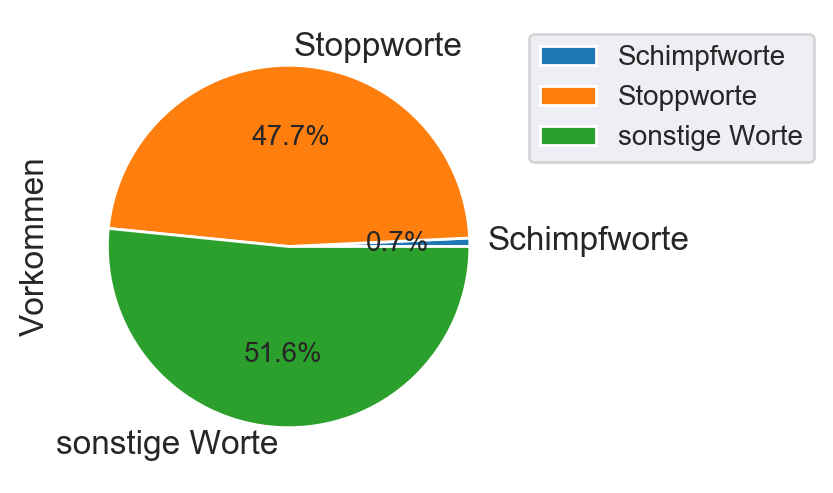

In [33]:
list_of_tuples = [('Schimpfworte', insult_count),
                  ('Stoppworte', stopword_count),
                  ('sonstige Worte', several_count)]

df = pd.DataFrame.from_records(list_of_tuples, columns=['Kategorie', 'Vorkommen'])
df.set_index('Kategorie')

df = df.set_index(df.columns[0])
ax = df.plot(kind='pie', subplots=True, autopct='%.1f%%', figsize=(4, 3))
ax[0].legend(bbox_to_anchor=(1,1), ncol=1) 

# ML-Analysen

## Klassifikation mit unveränderten Songtexten

Mit dem folgenden entstehenden Klassifikator wird zwischen jugendfreien von nicht jugendfreien Liedern unterschieden. Um den Klassifikator zu trainieren, werden die extrahierten Markierungen der Lieder als explizit oder implizit von Genius verwendet. Des Weiteren werden die Songtexte unverändert für die Klassifikation genutzt. Bei Vektorisierung, Erstellung der TF-IDF-Matrix und beim Training der SVM werden die Standardparameter verwendet, welche später mittles Hyperparameter-Tuning angepasst werden.

In [13]:
class_df = genius_df
class_df.reset_index(drop=True, inplace=True)
label = 'is_explicit'
text_col = 'song_text'

### Vektorisierung

#### TF-Matrix:

In [14]:
from sklearn.feature_extraction.text import CountVectorizer

# Lerne Vokabular für alle Daten
count_vect = CountVectorizer(ngram_range=(1, 1), 
                             min_df=1, 
                             max_df=1.0, 
                             lowercase=True,
                             stop_words=None)

X_tf = count_vect.fit_transform(class_df[text_col])

type(X_tf)
X_tf.shape

scipy.sparse.csr.csr_matrix

(10813, 122635)

#### TF-IDF-Matrix erstellen:

In [15]:
from sklearn.feature_extraction.text import TfidfTransformer

tfidf_vect = TfidfTransformer()

X_tfidf = tfidf_vect.fit_transform(X_tf)

X_tfidf.shape

(10813, 122635)

### Train-Test-Split

In [16]:
X = X_tfidf
y = class_df[label]

Splitten der Daten in Test- und Trainingsdaten:

In [17]:
from sklearn.model_selection import train_test_split

# Größe der Testdaten festlegen
test_size = 0.2

if test_size > 0.0:
    X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                        test_size=test_size,
                                                        stratify = y,
                                                        random_state=43
                                                       )
else:
    X_train, X_test, y_train, y_test = X, None, y, None
    
    
print("Trainigsmatrix:", X_train.shape)
print("Testmatrix:    ", X_test.shape)

Trainigsmatrix: (8650, 122635)
Testmatrix:     (2163, 122635)


Markieren der Test- und Trainingsdaten im DataFrame für die spätere Überprüfung:

In [18]:
class_df['train_test'] = pd.Series(class_df.index.isin(y_test.index)).map(lambda x: 'Test' if x else 'Train')

In [19]:
pd.set_option('display.max_rows', 10)
class_df['train_test'].value_counts()
class_df

Train    8650
Test     2163
Name: train_test, dtype: int64

,title,url,song_text,artist,album,released_at,count_referents,pageviews,tags,contributor_count,featured_artists,is_explicit,train_test
0,Chabos wissen wer der Babo ist (Remix),https://genius.com/Haftbefehl-chabos-wissen-wer-der-babo-ist-remix-lyrics,"Chabos wissen, wer der Babo ist Hafti Abi ist der, der im Lambo und Ferrari sitzt Saudi Arabi Money Rich Wissen, wer der Babo ist Attention, mach bloß keine Harakets Bevor ich komm' und dir deine ...",Haftbefehl,Blockplatin,2012-12-13,88,596095,"Remix,Deutschland,Rap,Deutschsprachiger Rap",103,"Al-Gear,Habesha,Veysel,Celo,Abdï,Mosh36,Olexesh,Milonair,Crackaveli,60/60,Doezis",true,Train
1,Chabos wissen wer der Babo ist,https://genius.com/Haftbefehl-chabos-wissen-wer-der-babo-ist-lyrics,"Chabos wissen, wer der Babo ist Hafti Abi ist der, der im Lambo und Ferrari sitzt Saudi Arabi Money Rich Wissen, wer der Babo ist Attention, mach bloß keine Harakets Bevor ich komm' und dir deine ...",Haftbefehl,Blockplatin,2012-10-21,56,501256,"Deutschland,Rap,Deutschsprachiger Rap",61,Farid Bang,true,Train
2,Palmen aus Plastik,https://genius.com/Bonez-mc-and-raf-camora-palmen-aus-plastik-lyrics,"Unter Palmen aus Plastik Am Meer aus Benzin Ohne Sand, aber macht nichts Drehe Runden aufm Roller Wird 'n bisschen kalt, wenn es Nacht ist Ich verbrenne mein Weed Unter Palmen aus Plastik Sommer Ü...",Bonez MC & RAF Camora,Palmen aus Plastik,2016-07-15,17,482758,"Chapter One,Österreich,Dancehall,Deutschsprachiger Rap,Deutschland,Rap",56,N/A,true,Train
3,Liebe,https://genius.com/Sido-liebe-lyrics,"Liebe - Ich spür' dieses Kribbeln im Bauch Diese Liebe - Ich bin im siebten Himmel, ich glaub' Das ist die Liebe - Guck ma' was sie mit mir gemacht hat Diese Liebe - Weil ich dich liebe So ist die...",Sido,30-11-80,2013-11-29,19,486441,"Deutschland,Rap,Deutschsprachiger Rap",23,N/A,true,Train
4,Ohne mein Team,https://genius.com/Bonez-mc-and-raf-camora-ohne-mein-team-lyrics,"Zu sechst im Mercedes Weil alle Jungs müssen mit Ein bisschen Sekt für die Mädels Und auf hundert ein'n Fick Kein Gesetz, keine Regeln Lass uns Kohle verdien'n Weil so lässt es sich leben Und niem...",Bonez MC & RAF Camora,Palmen aus Plastik,2016-09-06,22,797039,"Chapter One,Österreich,Dancehall,Deutschsprachiger Rap,Deutschland,Rap",67,Maxwell 187,true,Train
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10808,Hurra die Welt geht unter,https://genius.com/Kiz-hurra-die-welt-geht-unter-lyrics,"Kleidung ist gegen Gott, wir tragen Feigenblatt Schwingen an Lianen übern Heinrichplatz (Hey) Und die Alten erzählen vom Häuserkampf Beim Barbecue in den Ruinen der Deutschen Bank Vogelnester in e...",K.I.Z.,Hurra die Welt geht unter,2015-07-03,32,349473,"Deutschland,Deutschsprachiger Rap,Rap",69,Henning May,true,Test
10809,110,https://genius.com/Capital-bra-samra-and-lea-110-lyrics,"Wenn wir uns doch lieben Warum tun wir uns weh-eh? Ich weiß, ich hab's übertrieben Doch will nicht, dass du geh-ehst Du schreist mich an und ich geb' dir die Schuld Und der Nachbar von oben wählt ...","Capital Bra, Samra & Lea",Berlin lebt 2,2019-09-20,4,394774,"Bra Musik,Deutschsprachiger Rap,Deutschland,Rap",13,N/A,true,Train
10810,Holland,https://genius.com/257ers-holland-lyrics,"„Holland!“ In der City, wo man mich mittlerweile kennt Lekker Bitterballen mit Senf, dazu 'ne Fritte mit Getränk 'N bisschen kiffen – selbstverständlich, alle schieben Optik Keiner ist auf Aggro, ...",257ers,Mikrokosmos,2016-05-26,42,415318,"Nederland,Deutschland,Deutschsprachiger Rap,Rap",78,N/A,true,Train
10811,Russisch Tourette,https://genius.com/Trailerpark-russisch-tourette-lyrics,"Ich bin ein Superheld, also nimm dich besser in Acht Wenn du Pikachu noch mal falsch schreibst Ey, dann stech' ich dich ab Drück dein Ohr an die Box, du bist ein Hurensohn Ich bin acht Mann stark ...",Trailerpark,Crackstreet Boys 3,2014-12-05,27,30896,"Deutschland,Deutschsprachiger Rap,Rap",22,N/A,true,Train


### Training mit SVM

In [20]:
from sklearn.svm import LinearSVC
print(f'Training on column {label}')

clf = LinearSVC(C=1.0)

clf.fit(X_train, y_train);

print("Done.")

Training on column is_explicit


LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
          intercept_scaling=1, loss='squared_hinge', max_iter=1000,
          multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
          verbose=0)

Done.


### Bewertung

Für die Bewertung wird der Klassifikator auf die Testdaten angewandt. Wir lassen uns die Accurary auf den Test und zusätzlich auf den Trainingsdaten ausgeben:

In [21]:
from sklearn.metrics import accuracy_score

y_test_pred = clf.predict(X_test)
y_train_pred = clf.predict(X_train)
y_pred = clf.predict(X)

print(f"Classifier: {clf.__class__}\n")

print('Accuracy Summary')
print('================')

print(f'Test:    {accuracy_score(y_test, y_test_pred)*100:6.2f}%')
print(f'Train:   {accuracy_score(y_train, y_train_pred)*100:6.2f}%')
print(f'Overall: {accuracy_score(y, y_pred)*100:6.2f}%')

Classifier: <class 'sklearn.svm._classes.LinearSVC'>

Accuracy Summary
Test:     87.93%
Train:    99.70%
Overall:  97.35%


Ausgeben der Accuracy mittels numpy:

In [13]:
np.mean(y_test == y_test_pred)

0.8793342579750347

Klassifikations-Report für genauere Einblicke:

In [14]:
from sklearn.metrics import classification_report

print("Classification Report")
print("=====================")
print(classification_report(y_true=y_test, y_pred=y_test_pred))

Classification Report
              precision    recall  f1-score   support

       false       0.52      0.10      0.16       263
        true       0.89      0.99      0.93      1900

    accuracy                           0.88      2163
   macro avg       0.70      0.54      0.55      2163
weighted avg       0.84      0.88      0.84      2163



### Confusion Matrix

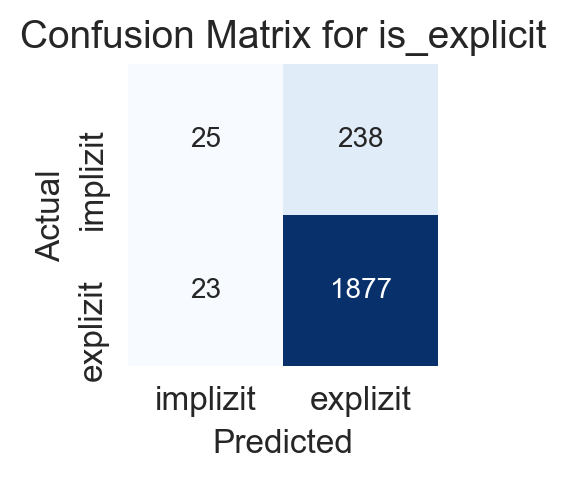

In [15]:
from sklearn.metrics import confusion_matrix

# label names - setzt Reihenfolge in Confusion Matrix fest
label_names = sorted(y_test.unique())
# scale figure size hängt von der Anzahl der Kategorien ab
fsize = len(label_names)

conf_mat = confusion_matrix(y_test, y_test_pred, labels=label_names)

_ = fig, ax = plt.subplots(figsize=(fsize, fsize))
labels = ['implizit', 'explizit']
_ = sns.heatmap(conf_mat, annot=True, fmt="d", cmap="Blues", cbar=False,
               xticklabels=labels, yticklabels=labels)

_ = plt.ylabel("Actual")
_ = plt.xlabel("Predicted")
_ = ax.set_title(f"Confusion Matrix for {label}", fontsize=14)

Hier wird klar, dass der Klassifikator sehr gut darin ist, explizite Lieder zu erkennen. Von den 1900 expliziten Liedern erkennt er 1877 (98.7%). Jedoch hat er große Probleme, implizite Lieder zu erkennen. Von 263 impliziten Liedern erkennt er nur 25 (9.5%).

### Untersuchung des Klassifikators

Dataframe-Ausschnit nur mit Testdaten:

In [16]:
class_df = class_df.iloc[y_test.index]
len(class_df)

2163

In [17]:
class_df['pred'] = y_test_pred

Ausgeben von falsch klassifizierten Daten:

In [18]:
# Spaltenbreite kann ggf. damit verbreitert werden, damit mehr Text sichtbar wird
pd.set_option('max_colwidth', 300)

class_df[class_df[label] != class_df['pred']][[label, 'pred', text_col]].sample(5)

,is_explicit,pred,song_text
2862,false,true,"Bruder ich weiß wie du dich fühlst, deine Frau hat dich verlassen, für ein anderen Typ, weil du ihr nicht genügst, und es fickt deine Psyche, Wut kommt in dir auf, ich erkenne die Tränen an der Nässe, deiner Bilderhaut, du hast alles verloren was dir mal wichtig war, deiner Familie bist du schon..."
10405,false,true,"Ich arbeite ausschließlich mit dem Gehirn! „Yeah, was geht ab? Sido und Helge Schneider! Helge Schnitzel! Wie wir Rapper sagen.“ Was ist nur los in diesem Land? Alle gehen arbeiten, nur ich nicht Was ist nur los in diesem Land? Alle gehen arbeiten, nur ich nicht Was ist nur los in diesem Land? B..."
7723,false,true,"Alles nur für Mama, alles nur für Baba Inshallah, inshallah sind wir bald am Ziel Kolshi bess la Mama, kolshi bess la Baba Inshallah, inshallah kouno merta7in Inshallah Inshallah Ana mesh normal (woo) Früher nichts gehabt Heut Frank Miller am Arm Der erste Kanake, der mit Hits ankam (hey) Noa kr..."
4389,false,true,"Ich steig' in Tourbus, T5 von Sixt Setz' mich nach hinten und dreh' mir einen Spliff Erster Termin, digga, auf geht's nach München Sack kraulen, Pappmaul, brauch' was zu trinken Ein paar Stündchen, die Fahrt zieht sich hin Und der Tag verschwindet, bisschen Schlafen macht Sinn Raststätte, Fast F..."
469,false,true,"An allem was man sagt, an allem was man sagt, ist auch was dran! Egal wer kommt, egal wer geht, egal es kommt nicht darauf an Ich glaube nichts, ich glaub an dich, glaubst du an mich, ich glaub ich auch Ich frage mich, ich frage dich, doch frag ich nicht, fragst du dich auch Ich bin dabei, du bi..."


Ausgeben der expliziten Lieder, die als implizit klassifiziert wurden:

In [19]:
pd.set_option('display.max_colwidth', -1)

class_df[(class_df[label] != class_df['pred']) & (class_df[label] == 'true')][[label, 'pred', text_col]]

,is_explicit,pred,song_text
5762,true,false,"Reiße die Fenster weit auf Ich glaub, heute geh ich endlich mal raus Ich lauf - Gedanken verlassen den Raum Halt dich fest, denn ich lasse los! Atme durch und ich starr nicht mehr aufs Telefon Dreh unser Lied auf und Genieße jeden Ton Jede Melodie, eine Erinnerung Sie werden älter, doch bleiben für immer jung Hah! Jetzt hab ich nichts mehr zu verlieren Laufe Richtung Heimat, den Blick immer zu dir (zu dir) Gerichtet, mein Herz, Geschichte Erzähl sie deinen Kindern und berichte ihn' von mir Der Zeitpunkt wo die Zeit in das Land geht Und das Kind in mir einsam sein Mann steht Ich hab verlor'n, denn ich kann nicht mehr weiter Kämpfen Ich hab gewonnen, denn ich kann jetzt alleine Lächeln Und ich lauf wieder los Diese Welt ist so unglaublich groß (Ohne dich) Einmal durch die Hölle Richtung Paradies wird mir schon nicht die Beine Brechen Ich kann jetzt alleine Lächeln Und ich lauf wieder los Diese Welt ist so unglaublich groß Einmal durch die Hölle Richtung Paradies wird dir schon nicht die Beine Brechen Ühh! Yeah! Ich will's nicht einsehen, doch wir bleiben nicht für immer jung Also schwimm' ich Ziellos durch ein Meer von Erinnerung' Und irgendwie verletzt es mich schon selbst Denn Ich dachte echt bis jetzt - Ich bin ein Held Atme ganz allein die Luft ein, die wir geteilt haben Meine glänzende Truhe voller schöner Bilder werde ich Heim tragen Und jeder Blick ist ein Feuerwerk für mich! Mit jedem Schritt tanzt ein neues Herz im Licht Und ich hoffe die Straße führt zum Ort der mich verstehn' lässt Doch schöne Blumen locken mich vom Weg weg Ich sing ein Lied - Es ist unser Song - Ja vielleicht klingt er schief Könntest du ihn hören - ja du hättest ihn bestimmt geliebt Augen weit auf Laufe ich Raus Mit allen Sinnen sauge ich jeden Augenblick auf Einmal ist es still und die Welt bleibt stehn' Springe ab, verdammt, dass warn' alles gestellte Szenen! Wollt' dich noch einmal sehn, doch bin falsch abgebogen Du hast mich abgeschossen mit deinen Platzpatrone Und trotzdem lauf ich noch Und jeder Schritt fühlt sich Falsch an - bin gespannt was da draußen kommt Einmal durch dir Hölle ins gelobte Land Ich steh im Auge des Sturms und er tobt durchs Land So geh ich mit nem Lächeln im Gesicht Denn manchmal denk ich noch an dich"
8941,true,false,"Kopfüber nach vorn' Schutt, Asche, Staub und Rauch Kaputt machen um aufzubauen (Jap) Lauf' hinaus, lang lebe das Randgebiet Idole zu Grabe getragen in der Fantasie Sind die gebändigte Bestie Wieder Stress ins Unendliche Generation „Gott ist tot“ Die ständig vergessenen Kids Piratsender, Stimmen im Wind Sky is the limit Wer weiß, wo der Himmel beginnt? Und es brennt Im Zweifel für den Zweifel zu spät Die Stadt brennt Teil der Lösung oder Teil des Problems Die Stadt brennt Gibt eh nich' mehr viel zu verlier'n Doch wir war'n hier, verdammt Wir war'n hier Die Wölfe sind los und wollen das Blut seh'n Lasst die Bänder rollen, das Volk will zuseh'n Lasst die Spiele beginnen (Lasst die Spiele beginnen) Lasst die Spiele beginnen (Lasst die Spiele beginnen) Die Wölfe sind los und wollen das Blut seh'n Lasst die Bänder rollen, das Volk will zuseh'n Lasst die Spiele beginnen (Lasst die Spiele beginnen) Lasst die Spiele beginnen Lauter denn je vom Gebäude zu schrei'n Nie war Revolution schöner denn zur heutigen Zeit Wo sich die Lage zuspitzt, nur noch Tragik und ich War doch so schön ausgemalt, aber die Farben verwischt Wo die Spiegelreflex deine Bibel ersetzt Mehr den eigenen Augen glauben als dem Priester-Geschwätz Deutschland krank vor Zorn Die Kinder haben komplett den Verstand verlor'n Und es brennt Im Zweifel für den Zweifel zu spät Die Stadt brennt Teil der Lösung oder Teil des Problems Die Stadt brennt Gibt eh nich' mehr viel zu verlier'n Doch wir war'n hier, verdammt Wir war'n hier Die Wölfe sind los und wollen das Blut seh'n Lasst die Bänder rollen, das Volk will zuseh'n Lasst die Spiele beginnen (Lasst die Spiele beginnen) Lasst die Spiele beginnen (Lasst die Spiele

Genaueres Betrachten eines solchen expliziten Liedes, das als implizit klassifiziert wurde: 

In [20]:
pd.set_option('display.max_colwidth', -1)

class_df[(class_df[label] != class_df['pred']) & (class_df[label] == 'true')][[label, 'pred', text_col]].head(3)

,is_explicit,pred,song_text
5762,true,false,"Reiße die Fenster weit auf Ich glaub, heute geh ich endlich mal raus Ich lauf - Gedanken verlassen den Raum Halt dich fest, denn ich lasse los! Atme durch und ich starr nicht mehr aufs Telefon Dreh unser Lied auf und Genieße jeden Ton Jede Melodie, eine Erinnerung Sie werden älter, doch bleiben für immer jung Hah! Jetzt hab ich nichts mehr zu verlieren Laufe Richtung Heimat, den Blick immer zu dir (zu dir) Gerichtet, mein Herz, Geschichte Erzähl sie deinen Kindern und berichte ihn' von mir Der Zeitpunkt wo die Zeit in das Land geht Und das Kind in mir einsam sein Mann steht Ich hab verlor'n, denn ich kann nicht mehr weiter Kämpfen Ich hab gewonnen, denn ich kann jetzt alleine Lächeln Und ich lauf wieder los Diese Welt ist so unglaublich groß (Ohne dich) Einmal durch die Hölle Richtung Paradies wird mir schon nicht die Beine Brechen Ich kann jetzt alleine Lächeln Und ich lauf wieder los Diese Welt ist so unglaublich groß Einmal durch die Hölle Richtung Paradies wird dir schon nicht die Beine Brechen Ühh! Yeah! Ich will's nicht einsehen, doch wir bleiben nicht für immer jung Also schwimm' ich Ziellos durch ein Meer von Erinnerung' Und irgendwie verletzt es mich schon selbst Denn Ich dachte echt bis jetzt - Ich bin ein Held Atme ganz allein die Luft ein, die wir geteilt haben Meine glänzende Truhe voller schöner Bilder werde ich Heim tragen Und jeder Blick ist ein Feuerwerk für mich! Mit jedem Schritt tanzt ein neues Herz im Licht Und ich hoffe die Straße führt zum Ort der mich verstehn' lässt Doch schöne Blumen locken mich vom Weg weg Ich sing ein Lied - Es ist unser Song - Ja vielleicht klingt er schief Könntest du ihn hören - ja du hättest ihn bestimmt geliebt Augen weit auf Laufe ich Raus Mit allen Sinnen sauge ich jeden Augenblick auf Einmal ist es still und die Welt bleibt stehn' Springe ab, verdammt, dass warn' alles gestellte Szenen! Wollt' dich noch einmal sehn, doch bin falsch abgebogen Du hast mich abgeschossen mit deinen Platzpatrone Und trotzdem lauf ich noch Und jeder Schritt fühlt sich Falsch an - bin gespannt was da draußen kommt Einmal durch dir Hölle ins gelobte Land Ich steh im Auge des Sturms und er tobt durchs Land So geh ich mit nem Lächeln im Gesicht Denn manchmal denk ich noch an dich"
8941,true,false,"Kopfüber nach vorn' Schutt, Asche, Staub und Rauch Kaputt machen um aufzubauen (Jap) Lauf' hinaus, lang lebe das Randgebiet Idole zu Grabe getragen in der Fantasie Sind die gebändigte Bestie Wieder Stress ins Unendliche Generation „Gott ist tot“ Die ständig vergessenen Kids Piratsender, Stimmen im Wind Sky is the limit Wer weiß, wo der Himmel beginnt? Und es brennt Im Zweifel für den Zweifel zu spät Die Stadt brennt Teil der Lösung oder Teil des Problems Die Stadt brennt Gibt eh nich' mehr viel zu verlier'n Doch wir war'n hier, verdammt Wir war'n hier Die Wölfe sind los und wollen das Blut seh'n Lasst die Bänder rollen, das Volk will zuseh'n Lasst die Spiele beginnen (Lasst die Spiele beginnen) Lasst die Spiele beginnen (Lasst die Spiele beginnen) Die Wölfe sind los und wollen das Blut seh'n Lasst die Bänder rollen, das Volk will zuseh'n Lasst die Spiele beginnen (Lasst die Spiele beginnen) Lasst die Spiele beginnen Lauter denn je vom Gebäude zu schrei'n Nie war Revolution schöner denn zur heutigen Zeit Wo sich die Lage zuspitzt, nur noch Tragik und ich War doch so schön ausgemalt, aber die Farben verwischt Wo die Spiegelreflex deine Bibel ersetzt Mehr den eigenen Augen glauben als dem Priester-Geschwätz Deutschland krank vor Zorn Die Kinder haben komplett den Verstand verlor'n Und es brennt Im Zweifel für den Zweifel zu spät Die Stadt brennt Teil der Lösung oder Teil des Problems Die Stadt brennt Gibt eh nich' mehr viel zu verlier'n Doch wir war'n hier, verdammt Wir war'n hier Die Wölfe sind los und wollen das Blut seh'n Lasst die Bänder rollen, das Volk will zuseh'n Lasst die Spiele beginnen (Lasst die Spiele beginnen) Lasst die Spiele beginnen (Lasst die Spiele

Das letzte gezeigte Lied heißt „Totentanz“ und stammt vom Interpreten Capo. Wie man sieht, wurde es als implizit klassifiziert, da im Songtext keinerlei Schimpfworte vorhanden sind. Wirft man jedoch einen genaueren Blick auf den Kontext des Liedes, merkt man schnell, dass es sich thematisch um Selbstmord handelt. Dies wird bespielswiese an den Stellen „Ein Sprung von den Dächern“ und „ich fall' in den ewigen Schlaf“. Das liegt daran, dass der Klassifikator sich schwer tut den Kontext des Liedes einfließen zu lassen, sondern vor allem Schimpfwörter als Indiz für Explizität verwendet.

Ausgeben von richtig klassifizierte Daten:

In [52]:
class_df[class_df[label] == class_df['pred']][[label, 'pred', text_col]].sample(5)

,is_explicit,pred,song_text
7971,true,true,"Vrzeu mir doch nüt, isch scho guät Scho guät U aui redä u redä u i weiss nid mau, was si meinä Mir bruchä öpis zum Schreiä, du vrsteisch (ah) Drum bruch ig di Kampfparolä Schüsch lost widr kenä U widrerkennä isch wichtig fürnä glichä Nenner Itz chömä Spruchbandbitches u diä Morau gits nid U äs isch spetistens denn nüm so witzig, we dini Prinzipiä gfiggt si Dr Mönsch isch schlächt Politisch korräkt si, Crack si Dräcksbiuigi Drogä vo Dealer i Azüg U d Religion? Äh, äs geit so Wüu ds isch dr unergründlech Wäg, wed nüm weisch, wid gester bisch heicho Nur Chrüzzüg, Piugerfahrtä, nid viu erfahrä Lug itz zerbricht dä christlech Biuderrahmä U i würd aubä gärn gloubä, wüu gloubä chader häufä Wüu dr Sinn vor Wäut offebahrt sech mir nur säutä U weni sägä, nimms wis chunt, tönt ds flach, abr wart Wüu mängisch isch ds aues, woni no ha, fuck U so läbemer au Spänd di Cash, dänksch du di Demos änderä aues Engagement fürds schlächtä Gwüssä Und so wärdemer aut U när vrgässemer langsam, wasmr üs hei vorgno U när isch irgendwenn scho: Salut Drum muäs ig mis Ego pushä Si revoluzzä I hiufä när, i muäs zersch no mis Velo putzä Mir si eh scho dussä U mir wettä numä umds Vrreckä gärn wüssä würum? Mis Ego pushä Si revoluzzä I hiufä när, i muäs zersch no mis Velo putzä Mir si eh scho dussä U mir wettä numä umds Vrreckä gärn wüssä würum? U i sägä: Nei, nei, da sägi nüt U Gründ gits vrschidnegi Je meh, dassi weiss, desto unsicherer wirdeni I weiss ging no nid würum, i nid zfridä bi Doch stumm blibä isches nid U drum schribä i dä Shit U blibä gflasht u zeigädr wimä rapt Zeigä mir de glich ä Wäg zmizt dürnes Minäfäud Blibä nid hockä I wott grossi Schnurrenä stopfä Fah afah rapä, ha nach drü Sätz gwunnä wi Roger Lug i bi nid deep, i tribä wi Iis ar Oberflächi I gseh nid dri, wüu ds Liecht hiä so schlächt isch I wott ufä Grund, ws heisst de ds itz? Ds muäs heissä, wäri hiä, de wirdi eis mit mir, vrsteisch nid I wott Cash, integriert si, gliebt si, Kollegä si, leger si, aus ha und immr numä pennä Abr i kennä di Normä Lug i weiss, wases brucht Dir bruchet Schlaf, Frou, Ching, Hung, Gartä, Hobby, Huus Mis Ego pushä Si revoluzzä I hiufä när, i muäs zersch no mis Velo putzä Mir si eh scho dussä U mir wettä numä umds Vrreckä gärn wüssä würum? Mis Ego pushä Si revoluzzä I hiufä när, i muäs zersch no mis Velo putzä Mir si eh scho dussä U mir wettä numä umds Vrreckä gärn wüssä würum? I muäs d Ärdä rettä, si ligt ufem Stärbebett Und äs wär ä Pflicht für jedä, wo di wahrä Wärtä kennt I bi ä Egoist, am Schluss bi eh nur ig U weni nid mit mir cha zfridä si, de hets weni Sinn I muäs d Ärdä rettä, si ligt ufem Stärbebett Und äs wär ä Pflicht für jedä, wo di wahrä Wärtä kennt (äuä) I bi ä Egoist, (lug) am Schluss bi eh nur ig U weni nid mit mir cha zfridä si, de hets weni Sinn"
7141,true,true,"Du bist nur ein Bastard, ein V-Mann der Cops Sogar deine Mama ist auf diesem Stoff - Carlo Cokxxx Ich zähle die Scheine, ihr Ficker seid alle nur irrelevant Große Fresse, große Nase, mini der Schwanz Frank ist dein Vater, ihr Rapper seid alle nur Kinder von mir Sag deinem Anwalt ich such dich und fick dann den Killer in dir Felix, du Nutte, ich ficke dein Leben, sobald du mich siehst Kille euch Rapper, der erste MC, der beim Battle auch schießt Bang, Bang, Pablo Esco Ich bin Berliner und schmeiße die Scheine - Carlo Cash Flow Du machst auf krass, deine Mutter sie bläst Zähle die Scheine, die du niemals zählst Carlo Cocaína Flow, jeden Tag Schlampen werden feucht in meiner Gegenwart Ziehe die Lines, taubes Gesicht Ihr seid, ihr seid, alles Behinderte aus meiner Sicht Ihr wollt kein Krieg mit mir, ich bin wie Gott in diesen Straßen Hinter mir, immer Bullen, wenn ich Siebener fahre Breites Kreuz, breite Schultern, breite Arme, Testo Ich bin im Trap House der Boss, nenn mich Pablo Esco Pablo Esco, Pablo Esco Pablo, Pablo, Pablo Esco Pablo, Pablo, Pablo Esco Mein Kontakt steckt in Bogotá, das Koka kommt im Boot an Hamburger Hafen, zwischen importi

### Hyperparameter-Tuning mit GridSearchCV

#### Aufbau Pipeline

Mit der `Pipeline` werden mehrere Schritte des Traingsprozesses zu einem zusammengefasst:

In [53]:
from sklearn.pipeline import Pipeline

pipeline = Pipeline([
    ("vect", CountVectorizer()),
    ("tfidf", TfidfTransformer()),
    ("clf", LinearSVC())
])

#### Definition des Parameter-Grids

Wir testen alle Parameter, damit die Steigerung der Accuracy so groß wie möglich wird:

In [54]:
parameters = {
    "vect__min_df": [2, 5, 10], 
    "vect__max_df": [0.5, 0.75, 1.0], 
    "vect__ngram_range": [(1, 1), (1, 2)],
    "tfidf__norm": ["l1", "l2"], 
    "tfidf__use_idf": [True, False], 
    "tfidf__sublinear_tf": [True, False], 
    "clf__C": [0.2, 0.5, 1.0, 5.0]
}

#### Training mit Grid-Suche

In [55]:
X = class_df[text_col]
y = class_df[label] 

In [56]:
from sklearn.model_selection import train_test_split

# Größe der Testdaten festlegen
test_size = 0.2

if test_size > 0.0:
    X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                        test_size=test_size,
                                                        stratify = y,
                                                        random_state=76
                                                       )
else:
    X_train, X_test, y_train, y_test = X, None, y, None

print("Trainingsdaten:", X_train.shape)
print("Testdaten:    ", X_test.shape)

Trainingsdaten: (1730,)
Testdaten:     (433,)


In [57]:
pd.set_option('max_colwidth', 50)
X_test.sample(5)

1991     Nein, ich bin nicht Jigga, doch: (the truf is ...
7281     Ich hol' aus und schlage zu, repräsent im Pali...
10676    Sie war echt Na na na na (ja) Mhh, war wieder ...
5705     S zum U zum D Das ist Shit für die Straße (Ohh...
5805     Marteria, Marteria, Johnny Mo, Magnum 12 alter...
Name: song_text, dtype: object

Starten des Training der Pipeline:

In [53]:
from time import time
from sklearn.model_selection import GridSearchCV

grid_search = GridSearchCV(pipeline, parameters, n_jobs=-1, verbose=1)

print("Pipeline:", [name for name, _ in pipeline.steps])

t0 = time()
grid_search.fit(X_train, y_train)

print("Fertig nach %0.3fs" % (time() - t0))

Pipeline: ['vect', 'tfidf', 'clf']
Fitting 5 folds for each of 576 candidates, totalling 2880 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   16.4s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done 434 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done 784 tasks      | elapsed:  6.2min
[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed: 10.0min
[Parallel(n_jobs=-1)]: Done 1784 tasks      | elapsed: 14.8min
[Parallel(n_jobs=-1)]: Done 2434 tasks      | elapsed: 20.3min
[Parallel(n_jobs=-1)]: Done 2880 out of 2880 | elapsed: 24.0min finished


GridSearchCV(cv=None, error_score=nan,
             estimator=Pipeline(memory=None,
                                steps=[('vect',
                                        CountVectorizer(analyzer='word',
                                                        binary=False,
                                                        decode_error='strict',
                                                        dtype=<class 'numpy.int64'>,
                                                        encoding='utf-8',
                                                        input='content',
                                                        lowercase=True,
                                                        max_df=1.0,
                                                        max_features=None,
                                                        min_df=1,
                                                        ngram_range=(1, 1),
                                                        p

Fertig nach 1444.319s


#### Ausgabe der besten Parameter

In [59]:
print("Bester Score (hier Accuracy): %0.3f" % grid_search.best_score_)

print("Bestes Parameter Set:")
best_parameters = grid_search.best_estimator_.get_params()

for param_name in sorted(parameters.keys()):
    print("  %-25s: %r" % (param_name, best_parameters[param_name]))

Bester Score (hier Accuracy): 0.896
Bestes Parameter Set:
  clf__C                   : 5.0
  tfidf__norm              : 'l2'
  tfidf__sublinear_tf      : True
  tfidf__use_idf           : False
  vect__max_df             : 1.0
  vect__min_df             : 10
  vect__ngram_range        : (1, 2)


Durch das Hyperparameter-Tuning müssen folgende Parameter geändert werden, um das bestmögliche Ergebnis zu erreichen:

- bei der Vektorisierung: min_df auf 10 und ngram_range auf (1,2)
- bei der Erstellung der TF-IDF-Matrix: use_idf auf False und sublinear_tf auf True
- beim Training mit SVM: c auf 5.0
Für alle anderen Parameter sollen die Standardwerte verwendet werden.

In [60]:
pd.DataFrame.from_dict(grid_search.cv_results_).sort_values('rank_test_score').head(10)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_clf__C,param_tfidf__norm,param_tfidf__sublinear_tf,param_tfidf__use_idf,param_vect__max_df,param_vect__min_df,param_vect__ngram_range,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
539,5.26,0.08,0.66,0.12,5.00,l2,True,False,1.00,10,"(1, 2)","{'clf__C': 5.0, 'tfidf__norm': 'l2', 'tfidf__s...",0.89,0.89,0.90,0.90,0.89,0.90,0.00,1
394,2.05,0.33,0.41,0.06,1.00,l2,True,False,1.00,10,"(1, 1)","{'clf__C': 1.0, 'tfidf__norm': 'l2', 'tfidf__s...",0.89,0.90,0.90,0.89,0.89,0.89,0.01,2
532,1.48,0.10,0.27,0.02,5.00,l2,True,False,0.75,10,"(1, 1)","{'clf__C': 5.0, 'tfidf__norm': 'l2', 'tfidf__s...",0.91,0.89,0.89,0.90,0.88,0.89,0.01,2
536,1.70,0.14,0.31,0.03,5.00,l2,True,False,1.00,5,"(1, 1)","{'clf__C': 5.0, 'tfidf__norm': 'l2', 'tfidf__s...",0.90,0.89,0.90,0.89,0.89,0.89,0.00,4
392,2.00,0.17,0.47,0.03,1.00,l2,True,False,1.00,5,"(1, 1)","{'clf__C': 1.0, 'tfidf__norm': 'l2', 'tfidf__s...",0.89,0.90,0.90,0.89,0.88,0.89,0.01,5
530,1.45,0.07,0.29,0.02,5.00,l2,True,False,0.75,5,"(1, 1)","{'clf__C': 5.0, 'tfidf__norm': 'l2', 'tfidf__s...",0.90,0.90,0.88,0.90,0.88,0.89,0.01,5
538,1.75,0.17,0.37,0.06,5.00,l2,True,False,1.00,10,"(1, 1)","{'clf__C': 5.0, 'tfidf__norm': 'l2', 'tfidf__s...",0.90,0.89,0.90,0.90,0.88,0.89,0.01,7
534,1.49,0.08,0.32,0.04,5.00,l2,True,False,1.00,2,"(1, 1)","{'clf__C': 5.0, 'tfidf__norm': 'l2', 'tfidf__s...",0.90,0.88,0.90,0.89,0.89,0.89,0.01,8
390,1.76,0.19,0.32,0.04,1.00,l2,True,False,1.00,2,"(1, 1)","{'clf__C': 1.0, 'tfidf__norm': 'l2', 'tfidf__s...",0.89,0.90,0.89,0.89,0.88,0.89,0.00,9
528,1.70,0.21,0.33,0.04,5.00,l2,True,False,0.75,2,"(1, 1)","{'clf__C': 5.0, 'tfidf__norm': 'l2', 'tfidf__s...",0.89,0.90,0.90,0.89,0.88,0.89,0.01,9


#### Test mit optimierter Parametrisierung

Jetzt wird der Klassifikator auf alle Daten angewandt, um die Verbesserung der Accuracy zu zeigen:

In [61]:
from sklearn.metrics import accuracy_score

clf = grid_search.best_estimator_ # verwendet den besten estimator

y_test_pred = clf.predict(X_test)
y_train_pred = clf.predict(X_train)
y_pred = clf.predict(X)

print(f"Classifier: {clf.__class__}\n")

print('Accuracy Summary')
print('================')

print(f'Test:    {accuracy_score(y_test, y_test_pred)*100:6.2f}%')
print(f'Train:   {accuracy_score(y_train, y_train_pred)*100:6.2f}%')
print(f'Overall: {accuracy_score(y, y_pred)*100:6.2f}%')

Classifier: <class 'sklearn.pipeline.Pipeline'>

Accuracy Summary
Test:     88.22%
Train:   100.00%
Overall:  97.64%


Durch das Hyperparameter-Tuning konnte die Accuracy der Testdaten von 87.93% auf 88.22% erhöht werden.

In [62]:
from sklearn.metrics import classification_report

print("Classification Report")
print("=====================")
print(classification_report(y_true=y_test, y_pred=y_test_pred))

Classification Report
              precision    recall  f1-score   support

       false       0.58      0.13      0.22        53
        true       0.89      0.99      0.94       380

    accuracy                           0.88       433
   macro avg       0.74      0.56      0.58       433
weighted avg       0.85      0.88      0.85       433



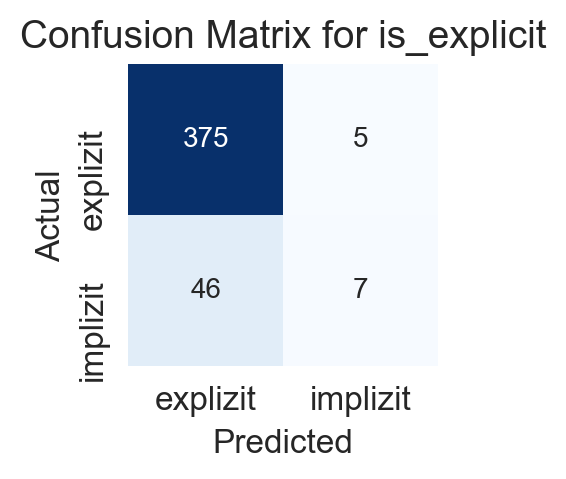

In [64]:
from sklearn.metrics import confusion_matrix

# label names - setzt Reihenfolge in Confusion Matrix fest
label_names = y_test.unique()

# scale figure size hängt von der Anzahl der Kategorien ab
fsize = len(label_names)

conf_mat = confusion_matrix(y_test, y_test_pred, labels=label_names)

_ = fig, ax = plt.subplots(figsize=(fsize, fsize))
labels = ['explizit', 'implizit']
_ = sns.heatmap(conf_mat, annot=True, fmt="d", cmap="Blues", cbar=False, 
                xticklabels=labels, yticklabels=labels)
_ = plt.ylabel("Actual")
_ = plt.xlabel("Predicted")
_ = ax.set_title(f"Confusion Matrix for {label}", fontsize=14)

## Klassifikation mit Lemmas

Mit dem folgenden entstehenden Klassifikator soll versucht werden, jugendfreie von nicht jugendfreien Liedern unterscheiden zu können. Wie beim oberen Klassifikator werden die Markierungen für die Explizität von Genius verwendet. Bei diesem Klassifikator werden anstatt der unveränderten Songtexte nur die Lemmas der Songtexte verwendet. Des Weiteren werden hier gleich die durch das Hyperparameter-Tuning ermittelten angepassten Parameter verwendet und der Prozess nicht mehr zusätzlich durchgeführt.

### Lemmas mit SpaCy extrahieren: 

In [58]:
import spacy

nlp = spacy.load('de_core_news_sm')

nlp_tagger = spacy.load('de_core_news_sm', disable=['parser', 'ner'])
nlp_tagger.pipeline

[('tagger', <spacy.pipeline.pipes.Tagger at 0x19ee0cc79c8>)]

Mit der folgenden Funktion können Lemmas zu bestimmten Parts-of-Speech einfach aus den Texten extrahiert werden:

In [59]:
import textacy

def extract_lemmas(doc, include_pos=None, filter_stops=False):

    tokens = textacy.extract.words(doc, 
               filter_stops=filter_stops, # default True, no stopwords
               filter_punct=True,  # default True, no punctuation
               filter_nums=True,   # default False, no numbers
               include_pos=include_pos, # default None = include all
               exclude_pos=None,   # default None, exclude none
               min_freq=1)

    return [t.lemma_ for t in tokens]

Mit der folgenden Funktion können alle Lemmas aus den Songtexten extrahiert werden:

In [60]:
def nlp_extract(text):

    doc = nlp(text)

    # for "all lemma" extraction
    lemma_pos_tags  = ['ADJ', 'ADP', 'ADV', 'AUX', 'CONJ', 'CCONJ', 'SCONJ', 
                       'DET', 'INTJ', 'NOUN', 'PRON', 'PROPN', 'VERB']
    # excluded pos tags: 'NUM', 'PART', # 'PUNCT', 'SYM', 'X', 'SPACE'
    
    all_lemmas      = extract_lemmas(doc, lemma_pos_tags, filter_stops=False)

    return all_lemmas

Die Lemmas werden nun aus den Songtexten extrahiert und in einer Spalte im DataFrame gespeichert:

In [118]:
genius_df['all_lemmas'] = genius_df.progress_apply(lambda row: nlp_extract(row['song_text']), axis='columns')
genius_df.head(10)

KeyboardInterrupt: 

In [ ]:
genius_df['all_lemmas'] = genius_df['all_lemmas'].map(lambda tokens: " ".join(tokens))
    
genius_df[['all_lemmas']].head(10)

Der angepasste Ergebnis-DataFrame kann jetzt in eine SQLite-Datenbank abgespeichert werden:

In [ ]:
database = 'genius_prepared.sqlite'

with sqlite3.connect(database) as con:
    genius_df.to_sql('genius_prepared', con, index=False, if_exists='replace')

Auslesen des angepassten DataFrames aus der vorher erstellten Datenbank:

In [21]:
database = 'genius_prepared.sqlite'

def txa_sql_pd_dataframe(sql, parse_dates=None):
    """
    Open connection to sqlite database and return result 
    of sql query as pandas dataframe
    :param sql: query
    :return: dataframe
    """

    con = sqlite3.connect(database)
    df = pd.read_sql_query(sql, con, parse_dates=parse_dates)
    con.close()
    return df

sql = """
SELECT title, artist, song_text, all_lemmas, is_explicit
FROM genius_prepared
"""

df = txa_sql_pd_dataframe(sql)
len(df)

10813

In [22]:
df.reset_index(drop=True, inplace=True)

In [23]:
label = 'is_explicit'
text_col = 'all_lemmas'

### Vektorisierung

#### TF-Matrix:

Das Hyperparameter-Tuning hat ermittelt, dass für die Vektorisierung min_df=5, max_df=1 und ngram_range=(1, 1) für die besten Ergebnisse sorgt. Das heißt, nur min_df wurde geändert, um die Ergebnisse zu verbessern.

In [24]:
from sklearn.feature_extraction.text import CountVectorizer

# Lerne Vokabular für alle Daten
count_vect = CountVectorizer(ngram_range=(1, 1), 
                             min_df=5, 
                             max_df=1.0, 
                             lowercase=True,
                             stop_words=None)

X_tf = count_vect.fit_transform(df[text_col])

type(X_tf)
X_tf.shape

scipy.sparse.csr.csr_matrix

(10813, 23614)

#### TF-IDF-Matrix erstellen:

Auch bei der Erstellung der TF-IDF-Matrix wurden Parameter zur Verbesserung angepasst. Der benutzte Parameter norm verbleibt auf dem Standardwert. use_idf wird stattdessen auf False gesetzt und sublinear_tf auf True:

In [25]:
from sklearn.feature_extraction.text import TfidfTransformer

tfidf_vect = TfidfTransformer(norm='l2', use_idf=False, sublinear_tf=True)

X_tfidf = tfidf_vect.fit_transform(X_tf)

X_tfidf.shape

(10813, 23614)

### Train-Test-Split:

In [27]:
X = X_tfidf
y = df[label]

Splitten der Daten in Test-und Trainingsdaten:

In [28]:
from sklearn.model_selection import train_test_split

# Größe der Testdaten festlegen
test_size = 0.2

if test_size > 0.0:
    X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                        test_size=test_size,
                                                        stratify = y,
                                                        random_state=43
                                                       )
else:
    X_train, X_test, y_train, y_test = X, None, y, None
    
    
print("Trainigsmatrix:", X_train.shape)
print("Testmatrix:    ", X_test.shape)

Trainigsmatrix: (8650, 23614)
Testmatrix:     (2163, 23614)


Markieren der Test-und Trainingsdaten im DataFrame für die spätere Überprüfung:

In [29]:
df['train_test'] = pd.Series(df.index.isin(y_test.index)).map(lambda x: 'Test' if x else 'Train')

In [30]:
df['train_test'].value_counts()
df

Train    8650
Test     2163
Name: train_test, dtype: int64

title                    artist  \
0      Chabos wissen wer der Babo ist (Remix)  Haftbefehl                 
1      Chabos wissen wer der Babo ist          Haftbefehl                 
2      Palmen aus Plastik                      Bonez MC & RAF Camora      
3      Liebe                                   Sido                       
4      Ohne mein Team                          Bonez MC & RAF Camora      
...               ...                                            ...      
10808  Hurra die Welt geht unter               K.I.Z.                     
10809  110                                     Capital Bra, Samra & Lea   
10810  Holland                                 257ers                     
10811  Russisch Tourette                       Trailerpark                
10812  Cataleya                                Samra                      

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   

### Training mit SVM 

Die letzte ermittelte Parameteränderung durch das Hyperparameter-Tuning ist die Änderung von C=1.0 auf C=5.0:

In [31]:
from sklearn.svm import LinearSVC
print(f'Training on column {label}')

clf = LinearSVC(C=5.0)

clf.fit(X_train, y_train);

print("Done.")

Training on column is_explicit


LinearSVC(C=5.0, class_weight=None, dual=True, fit_intercept=True,
          intercept_scaling=1, loss='squared_hinge', max_iter=1000,
          multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
          verbose=0)

Done.


### Bewertung

Für die Bewertung wird der Klassifikator auf die Testdaten angewandt. Wir lassen uns die Accurary auf den Test und zusätzlich auf den Trainingsdaten ausgeben. Der Klassifikator ohne Hyperparameter-Tuning erzeugte folgende Ergebnisse:
- Accuracy Summary
- Test:     88.30%
- Train:    99.35%
- Overall:  97.14%

In [32]:
from sklearn.metrics import accuracy_score

y_test_pred = clf.predict(X_test)
y_train_pred = clf.predict(X_train)
y_pred = clf.predict(X)

print(f"Classifier: {clf.__class__}\n")

print('Accuracy Summary')
print('================')

print(f'Test:    {accuracy_score(y_test, y_test_pred)*100:6.2f}%')
print(f'Train:   {accuracy_score(y_train, y_train_pred)*100:6.2f}%')
print(f'Overall: {accuracy_score(y, y_pred)*100:6.2f}%')

Classifier: <class 'sklearn.svm._classes.LinearSVC'>

Accuracy Summary
Test:     92.28%
Train:   100.00%
Overall:  98.46%


Ausgeben der Accuracy mittels numpy:

In [33]:
np.mean(y_test == y_test_pred)

0.922792417938049

Durch das Hyperparameter-Tuning hat sich nun die Accuracy der Testdaten von 88.3% auf 92.28% gesteigert. 

Klassifikations-Report für genauere Einblicke:

In [34]:
from sklearn.metrics import classification_report

print("Classification Report")
print("=====================")
print(classification_report(y_true=y_test, y_pred=y_test_pred))

Classification Report
              precision    recall  f1-score   support

       false       0.73      0.58      0.65       263
        true       0.94      0.97      0.96      1900

    accuracy                           0.92      2163
   macro avg       0.84      0.78      0.80      2163
weighted avg       0.92      0.92      0.92      2163



### Confusion Matrix

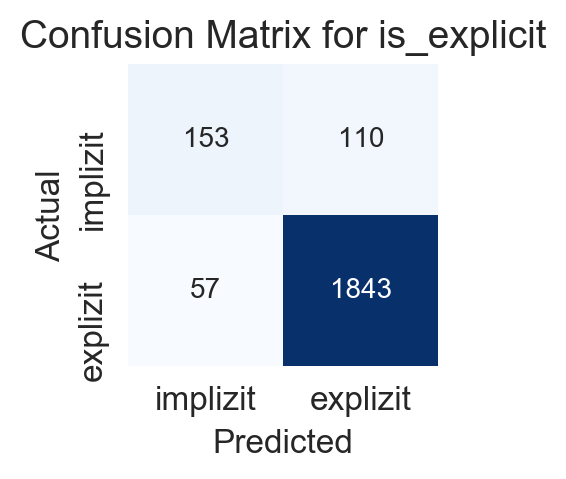

In [35]:
from sklearn.metrics import confusion_matrix

# label names - setzt Reihenfolge in Confusion Matrix fest
label_names = sorted(y_test.unique())

# scale figure size hängt von der Anzahl der Kategorien ab
fsize = len(label_names)

conf_mat = confusion_matrix(y_test, y_test_pred, labels=label_names)

_ = fig, ax = plt.subplots(figsize=(fsize, fsize))
labels = ['implizit', 'explizit']
_ = sns.heatmap(conf_mat, annot=True, fmt="d", cmap="Blues", cbar=False, 
                xticklabels=labels, yticklabels=labels)
_ = plt.ylabel("Actual")
_ = plt.xlabel("Predicted")
_ = ax.set_title(f"Confusion Matrix for {label}", fontsize=14)

Wie beim vorherigen Klassifikator wird klar, dass der Klassifikator sehr gut darin ist, explizite Lieder zu erkennen. Von den 1900 expliziten Liedern erkennt er 1843 (97%). Jedoch schafft es dieser Klassifikator, den Großteil der impliziten Lieder zu erkennen. Von 263 impliziten Liedern erkennt er 153 (58%).

## Vergleich und Bewertung der Klassifikatoren

Die Accuracy der beiden Klassifikatoren ist fast gleich. Der Klassifikator ohne veränderte Songtexte erreicht eine Accuraccy von 97.64% nach dem Hyperparameter-Tuning. Der Klassifikator mit Lemmas erzielt hingegen eine Accuracy von 98.46%. Der Unterschied der beiden Klassifikatoren liegt in der Erkennung der impliziten Lieder. Der erste Klassifikator stuft die meisten impliziten Lieder als explizit ein. Hingegen erkennt der zweite Klassifikator mehr als die Hälfe der impliziten Lieder auch als implizit, wodurch der Unterschied in der Accuracy entsteht.

Die hohe Accuracy der beiden Klassifikatoren würde wahrscheinlich abnehmen, wäre eine höhere Anzahl an impliziten Liedern in den extrahierten Daten enthalten, da diese Lieder häufiger falsch klassifiziert werden. Es könnte jedoch auch sein, dass sich die größere Anzahl an impliziten Liedern positiv auf die Klassifikation auswirkt, wodurch die Accuarcy gleich bleiben oder steigen könnte.

# Zusammenfassung und Bewertung der Ergebnisse

Sehr geehrte Mitarbeiter des Radiosenders Soprona Beats,

in diesem letzten Kapitel sollen die Ergebnisse unserer Analyse der Deutschrap-Songs evaluiert werden und im Anschluss eine Handlungsempfehlung gegeben werden.

## Zusammenfassung der Methodik

![Zusammenfassung%20der%20Methodik](resources/Zusammenfassung%20der%20Methodik.png)

## Evaluation der Analyse

Dabei ist zu erwähnen, dass die Songtexte in allen Hinsichten gut analysiert werden konnten. Weder die Datenextraktion noch das genauere Kennenlernen der Texte anhand einiger Statistiken bereitete unserem Team größere Schwierigkeiten. Auch die Klassikfikationen, welche in Kapitel 4 thematisiert wurden, treffen zum Großteil richtige Vorhersagen. Hierbei ist jedoch zu beachten, dass sich die von uns angewandten Klassifikationen vor allem von Schimpfworten auslösen lassen. Die größte Schwachstelle unserer Klassifikatoren sind demnach Lieder, welche keine Schimpfworte enthalten, aber einen nicht jugendfreien Kontext mit sich bringen. Summa summarum ist dennoch zu sagen, dass die Analyse der Deutschrap-Texte unserer Ansicht nach zufriedenstellend ist.

## Evaluation der Deutschrap-Texte auf Explizität und Handlungsempfehlung

Das Ziel von Soprano Beats ist es, durch die Analyse, welche in diesem Notebook betrieben wurde, herauszufinden, welche Lieder jugendfrei und welche nicht jugendfrei sind. Denn Soprano Beats hat sich – wie im einleitenden Kapitel „Hintergrund und Problemstellung“ beschrieben – zum Ziel gesetzt, mehr Deutschrap-Lieder zu spielen, um auch eine jüngere Zielgruppe an Zuhörern anzusprechen.

Eine schlechte Nachricht für Soprano Beats ist, dass unsere Ergebnisse zeigen, dass ein Großteil der Lieder im Deutschrap – nämlich 87.8 % – explizit, also nicht jugendfrei sind. Das heißt, der Korpus an Deutschrap-Texten, auf welche Soprano Beats zugreifen kann, ist nicht gerade groß.

Da Deutschrap jedoch immer stärker an Popularität gewinnt, ist eine gute Nachricht für Soprano Beats, dass es trotz der Tatsache, dass relativ zu den expliziten sehr wenige implizite Songs existieren, in absoluten Zahlen nichtsdestotrotz viele implizite Songs gibt, auf die Soprano Beats zurückgreifen kann. Die Songs, die von Genius und von unseren Klassifikator als implizit erkannt wurden, werden im Folgenden für die Kontentplaner von Soprano Beats aufgelistet (hierfür benutzten wir die Ergebnisse des zweiten Klassifikators):

In [36]:
pd.set_option('display.max_rows', None)
pd.set_option('max_colwidth', -1)
df['pred'] = y_pred
content_plan = df[(df[label] == df['pred']) & (df[label] == 'false')][['artist', 'title', text_col]]
content_plan

,artist,title,all_lemmas
7,Bausa,Was Du Liebe nennst,Yeah yeah yeah yeah yeah yeah Oh-oh-oh-oh-oh-ohh yeah yeah yeah Baby geben sich mehr von der was du lieben nennen Auch wenn ich kein lieben sein ich lieb ich Hilf sich vergessen was sein sein sein Ich park meinen Herz bei sich heute Nacht yeah Also geben sich mehr von der was du lieben nennen Auch wenn ich kein lieben sein ich lieb ich Hilf sich vergessen was sein Ich park meinen Herz bei sich heute Nacht heute Nacht Ich roll ein'n Jib roll ein'n Jib ich werden high yeah Mix Tonic mit Gin mal Baby mein lieben mein lieben sein kalt wie Eis wuh Ich lass ich schmelzen wenn du wissen was ich meinen geben sich mehr von sich Fake-Love und ich rede von dies scheiß Drake-Song Erfüll sich Wunsch wie bei Dragon Ball Shenlong Komplett auf Harmonies voll auf Sendung geben sich mehr von der was du lieben nennen Auch wenn ich kein lieben sein ich lieb ich Hilf sich vergessen was sein jajaja Ich park meinen Herz bei sich heute Nacht yeah Also geben sich mehr von der was du lieben nennen Auch wenn ich kein lieben sein ich lieb ich Hilf sich vergessen was sein Ich park meinen Herz bei sich heute Nacht heute Nacht Baby Jägi-Energy straight Hennessy und auf Spotify A$ AP Rocky L$D ich wollen wissen wie der Hase laufen nur Birds ein Bees Baby auch der hart Zeug uhh Ich komm wieder wenn ich rufen mein lieben sein echt aber dafür sein ich gut Park der Benz vor der Tür park meinen Herz in mein Bett Mach so weit und ich geh hier mehr weg geben sich mehr von der was du lieben nennen Auch wenn ich kein lieben sein ich lieb ich Hilf sich vergessen was sein jajaja Ich park meinen Herz bei sich heute Nacht yeah Also geben sich mehr von der was du lieben nennen Auch wenn ich kein lieben sein ich lieb ich Hilf sich vergessen was sein Ich park meinen Herz bei sich heute Nacht heute Nacht Baby Yeah ey ey Baby wie langen bleiben du mit sich wach Ich park meinen Herz bei sich heute Nacht yeah Ella ella ella ey Wie langen bleiben du mit sich wach Ich park meinen Herz bei sich heute Nacht wouh
10,Alligatoah,Willst du,Na wie man einen lieben maximal romantisch leben wollen jed wissen kein helfen sich Fairplay Gott sein Dank geben ich Film und Fernseh'n da wo ich meinen Bildung hernehm da wo Glaub sich der werden super für mein Story habe schon der Grund weshalb du in sich Jugendphase wutgeladen sein mein Papa kommen zu mein Schultheaterstück Bei sich finden ich schon was wo der Schuh gerade drücken ich kennen sich seit Jahr du brauchen jetzt nix sagen Ich wollen sich fragen Wolle ich der nächst Schritt wagen wollen du mit sich Droge nehmen Dann werden ich rote Rose regnen Ich hab 's in einer Soap sehen wollen du mit sich Droge nehmen Komm Komm ich geh'n komm ich geh'n zusamm'n der Bach runter Komm Komm ich geh'n komm ich geh'n zusamm'n der Bach runter Komm Komm ich geh'n komm ich geh'n zusamm'n der Bach runter Komm denn einen Wrack sein einen Ort an der einen Schatz schlummern Jetzt sein ich frei chillen auf gigantisch Berggipfeln Du musst dann sagen kein können unsern Schmerz diggen ich sammeln erstmal fröhlich Kiffsonntage Yeah ah Für der hituntermalte Schnittmontage Komm schon der werden romantisch Wenn ich sich halte damit du auf der Klorand brechen Dann verdienen ich einen Kerzenpaket Für der erste WG auf der Herren-WC Eine herbstliche Szene weil ich passt Weil ich passt und ich falle auf der Knie und hol aus sich Jacke einen kleine Schachtel du wissen was abgehen wollen du mit sich Droge nehmen Dann werden ich rote Rose regnen Ich hab 's in einer Soap sehen wollen du mit sich Droge nehmen Komm Komm ich geh'n komm ich geh'n zusamm'n der Bach runter Komm Komm ich geh'n komm ich geh'n zusamm'n der Bach runter Komm Komm ich geh'n komm ich geh'n zusamm'n der Bach runter Komm denn einen Wrack sein einen Ort an der einen Schatz schlummern und dann brauchen ich epische Fights wer der lausig H kriegen Zuschauer Rauchende Baby der werden verwöhnen der müssen Fertigsuppe löffeln und der spielen mit vom Körperbau entf

In [37]:
print("Anzahl der jugendfreien Liedern: %d" % len(content_plan))

Anzahl der jugendfreien Liedern: 1205


Unsere klare Handlungsemfpehlung ist es also, dass das Musik-Portfolio von Soprano Beats auf die im vorherigen Block aufgelisteten Lieder erweitert werden kann, da es sich um jugendfreie Lieder handelt, welche problemlos im Radio gespielt werden können. Durch diese neuen jugendfreien Songs wird eine neue Zielgruppe an jungen Leute erschlossen.

# Literatur und Links

- 1: http://miz.org/downloads/statistik/31/31_Bevorzugte_Musikrichtungen_Altersgruppen.pdf
- 2: https://praxistipps.chip.de/explicit-bei-spotify-das-bedeutet-es_51994
- 3: https://scrapy.org/
- 4: https://github.com/scrapy-plugins/scrapy-splash
- 5: https://gephi.org/tutorials/gephi-tutorial-quick_start.pdf
- 6: http://www.insult.wiki/wiki/Schimpfwort-Liste